In [9]:
! pip3 list|grep keras

keras                         2.14.0
tf-keras                      2.15.0


In [10]:
import os

print(os.getcwd())


/tf/Samuel_Plant_Disease


In [2]:
# ! pip install -q git+https://github.com/tensorflow/examples.git
# ! pip install tensorflow_datasets

# ! pip install pydot
import os
import tensorflow as tf
import numpy as np
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow import data as tf_data
import matplotlib.pyplot as plt
from keras.applications.mobilenet_v2 import MobileNetV2
from keras.applications.mobilenet_v2 import preprocess_input

import matplotlib.pyplot as plt
import os
from tensorflow_examples.models.pix2pix import pix2pix

from IPython.display import clear_output
import matplotlib.pyplot as plt

# !pip uninstall opencv-python opencv-python-headless -y
# !pip install opencv-python-headless
import cv2


2024-08-12 09:38:53.538490: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-12 09:38:53.538516: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-12 09:38:53.538539: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-12 09:38:53.545967: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"   # see issue #152 CODE TO MAKE IT USE CPU INSTEAD of GPU
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"
gpus = tf.config.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only allocate 1GB of memory on the first GPU
  try:
    tf.config.set_logical_device_configuration(
        gpus[0],
        [tf.config.LogicalDeviceConfiguration(memory_limit=8*1024)])
    logical_gpus = tf.config.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Virtual devices must be set before GPUs have been initialized
    print(e)

1 Physical GPUs, 1 Logical GPUs


2024-08-12 09:38:55.896454: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-08-12 09:38:55.960074: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-08-12 09:38:55.963556: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

In [13]:
import os 
import shutil

tomato_test = "../Samuel_Plant_Disease/taiwan_tomato_test"
tomato_zip = "../Samuel_Plant_Disease/taiwan_tomato_test.zip"
tomato_train_dir = "../Samuel_Plant_Disease/taiwan_tomato_train/data/Train"



plant_village = "../Samuel_Plant_Disease/datasets/PlantVillage"
plant_doc = "../Samuel_Plant_Disease/PlantDoc/PlantDoc/train"
village_zip = "../Samuel_Plant_Disease/PlantVillage.zip"

unlabeled_source = os.path.join(plant_village, 'dataset/color')
segmented_source = os.path.join(plant_village, 'dataset/segmented')
diverse_background_source = os.path.join(plant_village, 'dataset/diverse_background')
tomato_train_background_source = os.path.join(plant_village, 'dataset/tomato_background')

just_background_source = os.path.join(plant_village, 'dataset/just_background')

unlabeled_dir = os.path.join(plant_village, 'unlabeled')
segmented_dir = os.path.join(plant_village, 'segmented')
mask_dir = os.path.join(plant_village, 'masked')

plant_village = "../Samuel_Plant_Disease/datasets/PlantVillage"

real_plant_dir = os.path.join(plant_village, 'real_test_plants')
unlabeled_real_plant_dir = os.path.join(real_plant_dir, 'background')
masked_real_plant_dir = os.path.join(real_plant_dir, 'mask')


office_plant_dir = os.path.join(plant_village, 'office_plants')

#prepare office_plant_dir


def remove_folders(parent_folder):
    for item in os.listdir(parent_folder):
        item_path = os.path.join(parent_folder, item)
        if os.path.isdir(item_path):
            shutil.rmtree(item_path)
            print(f"Removed folder: {item_path}")

remove_folders(unlabeled_real_plant_dir)
remove_folders(masked_real_plant_dir)





In [14]:
import zipfile as zf

def extract_into_directory(zip_dir, final_dir):
    files = zf.ZipFile(zip_dir, 'r')
    files.extractall(final_dir)
    files.close()

office_plant_original_zip = os.path.join(office_plant_dir, 'original.zip')
office_plant_mask_zip = os.path.join(office_plant_dir, 'annotation.zip')

office_plant_original_dir = os.path.join(office_plant_dir, 'original')
office_plant_mask_dir = os.path.join(office_plant_dir, 'mask')

# extract_into_directory(office_plant_original_zip, office_plant_original_dir)
# extract_into_directory(office_plant_mask_zip, office_plant_mask_dir)

office_bbox_original_dir = os.path.join(office_plant_dir, 'originalbbox')
office_bbox_mask_dir = os.path.join(office_plant_dir, 'maskbbox')


In [15]:
office_original_dir = os.path.join(office_plant_original_dir, 'original')
office_mask_dir = os.path.join(office_plant_mask_dir, 'annotation')



In [16]:
import re

#rename the files in mask_dir to match original_dir

# for filename in os.listdir(office_mask_dir):
#     # Use regular expression to find the number after 'task-'
#     match = re.search(r'task-(\d+)', filename)
#     if match:
#         # Extract the number and add a '0' to the beginning
#         number = '0' + match.group(1)
#         # Construct the new filename
#         new_filename = f"{number}.png"  # Change the extension if needed
#         # Get the full path for the old and new filenames
#         old_filepath = os.path.join(office_mask_dir, filename)
#         new_filepath = os.path.join(office_mask_dir, new_filename)
#         # Rename the file
#         os.rename(old_filepath, new_filepath)
#         print(f"Renamed {old_filepath} to {new_filepath}")
#     else:
#         print(f"No match found for {filename}")

#add 0 to file name if it doesnt start with 0 
for filename in os.listdir(office_original_dir):
    # Check if the filename starts with a digit and if the first digit is not 0
    match = re.match(r'^\d', filename)
    if match and not filename.startswith('0'):
        # Add a '0' to the beginning of the filename
        new_filename = '0' + filename
        # Get the full path for the old and new filenames
        old_filepath = os.path.join(office_original_dir, filename)
        new_filepath = os.path.join(office_original_dir, new_filename)
        # Rename the file
        os.rename(old_filepath, new_filepath)
        print(f"Renamed {old_filepath} to {new_filepath}")


In [17]:
#Makes sure number of images in segmented and labeled dir is the same 

def count_images(directory):
    # Count the number of image files in the directory
    image_extensions = ('.png', '.jpg', '.jpeg', '.bmp', '.gif', '.tiff')
    return len([file for file in os.listdir(directory) if file.lower().endswith(image_extensions)])

def clean_unlabeled(unlabeled_dir, segmented_dir):
    for root, dirs, files in os.walk(unlabeled_dir, topdown=False):
        for dir in dirs:
            dir_path = os.path.join(root, dir)
            shutil.rmtree(dir_path)
    
    # Remove all folders inside segmented_dir
    for root, dirs, files in os.walk(segmented_dir, topdown=False):
        for dir in dirs:
            dir_path = os.path.join(root, dir)
            shutil.rmtree(dir_path)
    unlabeled_files = os.listdir(unlabeled_dir)
    # Get list of files in segmented_dir
    segmented_files = os.listdir(segmented_dir)
    
    # Convert segmented_files to a set for faster lookup
    segmented_set = set(segmented_files)
    unlabeled_set = set(unlabeled_files)

    # Print the first item in segmented_set
    first_segmented_item = next(iter(segmented_set), None)


    num_exists = 0

    
    for file_name in unlabeled_files:
        file_path = os.path.join(unlabeled_dir, file_name)
        # Check if the file exists in segmented_dir
        if not file_name in segmented_set:
           os.remove(file_path)
    for file_name in segmented_files:
        file_path = os.path.join(segmented_dir, file_name)
        # Check if the file exists in segmented_dir
        if not file_name in unlabeled_set:
           os.remove(file_path)

clean_unlabeled(unlabeled_dir, segmented_dir)
print("Unlabeled Image Count: " + str(count_images(unlabeled_dir)))
print("Labeled Image Count: " + str(count_images(segmented_dir)))
                                                                                                                         

Unlabeled Image Count: 53107
Labeled Image Count: 53107


In [18]:
def populate_mask_dir():
    mask_dir = os.path.join(plant_village, 'masked')
    if not os.path.exists(mask_dir):
        os.makedirs(mask_dir)
    # 確保兩個資料夾中的檔案數量相同
     #this code converts masks into black and white 
    # 處理每個圖像對
    for root, dirs, files in os.walk(segmented_dir):    
        for file in files:
            segmented_path = os.path.join(segmented_dir, file)
            # print(f"Masked: {segmented_path}")
            masked_image = cv2.imread(segmented_path)
            # 將黑色背景區域轉換為白色
            segmentation_mask = cv2.inRange(masked_image, (0, 0, 0), (20, 20, 20))  # 調整顏色閾值來確保只捕捉到黑色背景區域
            # 可選：進行形態學操作來改進分割掩碼的質量
            kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
            segmentation_mask = cv2.morphologyEx(segmentation_mask, cv2.MORPH_CLOSE, kernel)
            segmentation_mask = cv2.morphologyEx(segmentation_mask, cv2.MORPH_OPEN, kernel)
            # 保存分割掩碼
            new_path = os.path.join(mask_dir, file)
            cv2.imwrite(new_path, segmentation_mask)
            print(new_path)
            # print(f"Saved segmentation mask: {mask_filename}")



Mask DiR: 53107
Diverse Background: 2353
Unlabeled Dir: 53107
Segmented Dir: 53107
4


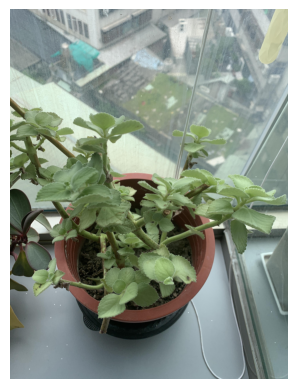

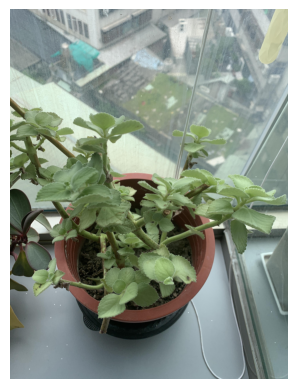

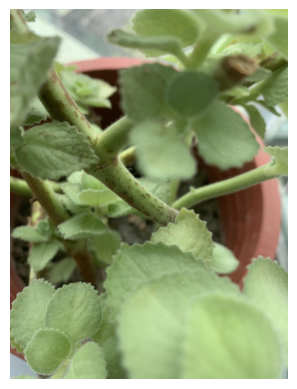

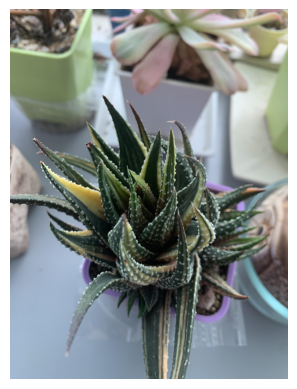

In [19]:
import os
from PIL import Image
import matplotlib.pyplot as plt

#check counts for everything
print("Mask DiR: " + str(count_images(mask_dir)))
print("Diverse Background: " + str(count_images(diverse_background_source)))

segmented_dir = mask_dir

print("Unlabeled Dir: " + str(count_images(unlabeled_dir)))
print("Segmented Dir: " + str(count_images(segmented_dir)))

image_files = [file for file in os.listdir(unlabeled_real_plant_dir) if file.endswith(('png', 'jpg', 'jpeg'))]
print(len(image_files))
for image_file in image_files:
    image_path = os.path.join(unlabeled_real_plant_dir, image_file)
    image = Image.open(image_path)
    # image = image.rotate(270, expand=True)
    plt.figure()  # Create a new figure for each image
    plt.imshow(image)
    plt.axis('off')  # Hide the axis
    plt.show()
    image.save(image_path)



In [20]:
#define functions for loading in images, datasets, doing processing 
img_height = 128
img_width = 128
import random

def normalize(input_image, input_mask):
  input_image = tf.cast(input_image, tf.float32) / 255.0
  input_mask -= 1
  return input_image, input_mask

def normalize_img(image, label):
  """Normalizes images: `uint8` -> `float32`."""
  return tf.cast(image, tf.float32) / 255., label


# def load_image(image, segmentation_mask):
#     input_image = tf.image.resize(image, (128, 128))

#     input_mask = tf.image.resize(segmentation_mask, (128, 128), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
#     input_image, input_mask = normalize(input_image, input_mask)

#     return input_image, input_mask
# def adjust_random_contrast(image):
#     contrast_factor = tf.random.uniform([], minval=0.1, maxval=1.2)
#     return tf.image.adjust_contrast(image, contrast_factor)

from tensorflow.keras.preprocessing.image import load_img, img_to_array

def random_background(mask, original_image):
    image = original_image.copy()
    non_zero_mask = np.broadcast_to(mask == 1, image.shape)
    
    height, width, _ = image.shape
    random_shades = np.zeros((height, width, 3), dtype=np.float32)
    
    # Randomly choose between red, green, or blue
    choice = np.random.choice([0, 1, 2])
    choice = 2
    # Apply the random shades to the non-zero mask pixels
    image[non_zero_mask[:, :, 0], 0] =  0 #np.random.uniform(0, 1) #if choice == 0 else 0
    image[non_zero_mask[:, :, 1], 1] = np.random.uniform(0, 1) #if choice == 1 else 0
    image[non_zero_mask[:, :, 2], 2] = 0 # np.random.uniform(0, 1) #if choice == 2 else 0
    return image
    
def adjust_random_hue(image):
    hue_delta = tf.random.uniform([], minval=-0.2, maxval=0.2)  # Adjust the range as needed
    return tf.image.adjust_hue(image, hue_delta)
    
def load_image(image_path, mask_path):
    image_path = image_path.numpy().decode('utf-8')
    mask_path = mask_path.numpy().decode('utf-8')
    
    image = load_img(image_path, target_size=(img_height, img_width))
    image = img_to_array(image) / 255.0
    
    mask = load_img(mask_path, target_size=(img_height, img_width), color_mode="grayscale")
    mask = img_to_array(mask) / 255.0
    return image, mask

def load_just_background_image(image_path, mask_path):
    image_path = image_path.numpy().decode('utf-8')
    
    image = load_img(image_path, target_size=(img_height, img_width))
    image = img_to_array(image) / 255.0
    
    height, width, _ = image.shape
    mask = np.zeros((height, width, 1), dtype=np.float32)
    mask = 1 - mask
    return image, mask


def load_image_with_random_background(image_path, mask_path):
    image_path = image_path.numpy().decode('utf-8')
    mask_path = mask_path.numpy().decode('utf-8')
    
    image = load_img(image_path, target_size=(img_height, img_width))
    image = img_to_array(image) / 255.0
    
    mask = load_img(mask_path, target_size=(img_height, img_width), color_mode="grayscale")
    mask = img_to_array(mask) / 255.0

    image = random_background(mask, image)

    return image, mask
    

def load_image_inverted_mask(image_path, mask_path):
    image_path = image_path.numpy().decode('utf-8')
    mask_path = mask_path.numpy().decode('utf-8')
    
    image = load_img(image_path, target_size=(img_height, img_width))
    image = img_to_array(image) / 255.0
    
    mask = load_img(mask_path, target_size=(img_height, img_width), color_mode="grayscale")
    mask = img_to_array(mask) / 255.0
    mask = 1 - mask
    return image, mask

def load_dataset_just_background(image_folder, mask_folder):
    image_paths = sorted([os.path.join(image_folder, fname) for fname in os.listdir(image_folder)])
    mask_paths = sorted([os.path.join(mask_folder, fname) for fname in os.listdir(mask_folder)])

    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    
    def process_path(image_path, mask_path):
        image, mask = tf.py_function(load_just_background_image, [image_path, mask_path], [tf.float32, tf.float32])
        image.set_shape([img_height, img_width, 3])
        image = tf.image.random_brightness(image, 0.2)
        image = tf.image.random_contrast(image, 0.8, 1.2)
        image = tf.image.random_saturation(image, 0.75, 1.25)
        image = tf.image.random_hue(image, 0.15)
        mask.set_shape([img_height, img_width, 1])
        return image, mask
    
    dataset = dataset.map(process_path, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

def load_dataset_random_background(image_folder, mask_folder):
    image_paths = sorted([os.path.join(image_folder, fname) for fname in os.listdir(image_folder)])
    mask_paths = sorted([os.path.join(mask_folder, fname) for fname in os.listdir(mask_folder)])
    
    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    
    def process_path(image_path, mask_path):
        image, mask = tf.py_function(load_image_with_random_background, [image_path, mask_path], [tf.float32, tf.float32])
        image.set_shape([img_height, img_width, 3])
        image = tf.image.random_brightness(image, 0.2)
        image = tf.image.random_contrast(image, 0.8, 1.2)
        image = tf.image.random_saturation(image, 0.75, 1.25)
        image = tf.image.random_hue(image, 0.15)
        mask.set_shape([img_height, img_width, 1])
        return image, mask
    
    dataset = dataset.map(process_path, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

def load_dataset(image_folder, mask_folder):
    image_paths = sorted([os.path.join(image_folder, fname) for fname in os.listdir(image_folder)])
    mask_paths = sorted([os.path.join(mask_folder, fname) for fname in os.listdir(mask_folder)])
    
    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    
    def process_path(image_path, mask_path):

        image, mask = tf.py_function(load_image, [image_path, mask_path], [tf.float32, tf.float32])
        image.set_shape([img_height, img_width, 3])
        mask.set_shape([img_height, img_width, 1])
        image = tf.image.random_brightness(image, 0.2)
        image = tf.image.random_contrast(image, 0.8, 1.2)
        image = tf.image.random_saturation(image, 0.75, 1.05)
        image = tf.image.random_hue(image, 0.15)
        return image, mask
    
    dataset = dataset.map(process_path, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

def load_dataset_mask_inverted(image_folder, mask_folder):
    image_paths = sorted([os.path.join(image_folder, fname) for fname in os.listdir(image_folder)])
    mask_paths = sorted([os.path.join(mask_folder, fname) for fname in os.listdir(mask_folder)])
    
    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    
    def process_path(image_path, mask_path):
        image, mask = tf.py_function(load_image_inverted_mask, [image_path, mask_path], [tf.float32, tf.float32])
        image.set_shape([img_height, img_width, 3])
        image = tf.image.random_brightness(image, 0.2)
        image = tf.image.random_contrast(image, 0.8, 1.2)
        image = tf.image.random_saturation(image, 0.75, 1.05)
        image = tf.image.random_hue(image, 0.15)
        mask.set_shape([img_height, img_width, 1])
        return image, mask
    
    dataset = dataset.map(process_path, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

#makes sure there aren't folders inside a folder path 
def remove_directories(folder_path):
    """
    Remove all directories inside the given folder.

    Args:
    folder_path (str): Path to the folder where subdirectories need to be removed.
    """
    if not os.path.exists(folder_path):
        print(f"The folder {folder_path} does not exist.")
        return

    for item in os.listdir(folder_path):
        item_path = os.path.join(folder_path, item)
        if os.path.isdir(item_path):
            shutil.rmtree(item_path)
            print(f"Removed directory: {item_path}")
        else:
            print(f"Skipping file: {item_path}")


In [21]:

#augmentations for the datasets

class Augment(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    # both use the same seed, so they'll make the same random changes.
    self.augment_inputs = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)
    self.augment_labels = tf.keras.layers.RandomFlip(mode="horizontal", seed=seed)


  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

        
class MoreAugment(tf.keras.layers.Layer):
    def __init__(self, seed=42):
        super().__init__()
        # both use the same seed, so they'll make the same random changes.
        self.augment_inputs = tf.keras.Sequential([
            tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
            tf.keras.layers.RandomRotation(0.8, seed=seed),
            tf.keras.layers.RandomTranslation(height_factor=0.3, width_factor=0.3, seed=seed),
            tf.keras.layers.RandomContrast(factor=0.8, seed=seed),
            # ToBlackAndWhite()
        ])
        
        # Define augmentations for labels
        self.augment_labels = tf.keras.Sequential([
            tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
            tf.keras.layers.RandomRotation(0.8, seed=seed),
            tf.keras.layers.RandomTranslation(height_factor=0.3, width_factor=0.3, seed=seed),
            # ToBlackAndWhite()
        ])

    def call(self, inputs, labels):
        inputs = self.augment_inputs(inputs)
        labels = self.augment_labels(labels)
        return inputs, labels
        
class LessAugment(tf.keras.layers.Layer):
    def __init__(self, seed=42):
        super().__init__()
        # both use the same seed, so they'll make the same random changes.
        self.augment_inputs = tf.keras.Sequential([
            tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
            tf.keras.layers.RandomRotation(0.8, seed=seed),
            tf.keras.layers.RandomTranslation(height_factor=0.3, width_factor=0.3, seed=seed),
            tf.keras.layers.RandomContrast(factor=0.8, seed=seed),
            # ToBlackAndWhite()
        ])
        
        # Define augmentations for labels
        self.augment_labels = tf.keras.Sequential([
            tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
            tf.keras.layers.RandomRotation(0.8, seed=seed),
            tf.keras.layers.RandomTranslation(height_factor=0.3, width_factor=0.3, seed=seed),
            tf.keras.layers.RandomContrast(factor=0.8, seed=seed)
            # ToBlackAndWhite()
        ])
    
    def call(self, inputs, labels):
        inputs = self.augment_inputs(inputs)
        labels = self.augment_labels(labels)
        return inputs, labels     


In [ ]:
#load all of the datasets in 
dataset = load_dataset(unlabeled_dir, segmented_dir)
random_background_dataset = load_dataset_random_background(unlabeled_dir, segmented_dir)

total_train_size = len(dataset)
train_size = int(len(dataset) * 0.8)
BATCH_SIZE = 64
batch_size = 64

BATCH_SIZE = 64
BUFFER_SIZE = 1000

fine_tune_train_size = total_train_size - train_size


#dataset used for training segmentation model 
train_dataset = dataset.take(train_size)  # 取前 train_size 条作为训练集
# train_dataset = train_dataset.map(normalize_img)
train_batches = (
    train_dataset  
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(Augment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))


random_background_dataset = random_background_dataset.take(10000)
random_batches = (
    random_background_dataset  
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(Augment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))

num_repeats = 300

# Function to repeat the dataset multiple times
def repeat_dataset(dataset, num_repeats):
    return tf.data.Dataset.range(num_repeats).flat_map(lambda _: dataset)
total_office_bbox_dataset = load_dataset_mask_inverted(office_bbox_original_dir, office_bbox_mask_dir)
office_bbox_dataset = repeat_dataset(total_office_bbox_dataset.take(int(0.8 * len(total_office_bbox_dataset))), 100)
                                     
office_bbox_dataset_val = total_office_bbox_dataset.skip(int(0.8 * len(total_office_bbox_dataset)))
office_bbox_dataset_val = total_office_bbox_dataset.take(len(total_office_bbox_dataset) - int(0.8 * len(total_office_bbox_dataset)))

office_bbox_batches = office_bbox_dataset.batch(batch_size)
office_bbox_batches = (
    office_bbox_dataset
    # repeat_dataset(office_dataset, 500)
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(Augment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))

office_bbox_val_batches = (
    office_bbox_dataset_val
    # repeat_dataset(office_dataset, 500)
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(Augment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))

office_dataset = repeat_dataset(load_dataset_mask_inverted(office_original_dir, office_mask_dir), 500)
office_batches = office_dataset.batch(batch_size)
office_batches = (
    office_dataset
    # repeat_dataset(office_dataset, 500)
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(Augment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))



just_background_dataset = load_dataset_just_background(just_background_source, just_background_source)
just_background_batches = (
    # just_background_dataset
    repeat_dataset(just_background_dataset, num_repeats)
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(MoreAugment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))

# combined_batches = train_with_random_dataset  
#         .cache()
#         .shuffle(BUFFER_SIZE)
#         .batch(batch_size)
#         .repeat()
#         .map(Augment())
#         .prefetch(buffer_size=tf.data.AUTOTUNE))

finetuning_dataset = (train_dataset.take(20000)).concatenate(random_background_dataset)
finetuning_dataset = finetuning_dataset.concatenate(office_bbox_batches.unbatch().take(6000))

finetune_train_batches = (
    finetuning_dataset 
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        .map(Augment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))
# print(len(finetuning_dataset))

TRAIN_LENGTH = tf.data.experimental.cardinality(train_dataset).numpy()
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

# print("IMAGE SHAPE")
# for images, labels in train_dataset.unbatch().take(4):
#     for image in images:
#         print(image.shape)

#training dataset but with more augmentations 
aug_train_batches = (
    train_dataset  
        .cache()
        .shuffle(BUFFER_SIZE)
        .batch(batch_size)
        .repeat()
        # .map(Augment())
        .map(MoreAugment())
        .prefetch(buffer_size=tf.data.AUTOTUNE))


#generic test_dataset from taking 20% of the entire dataset
test_dataset = dataset.skip(train_size) 
test_dataset = dataset.take(len(dataset) - train_size)
# test_dataset = test_dataset.map(normalize_img)
test_batches = test_dataset.batch(batch_size)

#mostly from plant doc with background 
diverse_background_dataset = load_dataset(diverse_background_source, diverse_background_source)
diverse_background_ds = diverse_background_dataset.take(len(diverse_background_dataset))
# diverse_background_ds = diverse_background_ds.map(normalize_img)
diverse_background_batches = diverse_background_ds.batch(32)

#taiwan tomato dataset without removed background 
tomato_background_dataset = load_dataset(tomato_train_background_source, tomato_train_background_source)
tomato_background_ds = tomato_background_dataset.take(len(tomato_background_dataset))
# tomato_background_ds = tomato_background_ds.map(normalize_img)
tomato_background_batches = tomato_background_ds.batch(32)

#real plant dataset
remove_folders(unlabeled_real_plant_dir)
remove_folders(masked_real_plant_dir)

real_background_dataset = load_dataset_mask_inverted(unlabeled_real_plant_dir, masked_real_plant_dir)
real_background_ds = real_background_dataset.take(len(real_background_dataset))
# real_background_ds = real_background_ds.map(normalize_img)
real_background_batches = real_background_ds.batch(4)


print(len(finetuning_dataset))
print(len(total_office_bbox_dataset))




In [23]:
#displays the input image, with the predicted mask 
def display(display_list):
  plt.figure(figsize=(15, 15))

  title = ['Input Image', 'True Mask', 'Predicted Mask']

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    if(i < len(title)):
        plt.title(title[i])
    plt.imshow(tf.keras.utils.array_to_img(display_list[i]))
    plt.axis('off')
  plt.show()

In [24]:
def no_background_image(mask, image, original_image): #image should be of shape 160, 160, 3
    # print("APPLY THE MASK")
    original_image = np.array(original_image)    
    # Boolean mask to identify non-zero values in the mask
    non_zero_mask = np.broadcast_to(mask == 1, image.shape)

    
    # Assign corresponding colors from original image to new image where mask is non-zero

    original_image[non_zero_mask] = 0.0 #random.uniform(0.0, 200.0) #random number between black to gray  0.0 # original_image[non_zero_mask]
    # print("Original Image IS: ")
    # print(original_image)
    return original_image

In [25]:
#creates the mask for the image from model2.predict()
def create_mask(pred_mask):
  pred_mask = tf.math.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

RUNNING
tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


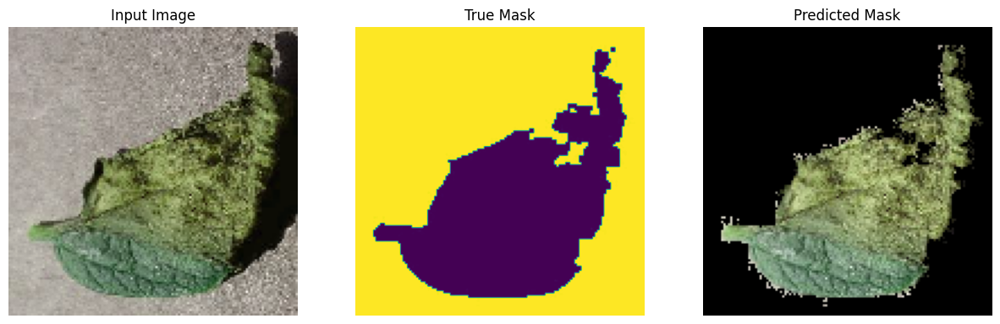

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


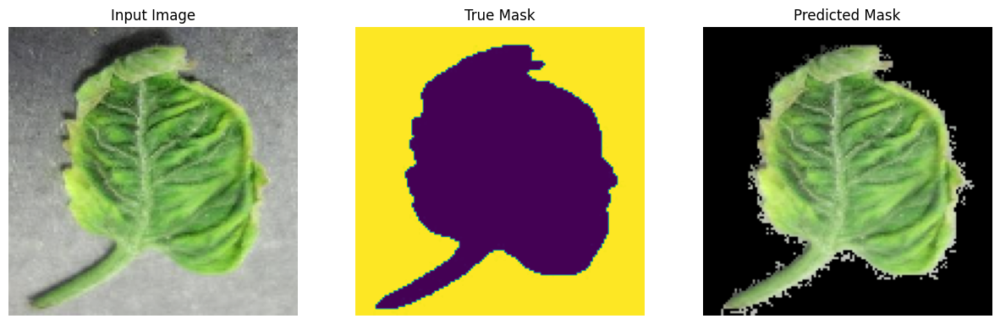

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


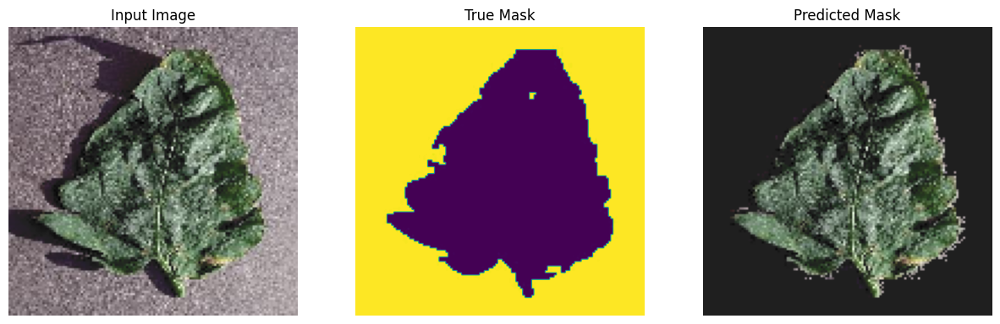

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


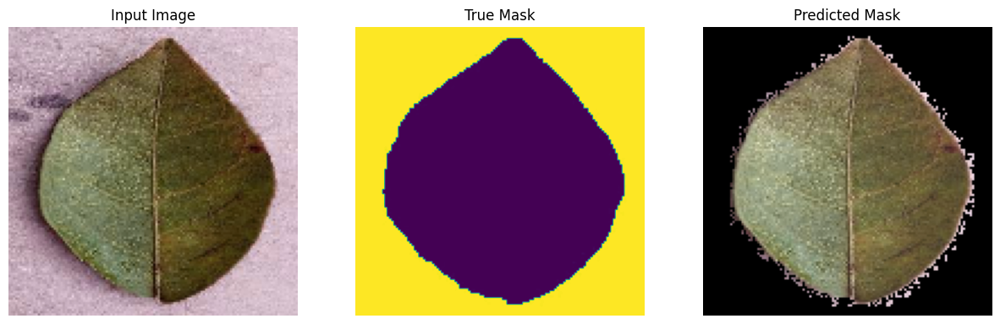

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


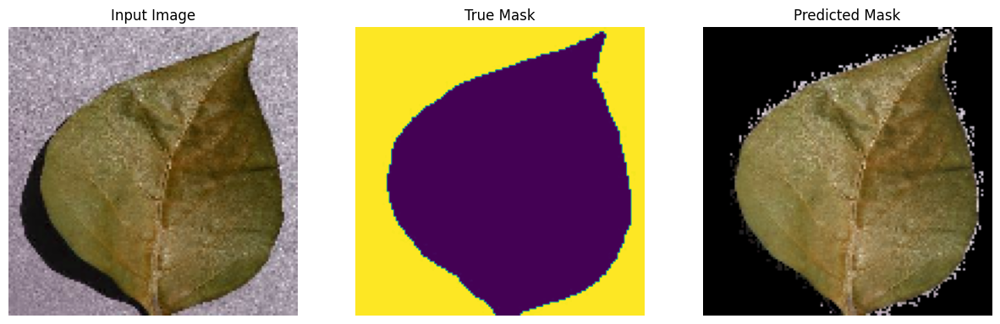

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [0.]
  [0.]
  [0.]]

 [[1.]
  [1.]
  [1.]
  ...
  [0.]
  [0.]
  [0.]]

 [[1.]
  [1.]
  [1.]
  ...
  [0.]
  [0.]
  [0.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


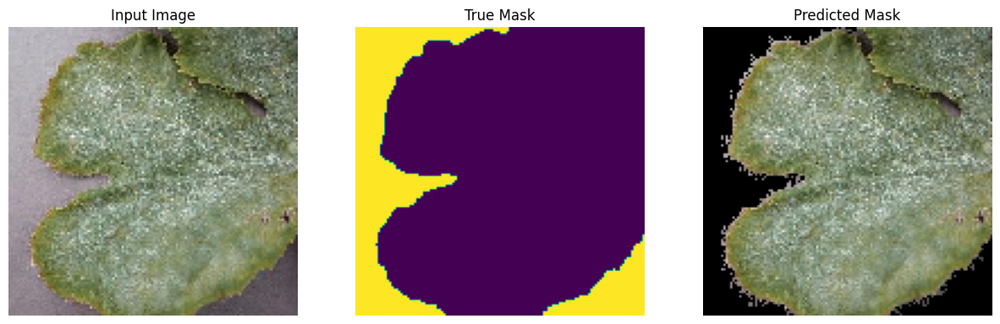

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


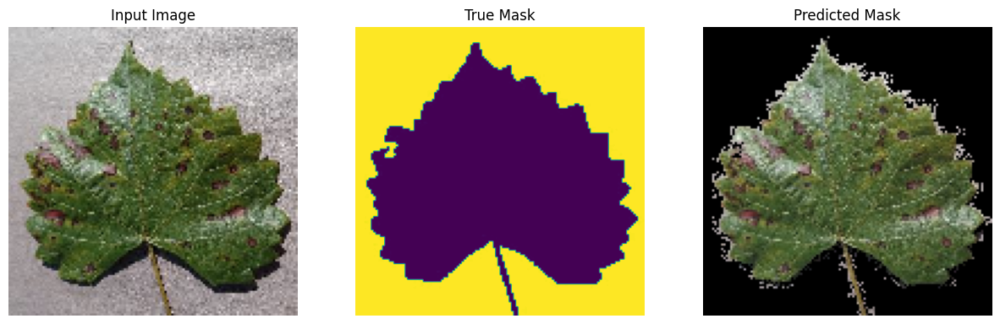

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


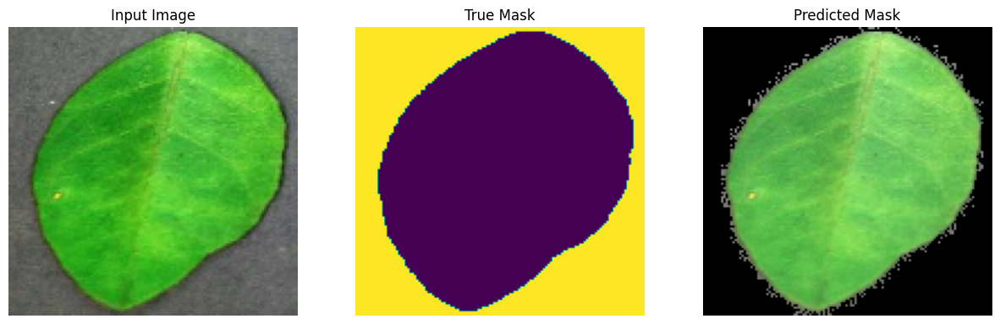

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


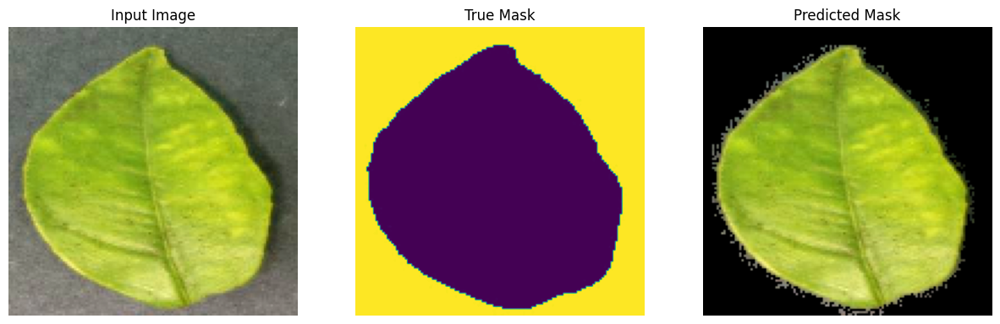

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


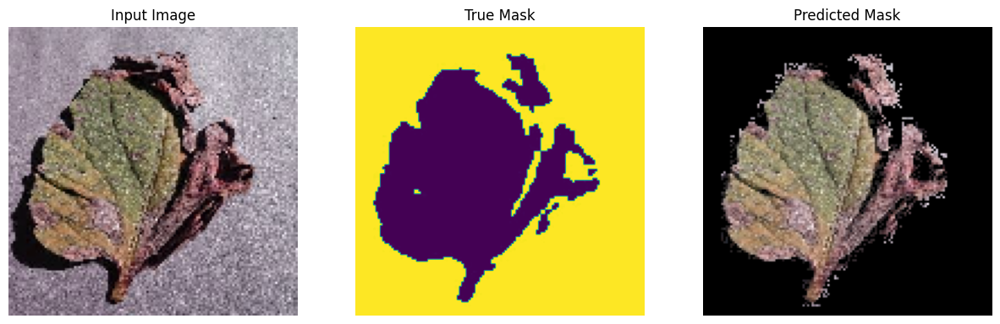

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


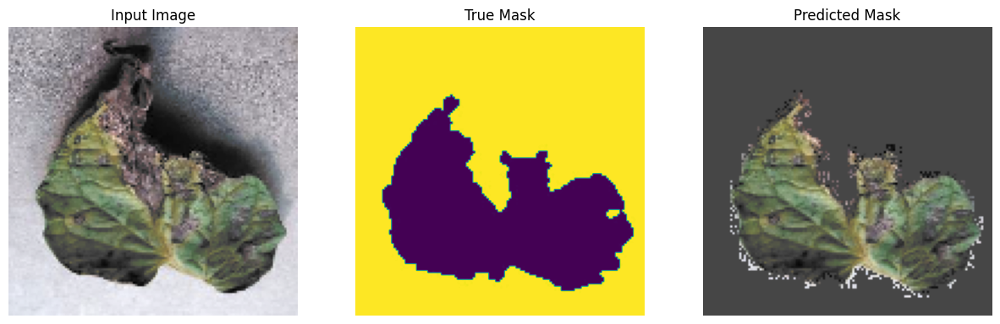

tf.Tensor(
[[[0.]
  [0.]
  [0.]
  ...
  [1.]
  [1.]
  [1.]]

 [[0.]
  [0.]
  [0.]
  ...
  [1.]
  [1.]
  [1.]]

 [[0.]
  [0.]
  [0.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]

 [[0.]
  [0.]
  [0.]
  ...
  [0.]
  [0.]
  [0.]]], shape=(128, 128, 1), dtype=float32)


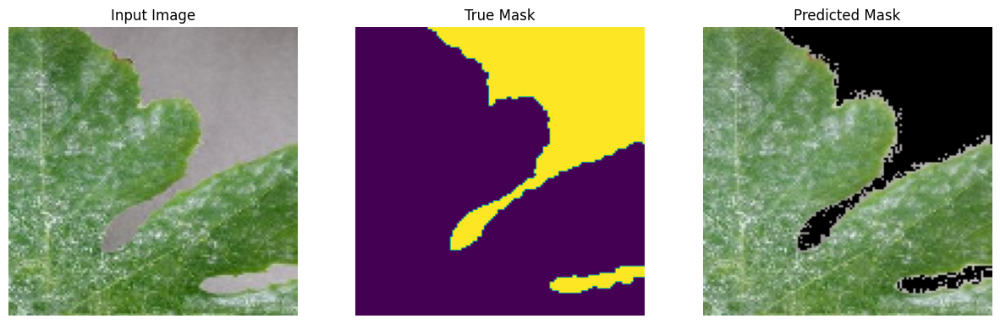

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


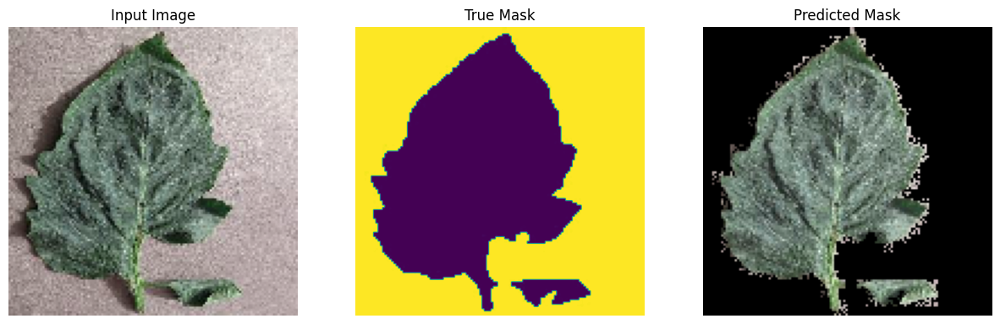

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


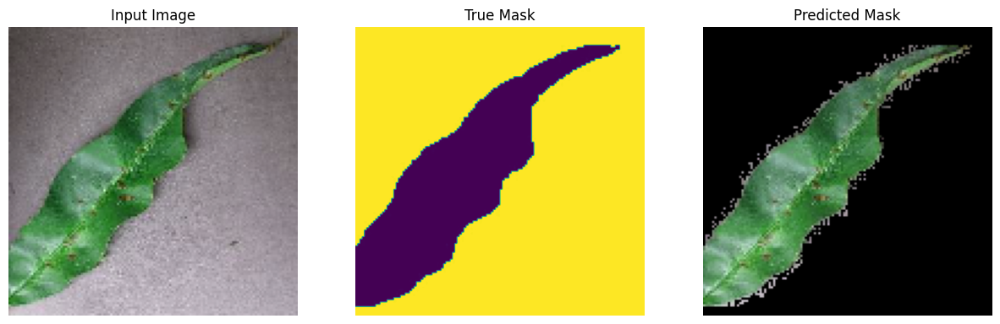

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


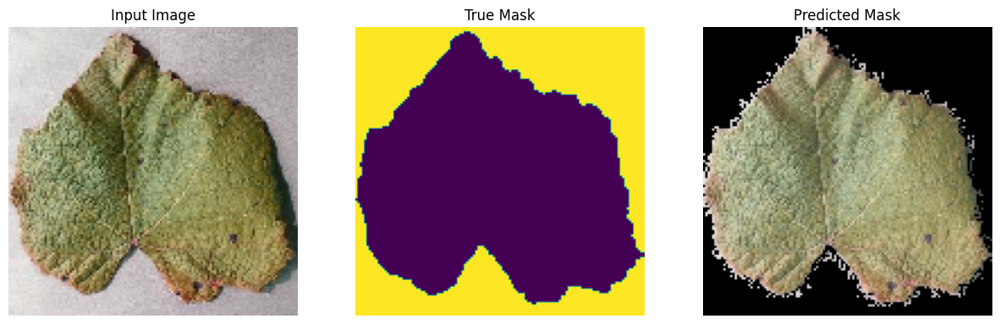

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


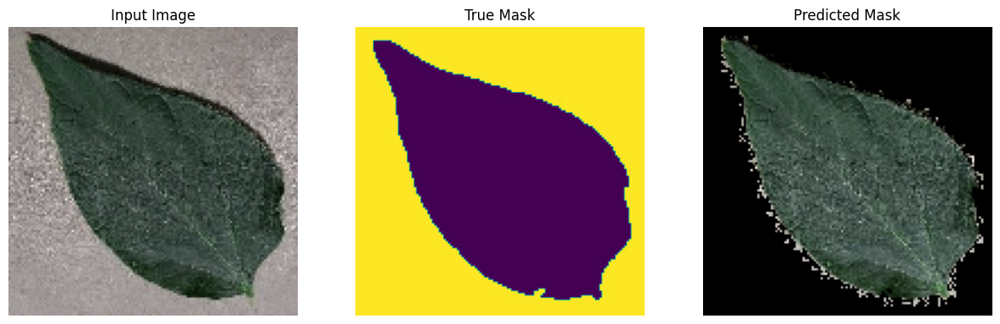

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


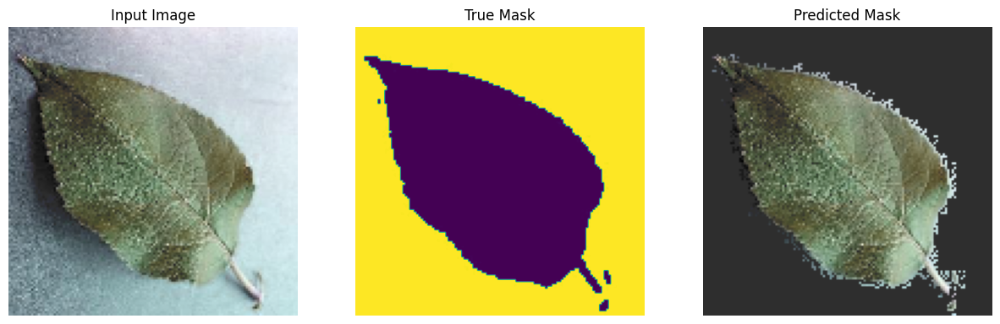

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


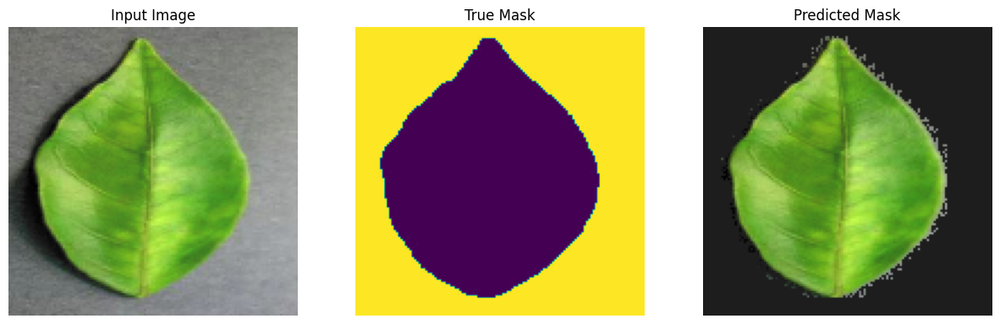

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


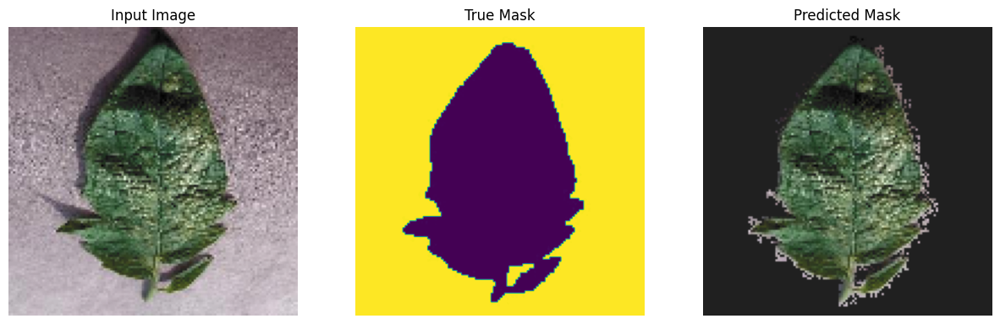

tf.Tensor(
[[[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 ...

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]
  ...
  [1.]
  [1.]
  [1.]]], shape=(128, 128, 1), dtype=float32)


2024-08-12 08:21:35.548650: W tensorflow/core/kernels/data/cache_dataset_ops.cc:854] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


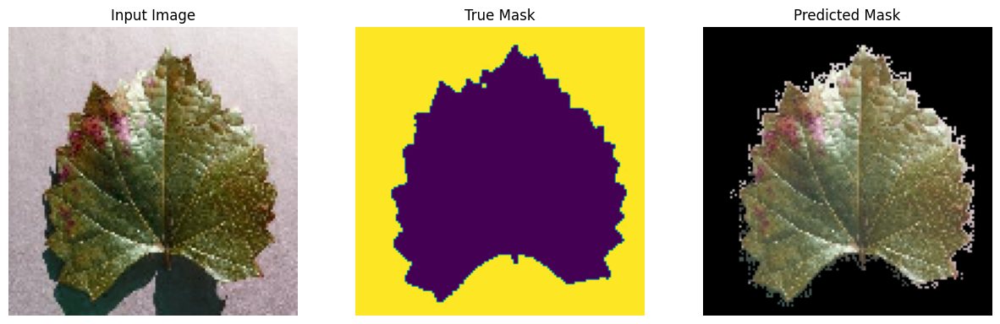

In [26]:

i = 0
print("RUNNING")

image_folder = office_bbox_original_dir
mask_folder = office_bbox_mask_dir
for images, masks in train_batches.unbatch().take(20):
      sample_image, sample_mask = images, masks
      print(sample_mask)
      display([sample_image, sample_mask, no_background_image(sample_mask, sample_image, sample_image)])

# image_paths = sorted([os.path.join(image_folder, fname) for fname in os.listdir(image_folder)])
# mask_paths = sorted([os.path.join(mask_folder, fname) for fname in os.listdir(mask_folder)])

# dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
# for image, mask in zip(image_paths, mask_paths):
#     print(image)
#     sample_image = cv2.imread(image)
#     sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
#     sample_mask = cv2.imread(mask)
#     display([sample_image, sample_mask, no_background_image(sample_mask, sample_image, sample_image)])


In [27]:
#ML Model 
base_model = tf.keras.applications.MobileNetV2(input_shape=[128, 128, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)

down_stack.trainable = False

up_stack = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
]

def upsample(x, size):
    return tf.image.resize(x, size, method='bilinear')

# def unet_model(output_channels:int):
#   inputs = tf.keras.layers.Input(shape=[128, 128, 3])

#   # Downsampling through the model
#   skips = down_stack(inputs)
#   x = skips[-1]
#   skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  # for up, skip in zip(up_stack, skips):
  #   x = up(x)
  #   concat = tf.keras.layers.Concatenate()
  #   x = concat([x, skip])

  # # This is the last layer of the model
  # last = tf.keras.layers.Conv2DTranspose(
  #     filters=output_channels, kernel_size=3, strides=2,
  #     padding='same')  #64x64 -> 128x128
  # actual_last = tf.keras.layers.Conv2D(
  #       filters=1, kernel_size=1, activation='sigmoid'
  #   )  # Final layer to get (128, 128, 1)
  # x = last(x)
  #x = actual_last(x)
    
  
  # final = tf.image.resize(x, size=[x.shape[1] * 2, x.shape[2] * 2], method=tf.image.ResizeMethod.BILINEAR)
  # final = tf.keras.layers.Conv2D(
  #   filters=1, kernel_size=1, activation='sigmoid'
  # )(final)
     

  # return tf.keras.Model(inputs=inputs, outputs=x)
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomFlip('horizontal'),
  tf.keras.layers.RandomRotation(0.2),
])
def unet_model(output_channels: int):
    inputs = tf.keras.layers.Input(shape=[128, 128, 3])
    inputs = data_augmentation(inputs)
    # 通過模型下采樣
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # 上采样并建立跳跃连接
    for skip in skips:
        x = upsample(x, size=(x.shape[1] * 2, x.shape[2] * 2))  # 使用双线性插值进行上采样
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

    # 最后一层
    x = tf.keras.layers.Conv2D(filters=output_channels, kernel_size=3, padding='same')(x)
    x = tf.keras.layers.Activation('softmax' if output_channels > 1 else 'sigmoid')(x)
    final = tf.image.resize(x, size=[x.shape[1] * 2, x.shape[2] * 2], method=tf.image.ResizeMethod.BILINEAR)

    return tf.keras.Model(inputs=inputs, outputs=final)

OUTPUT_CLASSES = 2
base_learning_rate = 0.008
model2 = unet_model(output_channels=OUTPUT_CLASSES)
# model2.compile(optimizer='adam',
#               loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
#               metrics=['accuracy'])

model2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),#tf.keras.losses.BinaryCrossentropy(),
              metrics=['accuracy'])


print(model2.summary())

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 model (Functional)          [(None, 64, 64, 96),         1841984   ['input_3[0][0]']             
                              (None, 32, 32, 144),                                                
                              (None, 16, 16, 192),                                                
                              (None, 8, 8, 576),                                                  
                              (None, 4, 4, 320)]                                                  
                                                                                            

In [28]:
def show_predictions(dataset=None, num=1): #if it doesnt work switch dataset back to none 
  if dataset:
    print("HAS DATASET")
    for image, mask in dataset.take(num):
      image = image[0]
      print(image)
      pred_mask = model2.predict(image[tf.newaxis, ...])
    
      background_removed_image = no_background_image(create_mask(pred_mask), image, image)
        
      display([image, mask[0], create_mask(pred_mask)])
  else:
    prediction = model2.predict(sample_image[tf.newaxis, ...])
    display([sample_image, sample_mask, create_mask(prediction)])

HAS DATASET
tf.Tensor(
[[[0.9778671  0.9471635  0.98388666]
  [0.9661048  0.9354012  0.97212434]
  [0.9700256  0.939322   0.97604513]
  ...
  [0.9917282  0.97336817 0.9886164 ]
  [0.9995698  0.98120975 0.99645805]
  [0.96820354 0.9498435  0.9650918 ]]

 [[0.95042175 0.91971815 0.9564412 ]
  [0.95042175 0.91971815 0.9564412 ]
  [0.9778671  0.9471635  0.98388666]
  ...
  [0.96820354 0.9498435  0.9650918 ]
  [0.98388666 0.96552664 0.98077494]
  [0.97996587 0.96160585 0.9768542 ]]

 [[0.95042175 0.91971815 0.9564412 ]
  [0.93865937 0.90795577 0.9446789 ]
  [0.94258016 0.91187656 0.9485997 ]
  ...
  [0.960362   0.942002   0.9572503 ]
  [0.96428275 0.94592273 0.96117103]
  [1.011332   0.992972   1.0082203 ]]

 ...

 [[0.7721673  0.7507448  0.76496583]
  [0.846662   0.82523954 0.83946055]
  [0.811375   0.7899526  0.8041736 ]
  ...
  [0.79569197 0.76202744 0.76907367]
  [0.8662659  0.83260137 0.8396476 ]
  [0.72119725 0.68753266 0.6945789 ]]

 [[0.7368803  0.71545786 0.7296789 ]
  [0.79569197 

2024-08-12 08:21:43.303494: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8600


1/1 [==============================] - 1s 1s/step


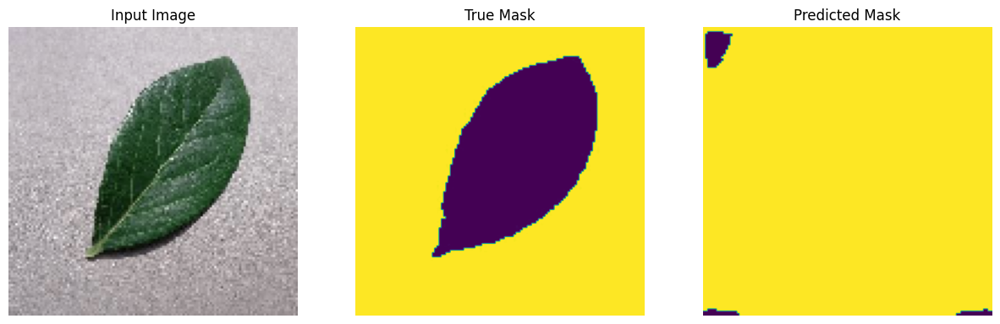

tf.Tensor(
[[[0.8308847  0.8014415  0.85641503]
  [0.6838392  0.6543961  0.70936966]
  [0.77033657 0.7408933  0.79586697]
  ...
  [0.63311803 0.60664284 0.666121  ]
  [0.58554465 0.5590694  0.61854756]
  [0.793138   0.76666284 0.826141  ]]

 [[0.722763   0.69331986 0.74829346]
  [0.71843815 0.688995   0.7439686 ]
  [0.71411324 0.68467015 0.7396437 ]
  ...
  [0.56392026 0.5374451  0.59692323]
  [0.71961534 0.69314015 0.7526183 ]
  [0.74988943 0.72341424 0.78289235]]

 [[0.65356517 0.6241221  0.6790956 ]
  [0.55841815 0.528975   0.5839486 ]
  [0.65356517 0.6241221  0.6790956 ]
  ...
  [0.4903977  0.4639224  0.5234006 ]
  [0.9315336  0.90505844 0.96453655]
  [0.6979911  0.6715158  0.730994  ]]

 ...

 [[0.9425396  0.9317935  0.97157156]
  [0.90361583 0.8928698  0.9326478 ]
  [0.87334174 0.86259574 0.9023738 ]
  ...
  [0.81908715 0.79261196 0.8520901 ]
  [0.793138   0.76666284 0.826141  ]
  [0.7715137  0.74503845 0.8045167 ]]

 [[0.9468645  0.9361184  0.9758965 ]
  [0.959839   0.9490929  0

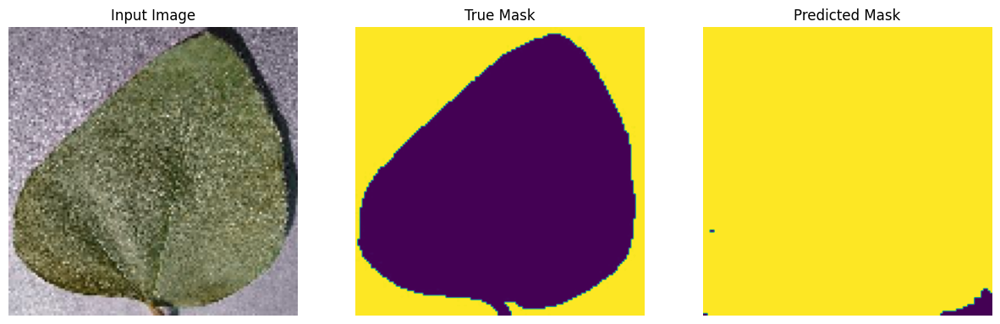

tf.Tensor(
[[[0.56570673 0.52130145 0.51060027]
  [0.56570673 0.52376586 0.5139929 ]
  [0.5967774  0.5548364  0.54506344]
  ...
  [0.47939965 0.422352   0.42090052]
  [0.4448768  0.3878292  0.3863777 ]
  [0.43451995 0.37747237 0.37602085]]

 [[0.61403877 0.57209796 0.56232494]
  [0.5795159  0.5375751  0.5278021 ]
  [0.56570673 0.52376586 0.5139929 ]
  ...
  [0.3758311  0.31878352 0.317332  ]
  [0.4379722  0.3809246  0.3794731 ]
  [0.44142452 0.38437685 0.3829254 ]]

 [[0.54499304 0.5030522  0.4932792 ]
  [0.5691591  0.5272182  0.5174452 ]
  [0.5588022  0.5143969  0.5036957 ]
  ...
  [0.47249508 0.4154475  0.41399598]
  [0.4448768  0.3878292  0.3863777 ]
  [0.4207108  0.36366323 0.3622117 ]]

 ...

 [[0.7486779  0.70374924 0.7094032 ]
  [0.72796416 0.68303555 0.68868953]
  [0.7314164  0.68648785 0.6921418 ]
  ...
  [0.3965448  0.3244752  0.32948878]
  [0.37928337 0.3222358  0.32078427]
  [0.33785596 0.30927134 0.29051763]]

 [[0.72451186 0.67958325 0.68523705]
  [0.71760726 0.6726787  0

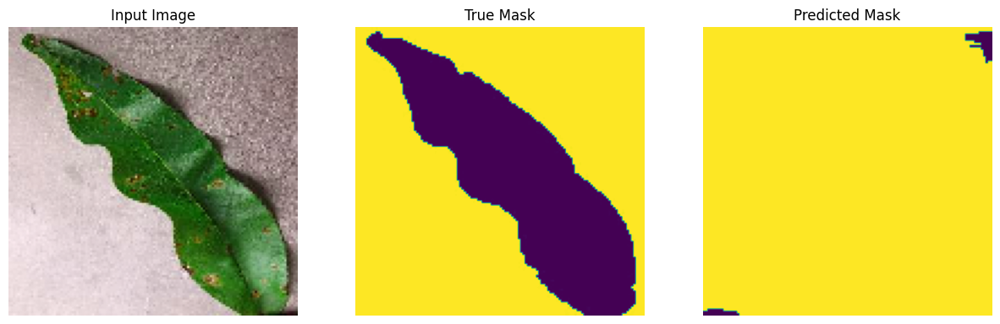

tf.Tensor(
[[[0.76605    0.7265558  0.78968537]
  [0.814969   0.7754748  0.8386044 ]
  [0.814969   0.7754748  0.8386044 ]
  ...
  [0.9268296  0.894893   0.9445956 ]
  [0.98390174 0.9519652  1.0016677 ]
  [0.99613154 0.9641949  1.0138975 ]]

 [[0.7252841  0.68578994 0.7489195 ]
  [0.79050946 0.7510153  0.81414485]
  [0.7375139  0.6980197  0.7611493 ]
  ...
  [0.9798252  0.9478886  0.99759114]
  [0.96351886 0.9315822  0.98128486]
  [1.0246675  0.99273103 1.0424335 ]]

 [[0.7334373  0.69394314 0.7570727 ]
  [0.7701266  0.73063236 0.79376197]
  [0.81904554 0.7795514  0.84268093]
  ...
  [1.0042846  0.9723481  1.0220506 ]
  [1.0042846  0.9723481  1.0220506 ]
  [0.99205494 0.96011835 1.0098209 ]]

 ...

 [[0.61892617 0.5769193  0.6266219 ]
  [0.68415153 0.6421447  0.6918473 ]
  [0.68007493 0.6380681  0.6877707 ]
  ...
  [0.88942045 0.85412717 0.9038297 ]
  [0.85680777 0.8215145  0.871217  ]
  [0.86903757 0.8337442  0.8834468 ]]

 [[0.68007493 0.6380681  0.6877707 ]
  [0.61077297 0.5687661  0

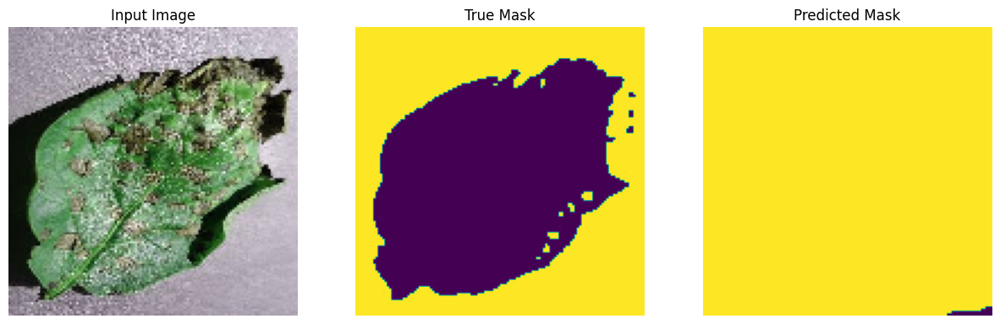

tf.Tensor(
[[[0.6627286  0.6691338  0.6611977 ]
  [0.6756668  0.682072   0.6741359 ]
  [0.6530249  0.6594301  0.651494  ]
  ...
  [0.45870435 0.51710963 0.38146868]
  [0.46740484 0.5268133  0.38180876]
  [0.46487626 0.52357876 0.375453  ]]

 [[0.6627286  0.6691338  0.6611977 ]
  [0.6724322  0.6788374  0.67090136]
  [0.64655584 0.652961   0.64502496]
  ...
  [0.5104572  0.56886256 0.43322155]
  [0.4325308  0.49123323 0.34310746]
  [0.3969507  0.45565313 0.30752736]]

 [[0.6045066  0.6109118  0.6029757 ]
  [0.6271485  0.6335537  0.6256176 ]
  [0.62391394 0.6303191  0.62238306]
  ...
  [0.4900467  0.5494552  0.40445063]
  [0.40665433 0.46535677 0.317231  ]
  [0.47922653 0.53651696 0.3821488 ]]

 ...

 [[0.74676305 0.7450098  0.4831529 ]
  [0.6965108  0.7079484  0.44745943]
  [0.64309335 0.6691338  0.4180084 ]
  ...
  [0.4864859  0.55915886 0.34860912]
  [0.51559687 0.5882698  0.37772012]
  [0.6514482  0.7241212  0.5135714 ]]

 [[0.7176521  0.71036243 0.4571631 ]
  [0.67293626 0.6788374  0

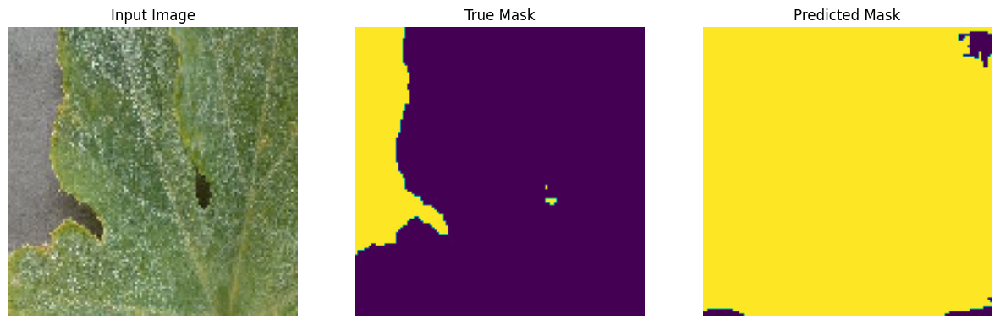

tf.Tensor(
[[[0.5879222  0.53388923 0.58270645]
  [0.6559439  0.6019109  0.6507281 ]
  [0.6839528  0.6299198  0.67873704]
  ...
  [0.80192786 0.75808364 0.8125936 ]
  [0.789924   0.74607986 0.8005898 ]
  [0.7259037  0.68205947 0.7365694 ]]

 [[0.6119299  0.55789685 0.6067141 ]
  [0.63193625 0.5779033  0.6267205 ]
  [0.6919554  0.6379224  0.6867396 ]
  ...
  [0.6938935  0.65004927 0.7045592 ]
  [0.7579139  0.71406966 0.7685796 ]
  [0.77391905 0.73007476 0.7845847 ]]

 [[0.5879222  0.53388923 0.58270645]
  [0.555912   0.50187904 0.55069625]
  [0.6519426  0.5979096  0.64672685]
  ...
  [0.7819215  0.7380773  0.7925872 ]
  [0.6298731  0.5860289  0.6405388 ]
  [0.74190885 0.69806457 0.7525745 ]]

 ...

 [[0.60809803 0.55730087 0.6245337 ]
  [0.6241032  0.57330596 0.6405388 ]
  [0.60809803 0.55730087 0.6245337 ]
  ...
  [0.7231202  0.69170314 0.7525745 ]
  [0.7271215  0.6957044  0.75657576]
  [0.75112903 0.719712   0.7805834 ]]

 [[0.6040968  0.5532996  0.6205324 ]
  [0.63210565 0.58130854 0

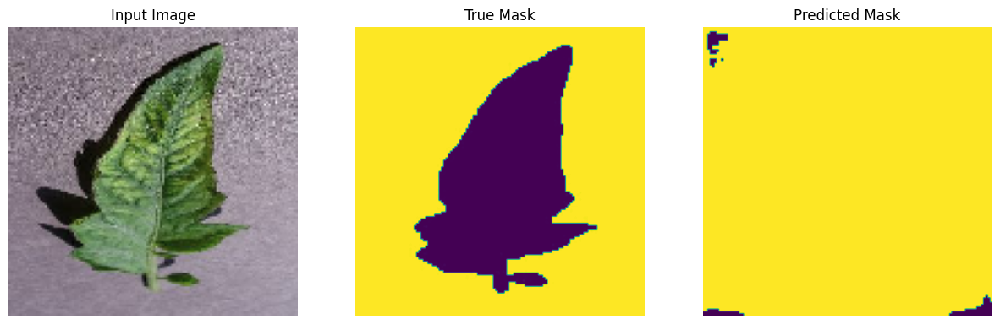

tf.Tensor(
[[[0.58491087 0.75601315 0.6292034 ]
  [0.59814465 0.7692468  0.64243716]
  [0.5540322  0.7251345  0.5983247 ]
  ...
  [0.48454916 0.6854334  0.5310997 ]
  [0.46787304 0.6501435  0.5162697 ]
  [0.40336177 0.5707413  0.45249084]]

 [[0.59814465 0.7692468  0.64243716]
  [0.62461203 0.79571426 0.6689045 ]
  [0.66803586 0.83541536 0.71344215]
  ...
  [0.48454916 0.6854334  0.5310997 ]
  [0.43699437 0.61926484 0.48539102]
  [0.3694489  0.54427385 0.4200731 ]]

 [[0.6768583  0.8442378  0.7222646 ]
  [0.5930449  0.7604244  0.63845116]
  [0.59097946 0.74719065 0.6360044 ]
  ...
  [0.48896042 0.6898446  0.5355109 ]
  [0.54424095 0.73395693 0.59041005]
  [0.43258312 0.6148536  0.48097983]]

 ...

 [[0.6716307  0.78689176 0.74007535]
  [0.6739764  0.7780693  0.7345942 ]
  [0.6990669  0.79571426 0.7581895 ]
  ...
  [0.4079254  0.50457275 0.46332526]
  [0.34616813 0.44281545 0.40156797]
  [0.13001765 0.22666502 0.18541756]]

 [[0.6655622  0.79571426 0.7295518 ]
  [0.66349673 0.78248054 0

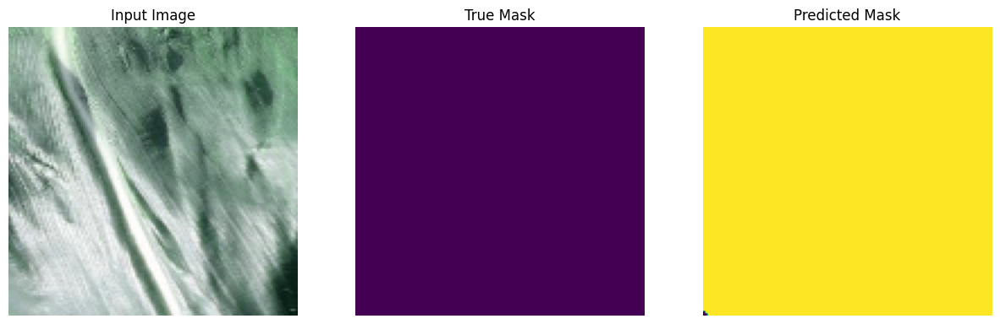

tf.Tensor(
[[[0.3455414  0.32818326 0.34946424]
  [0.3659327  0.33210742 0.37270185]
  [0.37448096 0.32226986 0.37734938]
  ...
  [0.44241473 0.39699194 0.44144583]
  [0.40988207 0.36445925 0.40891317]
  [0.33552164 0.29009882 0.33455274]]

 [[0.35018888 0.3328308  0.35411173]
  [0.3566376  0.32281238 0.3634068 ]
  [0.37448096 0.32226986 0.37734938]
  ...
  [0.43311968 0.3876969  0.43215078]
  [0.44241473 0.39699194 0.44144583]
  [0.41917711 0.37375432 0.4182082 ]]

 [[0.35390875 0.32299322 0.35875928]
  [0.36805433 0.32263154 0.36708543]
  [0.38923368 0.33120322 0.39593947]
  ...
  [0.4488413  0.39663026 0.45170978]
  [0.4581364  0.4059253  0.46100485]
  [0.43954626 0.3873352  0.44241473]]

 ...

 [[0.2425711  0.19714831 0.2416022 ]
  [0.2611612  0.21573842 0.2601923 ]
  [0.24721864 0.20179583 0.24624974]
  ...
  [0.10126413 0.12420547 0.        ]
  [0.02835147 0.04519753 0.        ]
  [0.16475558 0.2403936  0.08331984]]

 [[0.25186616 0.20644337 0.25089726]
  [0.25186616 0.20644337 0

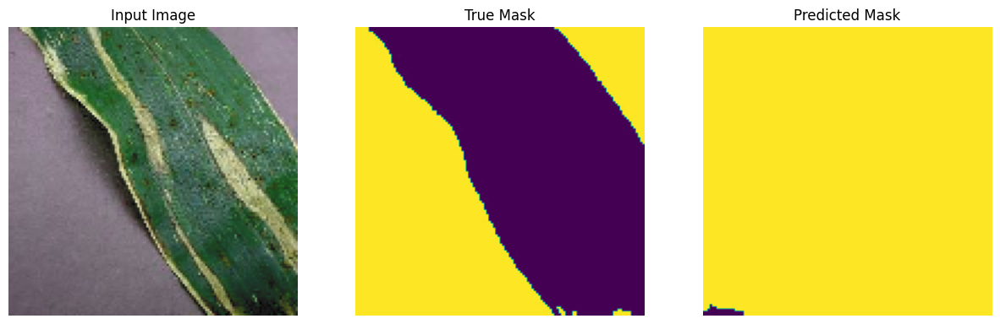

tf.Tensor(
[[[0.19123444 0.35347152 0.34841126]
  [0.07765135 0.23988841 0.23482817]
  [0.19880664 0.36104372 0.3559835 ]
  ...
  [0.3141138  0.5087017  0.49294162]
  [0.3141138  0.5087017  0.49294162]
  [0.3103277  0.5049156  0.48915553]]

 [[0.17230393 0.334541   0.32948077]
  [0.17609003 0.3383271  0.33326685]
  [0.14580122 0.3080383  0.30297804]
  ...
  [0.3065416  0.5011295  0.48536944]
  [0.3065416  0.5011295  0.48536944]
  [0.32168597 0.51627386 0.5005138 ]]

 [[0.15715952 0.3193966  0.31433636]
  [0.21395105 0.37618813 0.3711279 ]
  [0.16851784 0.3307549  0.32569468]
  ...
  [0.32547212 0.52006006 0.5043    ]
  [0.3141138  0.5087017  0.49294162]
  [0.3103277  0.5049156  0.48915553]]

 ...

 [[0.20134199 0.372402   0.3684341 ]
  [0.1861976  0.3572576  0.3532897 ]
  [0.15212266 0.3231827  0.3192148 ]
  ...
  [0.40203926 0.5995681  0.58417225]
  [0.3944671  0.59199595 0.5766001 ]
  [0.40203926 0.5995681  0.58417225]]

 [[0.12561992 0.29667994 0.29271203]
  [0.14833657 0.3193966  0

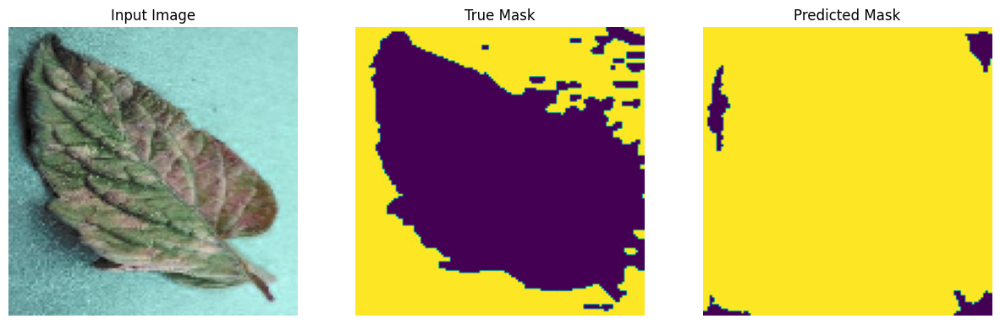

tf.Tensor(
[[[0.1496071  0.14385338 0.1306425 ]
  [0.1457533  0.13999957 0.12678869]
  [0.16502239 0.15926866 0.14605778]
  ...
  [0.19746861 0.21126822 0.19746117]
  [0.17049187 0.18429148 0.17048444]
  [0.18976097 0.20356058 0.18975353]]

 [[0.13419184 0.1284381  0.11522723]
  [0.09950747 0.09375374 0.08054285]
  [0.11492273 0.10916899 0.09595814]
  ...
  [0.18590716 0.19970676 0.18589972]
  [0.18590716 0.19970676 0.18589972]
  [0.18590716 0.19970676 0.18589972]]

 [[0.15731475 0.15156102 0.13835014]
  [0.15731475 0.15156102 0.13835014]
  [0.15346092 0.14770718 0.13449633]
  ...
  [0.17819951 0.19199911 0.17819208]
  [0.19746861 0.21126822 0.19746117]
  [0.20517625 0.21897584 0.20516881]]

 ...

 [[0.3099134  0.28725755 0.28280634]
  [0.25595996 0.2333041  0.22885291]
  [0.32147485 0.298819   0.29436782]
  ...
  [0.27678314 0.27628806 0.27349675]
  [0.2652217  0.2647266  0.2619353 ]
  [0.26136786 0.26087275 0.25808147]]

 [[0.33303633 0.31038046 0.30592927]
  [0.29835194 0.2756961  0

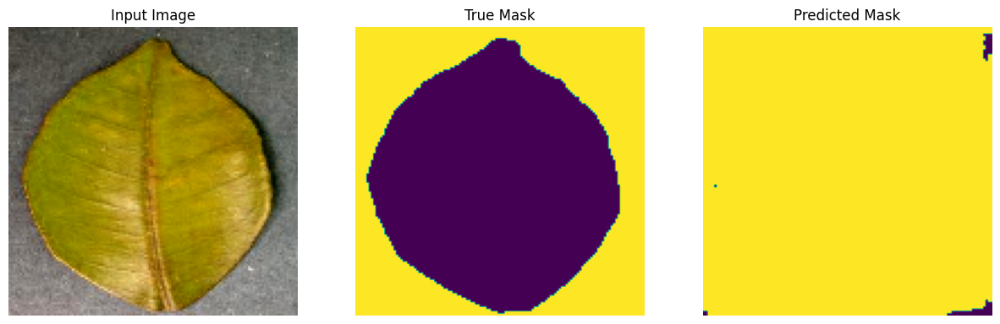

tf.Tensor(
[[[0.5740905  0.54647607 0.54239357]
  [0.564596   0.53698164 0.53289914]
  [0.57092565 0.54331124 0.5392288 ]
  ...
  [0.8177813  0.77892923 0.779341  ]
  [0.7956276  0.7557527  0.7520054 ]
  [0.78929794 0.7371626  0.73375046]]

 [[0.5677608  0.54014647 0.53606397]
  [0.5614312  0.5338168  0.5297343 ]
  [0.57092565 0.54331124 0.5392288 ]
  ...
  [0.80828685 0.76943475 0.7698465 ]
  [0.7956276  0.7567755  0.75718725]
  [0.7956276  0.7434922  0.7400801 ]]

 [[0.57092565 0.54331124 0.5392288 ]
  [0.5677608  0.54014647 0.53606397]
  [0.5804201  0.5528057  0.5487232 ]
  ...
  [0.8177813  0.77892923 0.779341  ]
  [0.839935   0.8010829  0.80149466]
  [0.82727575 0.78440475 0.77888346]]

 ...

 [[0.61206824 0.59432936 0.5922967 ]
  [0.61523306 0.5974942  0.59546155]
  [0.6089034  0.5911646  0.5891319 ]
  ...
  [0.805122   0.77581024 0.7869251 ]
  [0.84309983 0.813788   0.82490283]
  [0.8367702  0.8074584  0.81857324]]

 [[0.6089034  0.5911646  0.5891319 ]
  [0.6089034  0.5911646  0

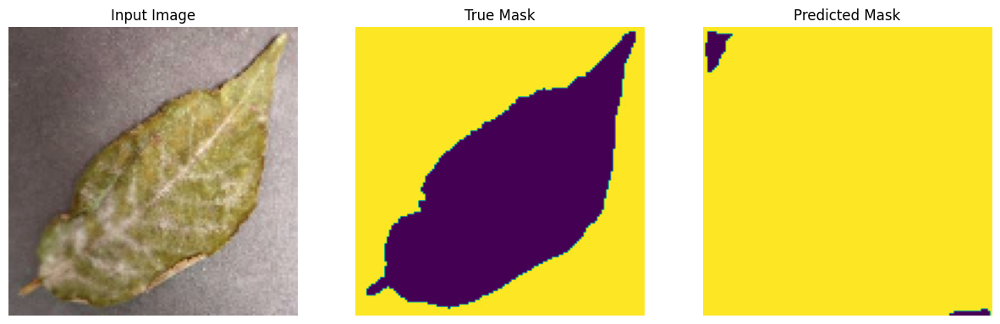

tf.Tensor(
[[[0.72715205 0.7742713  0.78786737]
  [0.73806846 0.7851877  0.7987838 ]
  [0.71987444 0.76699376 0.78058976]
  ...
  [0.60297203 0.64085966 0.6568702 ]
  [0.6175273  0.655415   0.67142546]
  [0.56658393 0.60447156 0.6204821 ]]

 [[0.72715205 0.7742713  0.78786737]
  [0.73442966 0.7815489  0.795145  ]
  [0.72351325 0.77063257 0.78422856]
  ...
  [0.60661083 0.64449847 0.660509  ]
  [0.6211661  0.6590538  0.67506427]
  [0.5993332  0.63722086 0.6532314 ]]

 [[0.73442966 0.7815489  0.795145  ]
  [0.71987444 0.76699376 0.78058976]
  [0.708958   0.75607735 0.76967335]
  ...
  [0.5884168  0.6263045  0.642315  ]
  [0.5884168  0.6263045  0.642315  ]
  [0.57386154 0.6117492  0.6277597 ]]

 ...

 [[0.7448856  0.78277326 0.7987838 ]
  [0.737608   0.77549565 0.7915062 ]
  [0.7412468  0.77913445 0.795145  ]
  ...
  [0.5620965  0.56064284 0.5804552 ]
  [0.609401   0.60794735 0.6277597 ]
  [0.66034436 0.6588907  0.67870307]]

 [[0.7412468  0.77913445 0.795145  ]
  [0.7339692  0.77185684 0

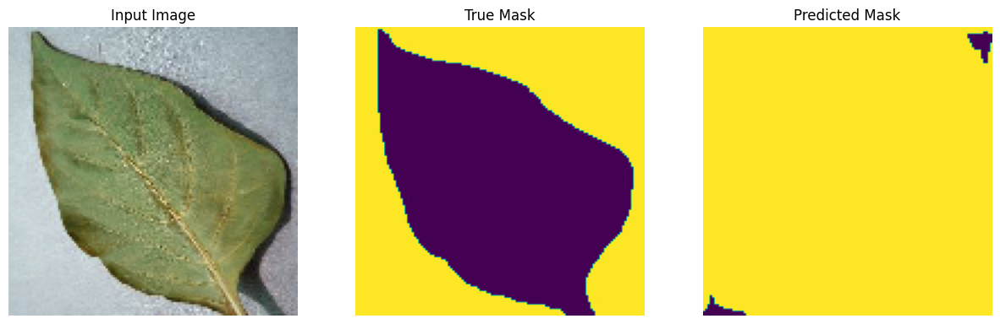

tf.Tensor(
[[[0.74392766 0.72465336 0.74890846]
  [0.7723051  0.7530308  0.7772859 ]
  [0.76419723 0.74492294 0.76917803]
  ...
  [0.6468508  0.61059237 0.63522744]
  [0.68738997 0.6511315  0.6757666 ]
  [0.6792822  0.64302367 0.6676588 ]]

 [[0.78041285 0.7611386  0.7853937 ]
  [0.7844668  0.7651925  0.7894476 ]
  [0.78041285 0.7611386  0.7853937 ]
  ...
  [0.6346891  0.59843063 0.6230657 ]
  [0.62252736 0.5862689  0.610904  ]
  [0.6630665  0.62680805 0.6514431 ]]

 [[0.7885207  0.7692464  0.7935015 ]
  [0.77635896 0.75708467 0.78133976]
  [0.77635896 0.75708467 0.78133976]
  ...
  [0.68738997 0.6511315  0.6757666 ]
  [0.6346891  0.59843063 0.6230657 ]
  [0.59415    0.5578915  0.5825266 ]]

 ...

 [[0.7928727  0.7743495  0.8299867 ]
  [0.7685493  0.75002605 0.8056632 ]
  [0.75233376 0.73381037 0.7894476 ]
  ...
  [0.74298507 0.7189015  0.7651241 ]
  [0.7673086  0.74322504 0.7894476 ]
  [0.75514686 0.73106325 0.7772859 ]]

 [[0.7361181  0.71759474 0.773232  ]
  [0.7117945  0.6932713  0

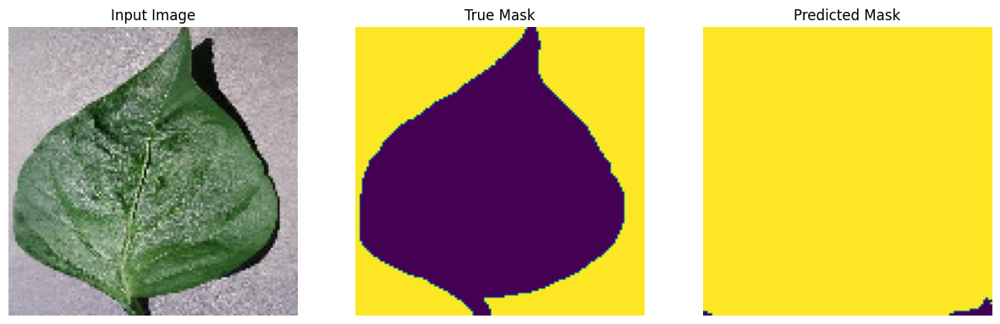

tf.Tensor(
[[[0.5588066  0.6062122  0.65413445]
  [0.5284517  0.5758573  0.62377954]
  [0.51544243 0.56284803 0.61077034]
  ...
  [0.6459627  0.6967075  0.74953556]
  [0.6416263  0.6923711  0.7451992 ]
  [0.6372899  0.68803465 0.7408627 ]]

 [[0.48942396 0.53682953 0.58475184]
  [0.5588066  0.6062122  0.65413445]
  [0.54146093 0.58886653 0.6367888 ]
  ...
  [0.6416263  0.6923711  0.7451992 ]
  [0.6372899  0.68803465 0.7408627 ]
  [0.6372899  0.68803465 0.7408627 ]]

 [[0.5067696  0.5541752  0.6020975 ]
  [0.5371245  0.5845301  0.63245237]
  [0.5284517  0.5758573  0.62377954]
  ...
  [0.6416263  0.6923711  0.7451992 ]
  [0.63295346 0.68369824 0.73652637]
  [0.6416263  0.6923711  0.7451992 ]]

 ...

 [[0.40355128 0.4617576  0.5153692 ]
  [0.39487845 0.45308477 0.50669634]
  [0.3818692  0.44007552 0.4936871 ]
  ...
  [0.5555397  0.60717046 0.67148006]
  [0.5598762  0.61150694 0.67581654]
  [0.568549   0.6201798  0.68448937]]

 [[0.3645235  0.42272985 0.47634143]
  [0.38620564 0.44441193 0

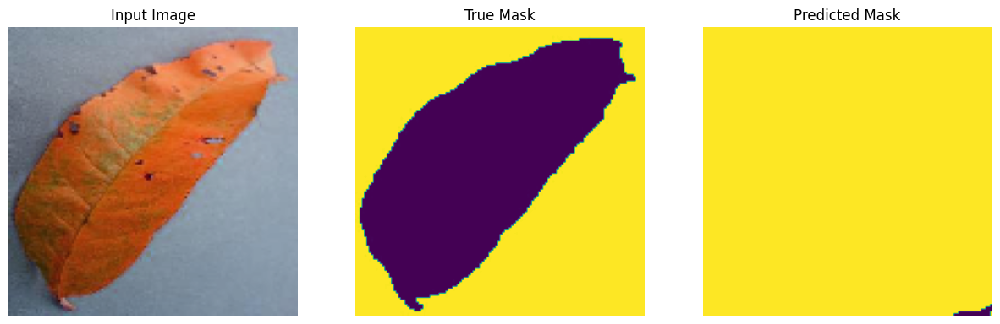

tf.Tensor(
[[[0.44650036 0.4398819  0.4261917 ]
  [0.43819785 0.43157938 0.41788918]
  [0.42159283 0.41497436 0.40128416]
  ...
  [0.50876915 0.4956777  0.48184022]
  [0.47971037 0.46661896 0.45278144]
  [0.46310535 0.45001397 0.43617645]]

 [[0.46310535 0.45648685 0.4427967 ]
  [0.4963154  0.4896969  0.47600675]
  [0.43404657 0.4274281  0.41373792]
  ...
  [0.51707166 0.5039802  0.49014273]
  [0.4963154  0.48322397 0.46938646]
  [0.48386163 0.47077018 0.4569327 ]]

 [[0.5129205  0.506302   0.49261177]
  [0.5502817  0.54366314 0.5299731 ]
  [0.42159283 0.41497436 0.40128416]
  ...
  [0.47971037 0.46661896 0.45278144]
  [0.43819785 0.42510644 0.41126892]
  [0.4672566  0.45416522 0.4403277 ]]

 ...

 [[0.6076416  0.593184   0.60196555]
  [0.6159441  0.6014865  0.61026806]
  [0.6325491  0.6180915  0.6268731 ]
  ...
  [0.6748193  0.66385686 0.66356516]
  [0.65821433 0.6472519  0.64696014]
  [0.6540631  0.64310074 0.6428089 ]]

 [[0.6367004  0.6222427  0.63102436]
  [0.6408516  0.626394   0

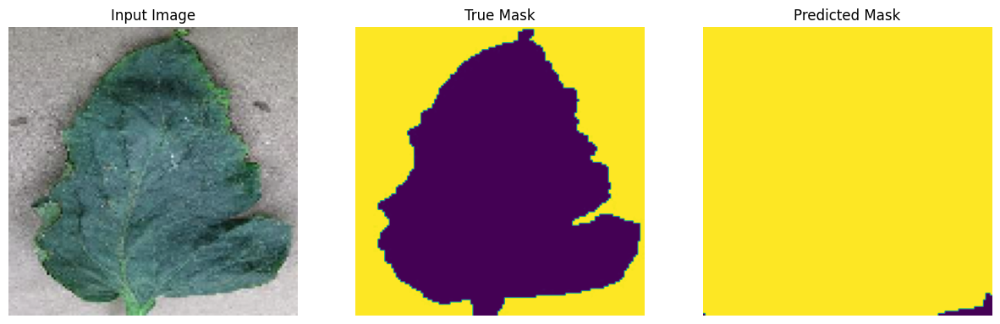

tf.Tensor(
[[[0.7838733  0.74703294 0.7466654 ]
  [0.7875167  0.7506764  0.7503088 ]
  [0.798447   0.7616067  0.7612391 ]
  ...
  [0.798447   0.7573651  0.75453126]
  [0.7401521  0.6990702  0.6962364 ]
  [0.76929957 0.72821766 0.7253838 ]]

 [[0.823951   0.7871108  0.78674316]
  [0.8348813  0.79804105 0.79767346]
  [0.8421682  0.80532783 0.8049603 ]
  ...
  [0.75836927 0.7172874  0.7144535 ]
  [0.721935   0.68085307 0.6780192 ]
  [0.7401521  0.6990702  0.6962364 ]]

 [[0.7948036  0.75796324 0.7575957 ]
  [0.79116017 0.75431985 0.75395226]
  [0.7838733  0.74703294 0.7466654 ]
  ...
  [0.7401521  0.6990702  0.6962364 ]
  [0.7292218  0.6881399  0.6853061 ]
  [0.7547258  0.7136439  0.71081007]]

 ...

 [[0.79116017 0.75924355 0.76488364]
  [0.8093773  0.7774607  0.78310084]
  [0.80573386 0.77381724 0.7794574 ]
  ...
  [0.798447   0.75982255 0.7697043 ]
  [0.7838733  0.7452488  0.7551305 ]
  [0.8421682  0.8035437  0.8134255 ]]

 [[0.798447   0.7665304  0.77217054]
  [0.8130207  0.78110415 0

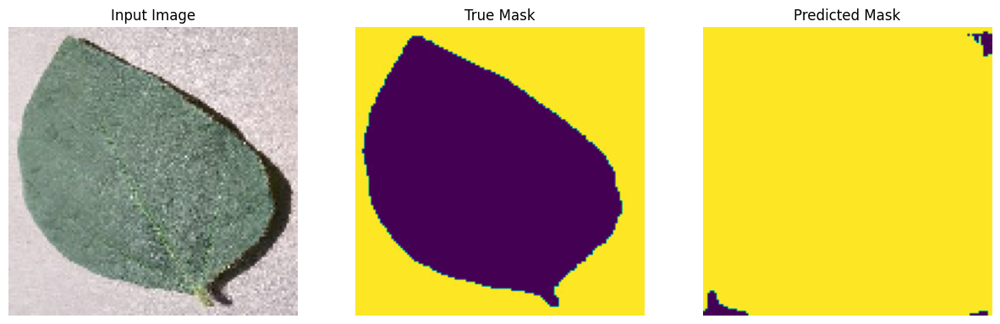

tf.Tensor(
[[[0.5248028  0.5316036  0.5369532 ]
  [0.52927977 0.53608054 0.5414302 ]
  [0.52927977 0.53608054 0.5414302 ]
  ...
  [0.5006044  0.5279993  0.5220669 ]
  [0.5095584  0.5369532  0.5310208 ]
  [0.50508136 0.53247625 0.52654386]]

 [[0.53375673 0.5405575  0.54590714]
  [0.5248028  0.5316036  0.5369532 ]
  [0.5158489  0.52264965 0.5279993 ]
  ...
  [0.4916505  0.51904535 0.51311296]
  [0.5006044  0.5279993  0.5220669 ]
  [0.49612746 0.5235223  0.5175899 ]]

 [[0.5382337  0.54503447 0.5503841 ]
  [0.52927977 0.53608054 0.5414302 ]
  [0.52927977 0.53608054 0.5414302 ]
  ...
  [0.48269656 0.5100914  0.50415903]
  [0.4916505  0.51904535 0.51311296]
  [0.48717353 0.5145684  0.508636  ]]

 ...

 [[0.5253952  0.50220376 0.51465476]
  [0.55673397 0.5335425  0.5459935 ]
  [0.64179635 0.6186049  0.6310559 ]
  ...
  [0.22680458 0.2325196  0.22930391]
  [0.18203494 0.18774995 0.18453427]
  [0.23575851 0.24147353 0.23825784]]

 [[0.6238885  0.60069704 0.61314803]
  [0.5701649  0.54697347 0

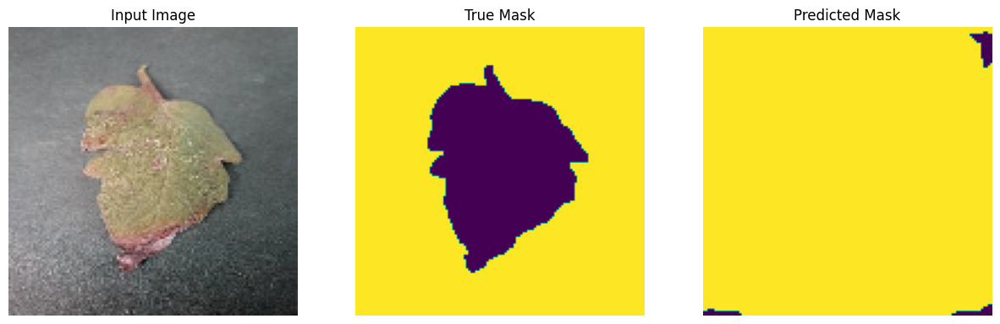

tf.Tensor(
[[[0.42965996 0.4215754  0.43424934]
  [0.42220625 0.4141217  0.42679563]
  [0.4184794  0.41039485 0.4230688 ]
  ...
  [0.34500843 0.3383148  0.34248236]
  [0.3338279  0.32713425 0.3313018 ]
  [0.3263742  0.31968054 0.3238481 ]]

 [[0.43338683 0.42530227 0.43797618]
  [0.42220625 0.4141217  0.42679563]
  [0.4184794  0.41039485 0.4230688 ]
  ...
  [0.3189205  0.31222683 0.3163944 ]
  [0.31519365 0.3085     0.31266755]
  [0.34500843 0.3383148  0.34248236]]

 [[0.43711367 0.42902914 0.44170302]
  [0.42593312 0.41784856 0.4305225 ]
  [0.42220625 0.4141217  0.42679563]
  ...
  [0.30773994 0.30104628 0.30521384]
  [0.30028623 0.29359257 0.29776013]
  [0.31519365 0.3085     0.31266755]]

 ...

 [[0.4892042  0.49668226 0.50133264]
  [0.49293104 0.5004091  0.5050595 ]
  [0.4817505  0.48922858 0.49387893]
  ...
  [0.3084575  0.3182592  0.3063404 ]
  [0.3159112  0.32571292 0.31379408]
  [0.28236952 0.29217124 0.28025243]]

 [[0.49293104 0.5004091  0.5050595 ]
  [0.4892042  0.49668226 0

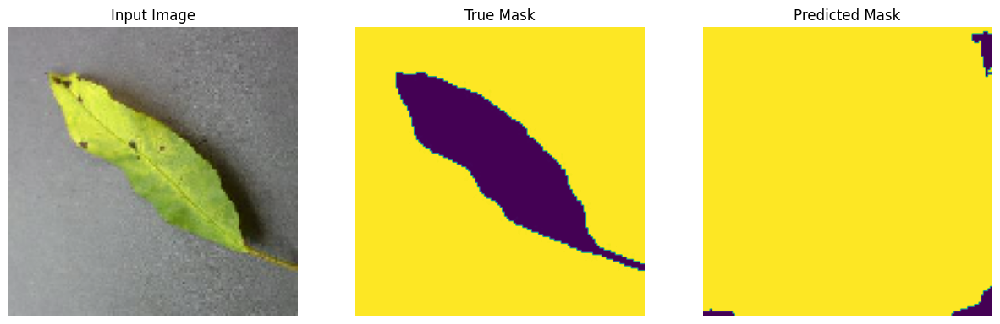

tf.Tensor(
[[[0.5209362  0.4022436  0.42642328]
  [0.45728266 0.3385901  0.3627698 ]
  [0.47142792 0.3527353  0.37691498]
  ...
  [0.49618205 0.36036274 0.38490966]
  [0.4855731  0.34975386 0.37430072]
  [0.46789157 0.3320723  0.3566192 ]]

 [[0.45021003 0.33151746 0.35569718]
  [0.5421541  0.42346147 0.44764113]
  [0.47142792 0.3527353  0.37691498]
  ...
  [0.5103273  0.374508   0.3990549 ]
  [0.49618205 0.36036274 0.38490966]
  [0.45021003 0.31439072 0.33893764]]

 [[0.53154516 0.41285253 0.4370322 ]
  [0.44667375 0.32798117 0.3521609 ]
  [0.54922664 0.43053406 0.45471367]
  ...
  [0.4749642  0.33914492 0.36369184]
  [0.40777433 0.271955   0.29650193]
  [0.45374635 0.31792703 0.34247395]]

 ...

 [[0.49264574 0.38422918 0.40544823]
  [0.506791   0.39837444 0.41959348]
  [0.49618208 0.38776553 0.40898457]
  ...
  [0.43606478 0.31394684 0.32997912]
  [0.37241125 0.2502933  0.26632565]
  [0.48910946 0.36699152 0.38302386]]

 [[0.48910946 0.3806929  0.40191194]
  [0.49264574 0.38422918 0

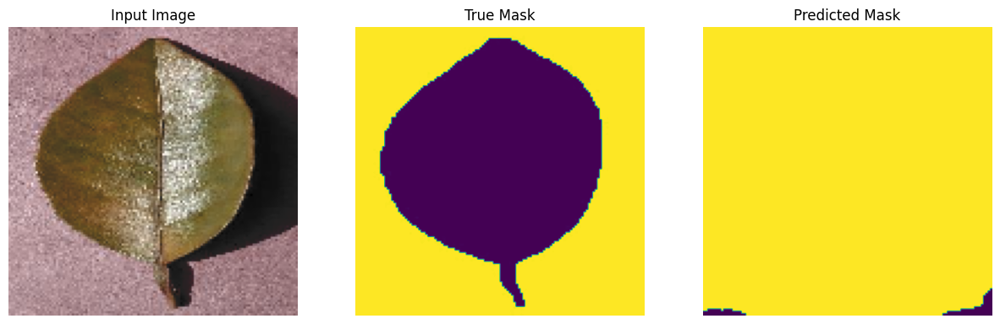

tf.Tensor(
[[[0.8508679  0.844198   0.8593108 ]
  [0.86164117 0.85497123 0.87008405]
  [0.8724144  0.8657445  0.8808573 ]
  ...
  [0.7658462  0.7375758  0.76739424]
  [0.8053481  0.7770777  0.8068961 ]
  [0.79816586 0.7698955  0.7997139 ]]

 [[0.85445905 0.8477891  0.8629019 ]
  [0.84727687 0.8406069  0.85571975]
  [0.86882335 0.8621534  0.87726617]
  ...
  [0.74429977 0.71602935 0.74584776]
  [0.7514819  0.7232115  0.75302994]
  [0.7478909  0.71962047 0.7494389 ]]

 [[0.8580501  0.85138017 0.866493  ]
  [0.85445905 0.8477891  0.8629019 ]
  [0.8760055  0.86933553 0.88444835]
  ...
  [0.7873927  0.75912225 0.78894067]
  [0.79816586 0.7698955  0.7997139 ]
  [0.79457486 0.76630443 0.79612285]]

 ...

 [[0.8715354  0.858044   0.8686537 ]
  [0.8715354  0.858044   0.8686537 ]
  [0.8894908  0.8759994  0.8866091 ]
  ...
  [0.81048715 0.78066874 0.7957082 ]
  [0.6991638  0.6693454  0.6843848 ]
  [0.82126033 0.7914419  0.80648136]]

 [[0.8823086  0.8688172  0.8794269 ]
  [0.86435324 0.85086185 0

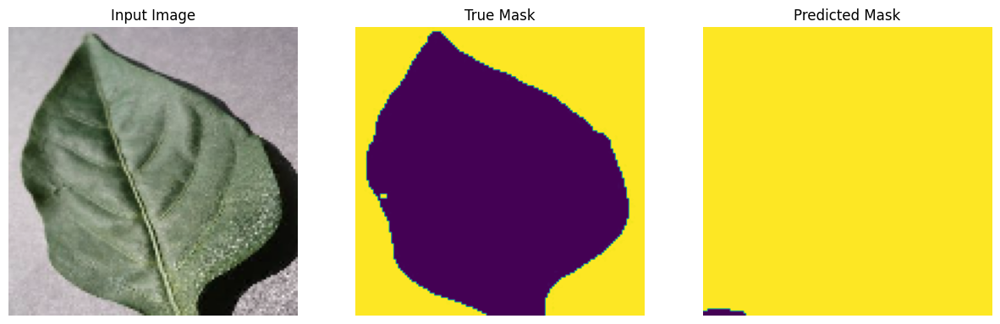

tf.Tensor(
[[[0.7052845  0.6903965  0.6845382 ]
  [0.6938421  0.6789541  0.6730958 ]
  [0.67477155 0.65988356 0.65402526]
  ...
  [0.6362809  0.61585337 0.6272624 ]
  [0.6286527  0.60822517 0.6196342 ]
  [0.6515374  0.63110983 0.64251894]]

 [[0.6976563  0.68276817 0.6769099 ]
  [0.68239975 0.66751176 0.66165346]
  [0.690028   0.67514    0.6692817 ]
  ...
  [0.6248386  0.60441107 0.61582017]
  [0.6133962  0.5929687  0.60437775]
  [0.6286527  0.60822517 0.6196342 ]]

 [[0.68239975 0.66751176 0.66165346]
  [0.6938421  0.6789541  0.6730958 ]
  [0.7052845  0.6903965  0.6845382 ]
  ...
  [0.64772326 0.62729573 0.6387048 ]
  [0.6324668  0.61203927 0.6234483 ]
  [0.64009506 0.6196675  0.6310765 ]]

 ...

 [[0.4344822  0.40561125 0.3963398 ]
  [0.40778336 0.3789124  0.36964098]
  [0.42685395 0.397983   0.38871157]
  ...
  [0.43066806 0.39483872 0.3925257 ]
  [0.42303982 0.38721046 0.38489744]
  [0.4154116  0.37958226 0.37726924]]

 [[0.40396926 0.37509832 0.36582687]
  [0.4115975  0.38272655 0

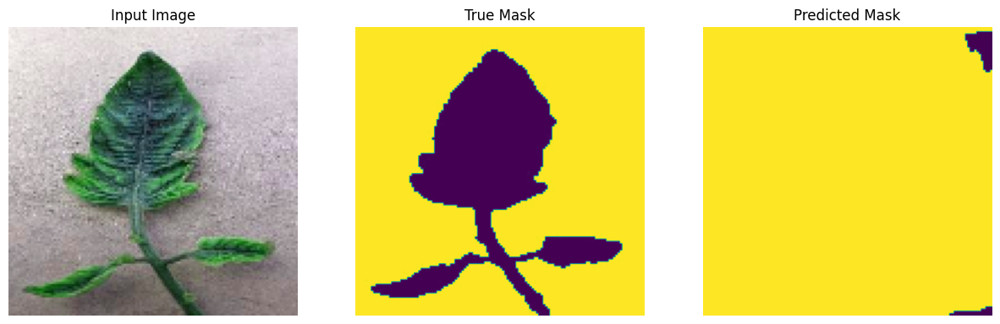

tf.Tensor(
[[[0.54194117 0.50595915 0.54279757]
  [0.4986122  0.46263024 0.49946862]
  [0.4986122  0.46263024 0.49946862]
  ...
  [0.5183072  0.4823252  0.5191636 ]
  [0.4592223  0.42324033 0.46007872]
  [0.49073422 0.45475227 0.49159065]]

 [[0.4749783  0.43899632 0.4758347 ]
  [0.5143682  0.47838622 0.5152246 ]
  [0.5498191  0.51383716 0.5506755 ]
  ...
  [0.4355884  0.3996064  0.4364448 ]
  [0.49073422 0.45475227 0.49159065]
  [0.5143682  0.47838622 0.5152246 ]]

 [[0.5537581  0.51777613 0.5546145 ]
  [0.4986122  0.46263024 0.49946862]
  [0.47103927 0.4350573  0.4718957 ]
  ...
  [0.53406316 0.49808118 0.53491956]
  [0.56951404 0.5335321  0.57037044]
  [0.5104292  0.47444722 0.5112856 ]]

 ...

 [[0.68864137 0.67957366 0.69641817]
  [0.6138006  0.6047329  0.6215774 ]
  [0.6571295  0.64806175 0.66490626]
  ...
  [0.69767267 0.68411934 0.7042961 ]
  [0.70161176 0.6880583  0.70823514]
  [0.71342874 0.6998753  0.7200521 ]]

 [[0.7240923  0.7150246  0.7318691 ]
  [0.64531255 0.6362448  0

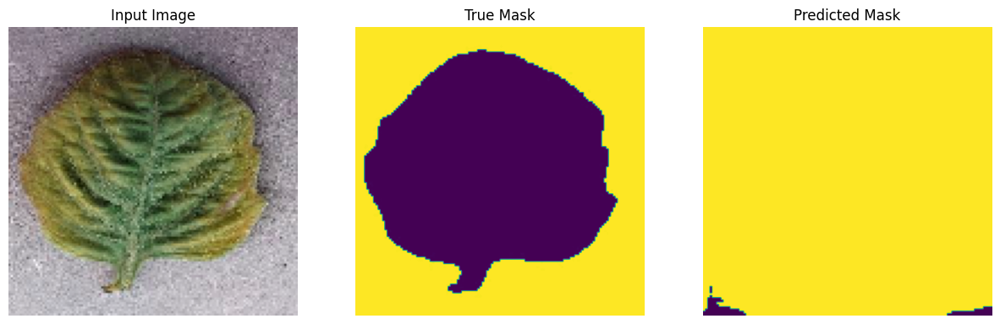

tf.Tensor(
[[[0.5067876  0.6809029  0.6839484 ]
  [0.51146555 0.68558097 0.6886264 ]
  [0.49275368 0.66686904 0.6699145 ]
  ...
  [0.29183295 0.4438319  0.45940545]
  [0.3479687  0.49996763 0.5155412 ]
  [0.31054485 0.4625438  0.47811735]]

 [[0.49743167 0.67154694 0.67459244]
  [0.51614356 0.690259   0.6933044 ]
  [0.5021096  0.67622495 0.6792704 ]
  ...
  [0.36668062 0.51867956 0.5342531 ]
  [0.24037518 0.3923741  0.40794766]
  [0.33861274 0.49061167 0.50618523]]

 [[0.4787197  0.65283513 0.6558806 ]
  [0.49743167 0.67154694 0.67459244]
  [0.49743167 0.67154694 0.67459244]
  ...
  [0.3479687  0.49996763 0.5155412 ]
  [0.0672899  0.21928889 0.23486245]
  [0.37135857 0.5233575  0.5389311 ]]

 ...

 [[0.49568874 0.7447621  0.7233622 ]
  [0.4722988  0.72137225 0.6999723 ]
  [0.44890893 0.6979823  0.67658246]
  ...
  [0.29932976 0.543609   0.5308702 ]
  [0.3180417  0.56232095 0.5495821 ]
  [0.2852958  0.5295751  0.5168363 ]]

 [[0.4769768  0.72605026 0.7046504 ]
  [0.4816548  0.7307282  0

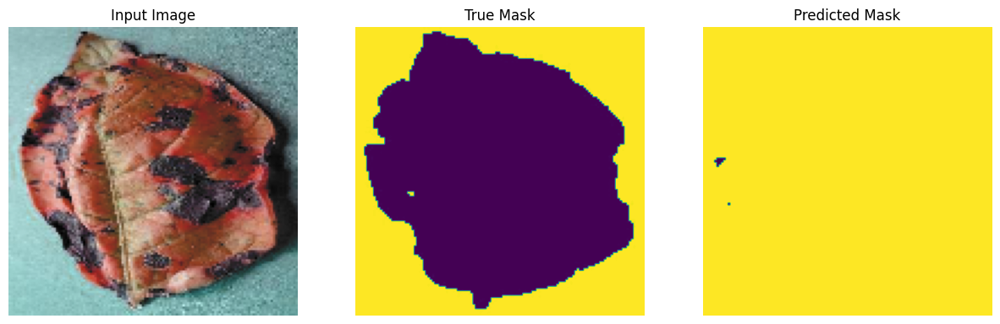

tf.Tensor(
[[[0.8864025  0.8007919  0.83967245]
  [0.94680655 0.861196   0.90007657]
  [0.9282207  0.8426101  0.88149065]
  ...
  [0.8538773  0.7596384  0.8047223 ]
  [0.84458435 0.75034547 0.79542935]
  [0.8631702  0.7689313  0.8140152 ]]

 [[0.95609945 0.8704889  0.9093694 ]
  [0.94216007 0.8565495  0.89543   ]
  [0.94216007 0.8565495  0.89543   ]
  ...
  [0.9235742  0.8293354  0.87441933]
  [0.8724631  0.7782243  0.8233082 ]
  [0.84458435 0.75034547 0.79542935]]

 [[0.9886247  0.9030141  0.94189465]
  [0.9235742  0.83796364 0.87684417]
  [0.9096348  0.82402426 0.8629048 ]
  ...
  [0.78882676 0.69458795 0.7396718 ]
  [1.0443822  0.9501434  0.9952273 ]
  [0.88175607 0.7875172  0.8326011 ]]

 ...

 [[0.9375136  0.89073014 0.9232663 ]
  [0.9653924  0.9186089  0.9511451 ]
  [0.96074593 0.9139625  0.94649863]
  ...
  [0.9142813  0.8502413  0.89087003]
  [0.88175607 0.81771606 0.8583448 ]
  [0.89104897 0.827009   0.86763775]]

 [[0.90034187 0.8535584  0.88609457]
  [0.89569545 0.848912   0

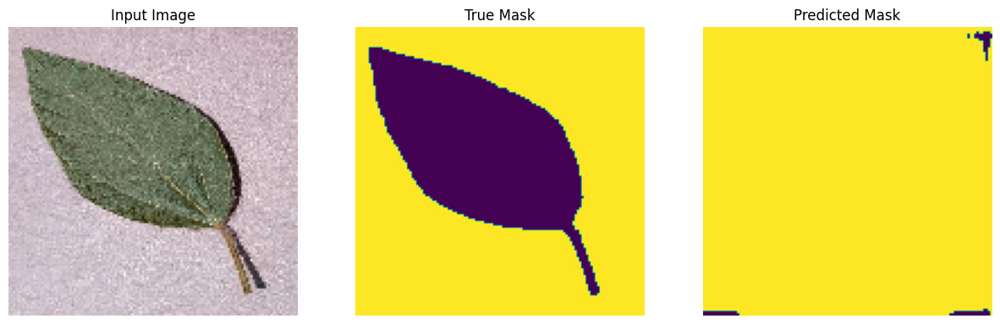

tf.Tensor(
[[[0.47191268 0.43089736 0.44489092]
  [0.53105444 0.49003908 0.5040327 ]
  [0.5583506  0.5173353  0.53132886]
  ...
  [0.5219557  0.48094034 0.50290745]
  [0.4946595  0.45364416 0.47561124]
  [0.52650505 0.48548973 0.5074568 ]]

 [[0.6538873  0.61287194 0.6268655 ]
  [0.4309684  0.38995302 0.40394658]
  [0.67208475 0.6310694  0.645063  ]
  ...
  [0.4946595  0.45364416 0.47561124]
  [0.5356038  0.49458846 0.5165554 ]
  [0.52650505 0.48548973 0.5074568 ]]

 [[0.51285696 0.47184163 0.4858352 ]
  [0.46736333 0.42634797 0.4403415 ]
  [0.5674494  0.526434   0.5404276 ]
  ...
  [0.51285696 0.47184163 0.4938087 ]
  [0.46736333 0.42634797 0.44831505]
  [0.5492519  0.5082365  0.53020364]]

 ...

 [[0.5947456  0.52582294 0.54124093]
  [0.5356038  0.4666812  0.48209915]
  [0.4036722  0.33474958 0.35016754]
  ...
  [0.35817856 0.30520293 0.32379368]
  [0.4355178  0.38254213 0.40113294]
  [0.39912283 0.3461472  0.364738  ]]

 [[0.4173203  0.34839767 0.36381564]
  [0.39912283 0.33020023 0

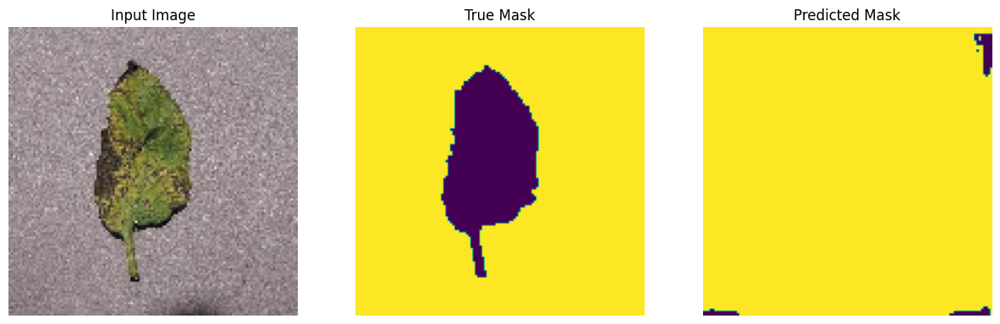

tf.Tensor(
[[[0.76286757 0.7572395  0.64313114]
  [0.72982085 0.7241928  0.6100844 ]
  [0.7835218  0.7778937  0.66378534]
  ...
  [0.8661385  0.8462085  0.78281575]
  [0.85787684 0.83794683 0.7745541 ]
  [0.8620077  0.8420777  0.7786849 ]]

 [[0.7380825  0.73245454 0.6183461 ]
  [0.73395175 0.7283237  0.6142153 ]
  [0.7380825  0.73245454 0.6183461 ]
  ...
  [0.85787684 0.83794683 0.7745541 ]
  [0.8413535  0.8214235  0.7580307 ]
  [0.85787684 0.83794683 0.7745541 ]]

 [[0.7380825  0.73245454 0.6183461 ]
  [0.72569007 0.720062   0.60595363]
  [0.72569007 0.720062   0.60595363]
  ...
  [0.8702693  0.85033935 0.7869466 ]
  [0.84961516 0.82968515 0.7662924 ]
  [0.85787684 0.83794683 0.7745541 ]]

 ...

 [[0.7546059  0.75399977 0.60605526]
  [0.7669984  0.7663923  0.6184478 ]
  [0.76286757 0.76226145 0.61431694]
  ...
  [0.9322319  0.91652143 0.81609726]
  [0.9322319  0.91652143 0.81609726]
  [0.9404936  0.9247832  0.82435894]]

 [[0.75047505 0.7498689  0.6019244 ]
  [0.7587367  0.7581306  0

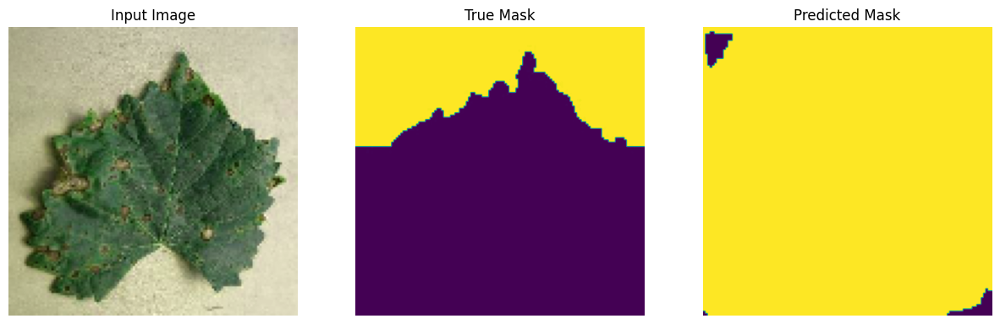

tf.Tensor(
[[[0.32542396 0.35272482 0.31067264]
  [0.3159192  0.3269757  0.29145196]
  [0.32233256 0.3269757  0.3012445 ]
  ...
  [0.2551911  0.24007721 0.21482004]
  [0.2551911  0.24007721 0.21482004]
  [0.26254794 0.24743408 0.2221769 ]]

 [[0.33803546 0.34315825 0.3531556 ]
  [0.32605222 0.32458857 0.33476338]
  [0.33979505 0.32825196 0.32553747]
  ...
  [0.2699048  0.25479096 0.22953376]
  [0.28461856 0.26950467 0.24424751]
  [0.28829697 0.2731831  0.24792594]]

 [[0.3532283  0.3454662  0.3752262 ]
  [0.35089615 0.33645236 0.3531556 ]
  [0.36922258 0.34152594 0.35202602]
  ...
  [0.22944205 0.21432818 0.189071  ]
  [0.23312049 0.21800661 0.19274943]
  [0.26622638 0.25111252 0.22585534]]

 ...

 [[0.50900304 0.5072525  0.49474546]
  [0.5053246  0.5035741  0.49106702]
  [0.49796778 0.49621722 0.48371017]
  ...
  [0.43175596 0.41664207 0.3913849 ]
  [0.36554414 0.35043022 0.32517302]
  [0.36554414 0.35043022 0.32517302]]

 [[0.50900304 0.5072525  0.49474546]
  [0.50900304 0.5072525  0

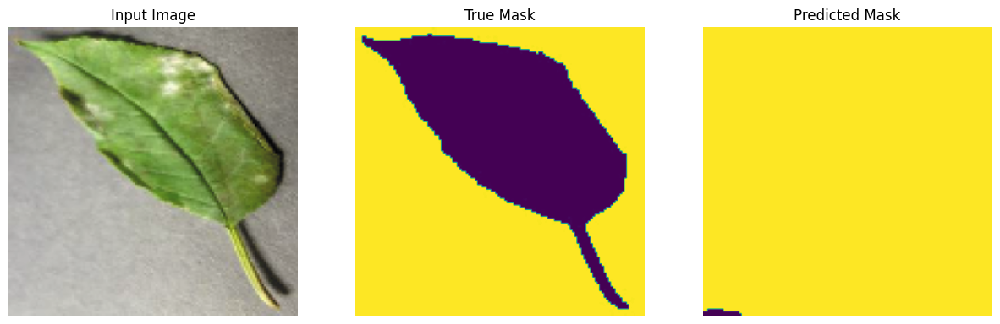

tf.Tensor(
[[[0.76434475 0.7097426  0.7123074 ]
  [0.8473673  0.79276514 0.7953299 ]
  [0.8473673  0.79276514 0.7953299 ]
  ...
  [0.6988008  0.6366574  0.60026383]
  [0.62014794 0.5580046  0.521611  ]
  [0.6070391  0.54489595 0.5085021 ]]

 [[0.78619283 0.7315907  0.7341555 ]
  [0.7730839  0.71848184 0.72104657]
  [0.87358487 0.8189827  0.8215475 ]
  ...
  [0.7381271  0.67598397 0.6395902 ]
  [0.6944311  0.632288   0.59589416]
  [0.59393036 0.531787   0.4953933 ]]

 [[0.751236   0.6966339  0.69919866]
  [0.8255192  0.77091706 0.77348185]
  [0.82114965 0.7665475  0.7691123 ]
  ...
  [0.5895607  0.5274175  0.4910237 ]
  [0.80367124 0.74152786 0.7051343 ]
  [0.6988008  0.6366574  0.60026383]]

 ...

 [[0.84299755 0.79887116 0.792981  ]
  [0.860476   0.8163495  0.8104594 ]
  [0.7250184  0.68089175 0.6750016 ]
  ...
  [0.6856919  0.6312877  0.5963259 ]
  [0.7599752  0.70557076 0.6706092 ]
  [0.7337576  0.6793532  0.64439154]]

 [[0.85610646 0.8119799  0.8060897 ]
  [0.8866936  0.8425672  0

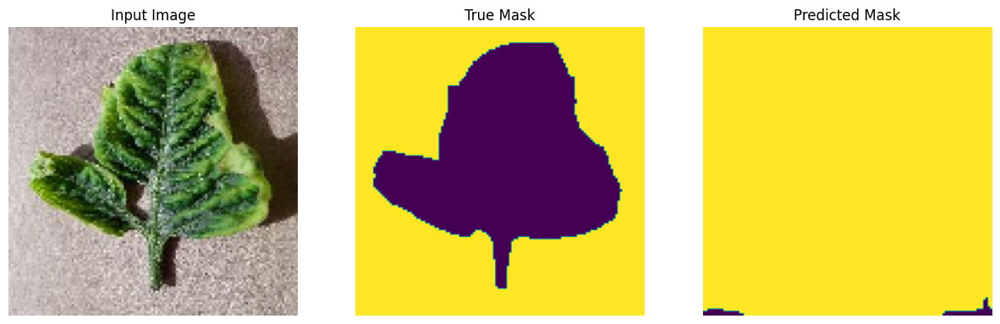

tf.Tensor(
[[[0.8681749  0.8891439  0.90789115]
  [0.8261638  0.8471328  0.8658801 ]
  [0.84232193 0.863291   0.88203824]
  ...
  [0.790616   0.811585   0.8303322 ]
  [0.74860483 0.76957387 0.78832114]
  [0.764763   0.785732   0.80447924]]

 [[0.8261638  0.8471328  0.8658801 ]
  [0.8132373  0.8342064  0.8529536 ]
  [0.8455535  0.8665226  0.8852698 ]
  ...
  [0.78415275 0.8051217  0.823869  ]
  [0.7356784  0.75664747 0.7753947 ]
  [0.7712262  0.7921953  0.81094253]]

 [[0.83262706 0.85359603 0.8723433 ]
  [0.8681749  0.8891439  0.90789115]
  [0.88110137 0.90207046 0.9208177 ]
  ...
  [0.78738433 0.8083534  0.82710063]
  [0.7518365  0.7728056  0.7915528 ]
  [0.7421416  0.7631107  0.7818579 ]]

 ...

 [[0.7163768  0.7271125  0.7592365 ]
  [0.7389981  0.74973387 0.7818579 ]
  [0.5709537  0.5816895  0.61381346]
  ...
  [0.69138247 0.687204   0.7269203 ]
  [0.72046703 0.7162886  0.7560049 ]
  [0.66229784 0.6581194  0.6978357 ]]

 [[0.69375545 0.7044912  0.7366152 ]
  [0.6517443  0.66248006 0

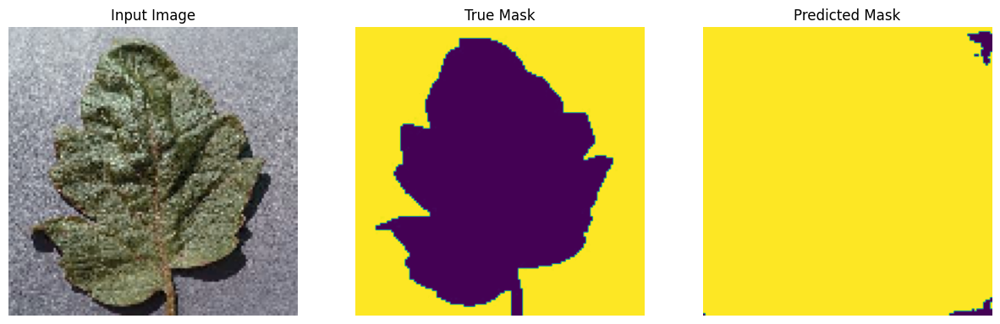

tf.Tensor(
[[[0.7544842  0.7290769  0.7304566 ]
  [0.7637662  0.738359   0.73973864]
  [0.7684072  0.743      0.74437964]
  ...
  [0.7823303  0.756923   0.7583027 ]
  [0.7776893  0.752282   0.7536617 ]
  [0.7730483  0.74764097 0.7490207 ]]

 [[0.7637662  0.738359   0.73973864]
  [0.7684072  0.743      0.74437964]
  [0.7730483  0.74764097 0.7490207 ]
  ...
  [0.7916123  0.7662051  0.76758474]
  [0.7823303  0.756923   0.7583027 ]
  [0.7823303  0.756923   0.7583027 ]]

 [[0.7684072  0.743      0.74437964]
  [0.7730483  0.74764097 0.7490207 ]
  [0.7730483  0.74764097 0.7490207 ]
  ...
  [0.8008944  0.77548707 0.7768668 ]
  [0.7916123  0.7662051  0.76758474]
  [0.78697133 0.761564   0.76294374]]

 ...

 [[0.43889502 0.41348773 0.41486743]
  [0.44353604 0.41812876 0.41950846]
  [0.44353604 0.41812876 0.41950846]
  ...
  [0.55027944 0.5248722  0.53338945]
  [0.52243334 0.49702606 0.50554335]
  [0.55027944 0.5248722  0.53338945]]

 [[0.4017669  0.37635958 0.3777393 ]
  [0.41568995 0.39028263 0

2024-08-12 08:21:52.031099: W tensorflow/core/kernels/data/cache_dataset_ops.cc:854] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


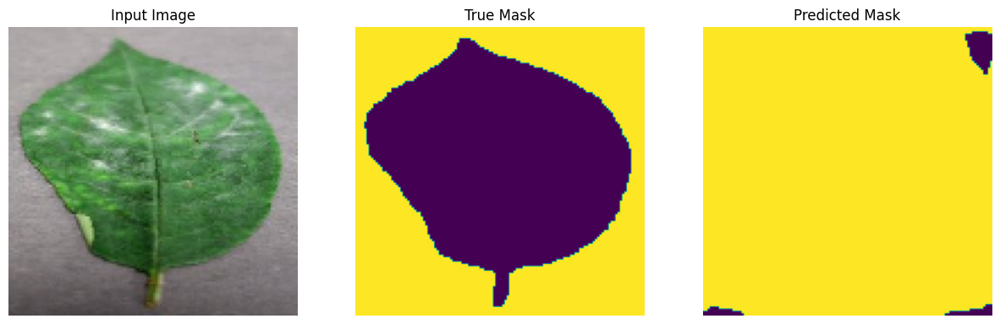

In [29]:
# show_predictions(aug_train_batches, 30)
# show_predictions(test_batches, 30)
show_predictions(train_batches, 30)
# show_predictions(tomato_background_batches, 30)

In [30]:
class DisplayCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):
    clear_output(wait=True)
    show_predictions()
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

In [31]:
! pip list | grep tensorflow

tensorflow                    2.14.1
tensorflow-datasets           4.9.6
tensorflow-estimator          2.14.0
tensorflow-examples           0.1703207612.1461250479831370929614362828255168868146460245314
tensorflow-hub                0.16.1
tensorflow-io-gcs-filesystem  0.34.0
tensorflow-metadata           1.15.0
tensorflow-model-optimization 0.8.0
tensorflow-text               2.14.0


In [32]:
#code to fit the model 

TRAIN_LENGTH = train_size
BATCH_SIZE = 32
BUFFER_SIZE = 200
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE
early_stop = tf.keras.callbacks.EarlyStopping(monitor='accuracy', 
                                              patience=3, 
                                              restore_best_weights=True)


EPOCHS = 12
VAL_SUBSPLITS = 5
VALIDATION_STEPS = len(test_dataset) //BATCH_SIZE// VAL_SUBSPLITS 

model_history = model2.fit(finetune_train_batches, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=test_batches,
                          callbacks=[DisplayCallback(), early_stop])

Epoch 1/12


2024-08-12 08:22:08.228277: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 3.75GiB (4024891904 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 08:22:08.228298: W tensorflow/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.94GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-08-12 08:22:08.807805: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 3.75GiB (4024891904 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 08:22:08.807826: W tensorflow/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.94GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.


   1/1327 [..............................] - ETA: 2:57:08 - loss: 0.7699 - accuracy: 0.5224

2024-08-12 08:22:09.291774: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7ff56c854190 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-08-12 08:22:09.291789: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 2080 SUPER, Compute Capability 7.5
2024-08-12 08:22:09.304985: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-08-12 08:22:09.380213: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 621/1327 [=============>................] - ETA: 3:43 - loss: 0.4335 - accuracy: 0.8539


KeyboardInterrupt



In [53]:
print(model2.evaluate(train_batches.take(100)))

100/100 [==============================] - 17s 172ms/step - loss: 0.3491 - accuracy: 0.9381
[0.34913715720176697, 0.9380998015403748]


In [4]:
# model = tf.keras.models.load_model('new_segment_95.keras')
# tf.keras.models.save_model(model2, 'not_finetuned.keras')

finetuned_model = tf.keras.models.load_model('for_yolo_v2.keras')
def save_convert_model(model):
    # tf.keras.models.save_model(model, model_name)
    converter = tf.lite.TFLiteConverter.from_keras_model(model)
    tflite_model = converter.convert()
    with open('for_yolo_seg.tflite', "wb") as f:
        f.write(tflite_model)

save_convert_model(finetuned_model)

2024-08-12 09:39:31.082584: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 8.00GiB (8589934592 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 09:39:31.082715: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 7.20GiB (7730940928 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 09:39:31.082832: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 6.48GiB (6957846528 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 09:39:31.082944: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 5.83GiB (6262061568 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 09:39:31.083055: I tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:746] failed to allocate 5.25GiB (5635855360 bytes) from device: CUDA_ERROR_OUT_OF_MEMORY: out of memory
2024-08-12 09:39:31.083165: I 

INFO:tensorflow:Assets written to: /tmp/tmp0pi_4bsq/assets


INFO:tensorflow:Assets written to: /tmp/tmp0pi_4bsq/assets
2024-08-12 09:39:44.296309: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:378] Ignored output_format.
2024-08-12 09:39:44.296329: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:381] Ignored drop_control_dependency.
2024-08-12 09:39:44.296900: I tensorflow/cc/saved_model/reader.cc:83] Reading SavedModel from: /tmp/tmp0pi_4bsq
2024-08-12 09:39:44.314504: I tensorflow/cc/saved_model/reader.cc:51] Reading meta graph with tags { serve }
2024-08-12 09:39:44.314521: I tensorflow/cc/saved_model/reader.cc:146] Reading SavedModel debug info (if present) from: /tmp/tmp0pi_4bsq
2024-08-12 09:39:44.349368: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:382] MLIR V1 optimization pass is not enabled
2024-08-12 09:39:44.365899: I tensorflow/cc/saved_model/loader.cc:233] Restoring SavedModel bundle.
2024-08-12 09:39:44.689140: I tensorflow/cc/saved_model/loader.cc:217] Running initializatio

In [33]:
# model2 = tf.keras.models.load_model('new_segment_95.keras')
# model3 = tf.keras.models.load_model('new_segment_95.keras')

not_finetuned_model = tf.keras.models.load_model('not_finetuned.keras')
# model2 = not_finetuned_model

# finetune_model = not_finetuned_model

In [ ]:
# experimental fine tune code:
# output_channels = 2
# for layer in not_finetuned_model.layers[:-54]:  # 假设要保留最后四层（包括 GlobalAveragePooling2D 和 Dense 层）
#     layer.trainable = False


# x = not_finetuned_model.get_layer('concatenate_15').output #use 15 if doing not_finetuned.keras
# x = tf.keras.layers.Conv2D(filters=output_channels, kernel_size=3, padding='same')(x)
# x = tf.keras.layers.Activation('softmax' if output_channels > 1 else 'sigmoid')(x)
# final = tf.image.resize(x, size=[x.shape[1] * 2, x.shape[2] * 2], method=tf.image.ResizeMethod.BILINEAR)

# finetune_model = tf.keras.Model(inputs=not_finetuned_model.inputs, outputs=final)


# # #finetune model
# # down_stack.trainable = True 
# # fine_tune_at = 80
base_learning_rate = 0.001
finetune_model = not_finetuned_model
EPOCHS = 12
TRAIN_LENGTH = len(finetuning_dataset) #len(office_dataset) * 300
BATCH_SIZE = 32
BUFFER_SIZE = 500
EPOCHS = 8
VAL_SUBSPLITS = 5
VALIDATION_STEPS = len(test_dataset) //BATCH_SIZE// VAL_SUBSPLITS 

early_stop = tf.keras.callbacks.EarlyStopping(monitor='accuracy', 
                                              patience=2, 
                                              restore_best_weights=True) 

STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE
# # # # Freeze all the layers before the `fine_tune_at` layer
# # for layer in base_model.layers[:fine_tune_at]:
# #   layer.trainable = False
# # print("Compiling")
finetune_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate * 10),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),#tf.keras.losses.BinaryCrossentropy(),
              metrics=['accuracy'])    
# print("Training")
# print(finetune_model.summary())
# print(finetune_model.evaluate(aug_train_batches.take(100)))
print(finetune_model.evaluate(office_batches.take(10)))


try:
  model_history = finetune_model.fit(finetune_train_batches, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=test_batches,
                          callbacks=[early_stop])
  assert False
except Exception as e:
  print(f"Expected {type(e).__name__}: {e}")
    
print(finetune_model.evaluate(office_batches.take(10)))


2024-08-12 08:25:47.637141: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:44: Filling up shuffle buffer (this may take a while): 456 of 1000
2024-08-12 08:25:57.229005: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


10/10 [==============================] - 35s 1s/step - loss: 0.7342 - accuracy: 0.5632


2024-08-12 08:26:11.726566: W tensorflow/core/kernels/data/cache_dataset_ops.cc:854] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


[0.734192430973053, 0.563217282295227]
Epoch 1/8
 379/1437 [======>.......................] - ETA: 6:05 - loss: 0.3759 - accuracy: 0.9099

In [41]:
#load or save the model 
# model2.save('new_segment_95.keras')
# model.save('taiwan39.keras')
# model2.save('seg94.keras')
# model2.evaluate(test_batches)
# model2 =  tf.keras.models.load_model('seg94.keras')
# #try augmenting the dataset before predicting 
# model2.evaluate(aug_train_batches)
# show_predictions(aug_train_batches, 20)
# finetune_model = not_finetuned_model
# finetune_model.evaluate(random_batches.take(100))
# tf.keras.models.save_model(finetune_model, 'finetuned_94.keras')

finetune_model.save("for_yolo_v2.keras")

In [38]:
def show_background_removed_predictions(model, dataset=None, num=1): #if it doesnt work switch dataset back to none 
  if dataset:
    print("HAS DATASET")
    for image, mask in dataset.take(num):
      image = image[0]
      print(image.shape)
      pred_mask = model.predict(image[tf.newaxis, ...])
    
      background_removed_image = no_background_image(create_mask(pred_mask), image, image)
        
      display([image, create_mask(pred_mask), background_removed_image])
  else:
    prediction = model2.predict(sample_image[tf.newaxis, ...])
    display([sample_image, sample_mask, create_mask(prediction)])

def show_background_removed_predictions_batches(model, dataset=None, num=1): #if it doesnt work switch dataset back to none 
  if dataset:
    print("HAS DATASET")
    for image, mask in dataset.unbatch().take(num):
      print(image.shape)
      # image = cv2.imread('../Samuel_Plant_Disease/PlantVillage/dataset/tomato_background/Lb24.JPG') #image
      # image = cv2.resize(image, (128, 128))
      # image = image / 255
      # image = image / 255
      print(image)
      pred_mask = model.predict(image[tf.newaxis, ...])
    
      background_removed_image = no_background_image(create_mask(pred_mask), image, image)
        
      display([image, create_mask(pred_mask), background_removed_image])
  else:
    prediction = model2.predict(sample_image[tf.newaxis, ...])
    display([sample_image, sample_mask, create_mask(prediction)])

def compare_model_background_removed(models, dataset=None, num=1): #if it doesnt work switch dataset back to none 
  if dataset:
    print("HAS DATASET")
    for image, mask in dataset.unbatch().take(num):
      images = [] 
      print(image.shape)
      # image = cv2.imread('../Samuel_Plant_Disease/PlantVillage/dataset/tomato_background/Lb24.JPG') #image
      # image = cv2.resize(image, (128, 128))
      # image = image / 255
      # image = image / 255
      print(image)
      images.append(image)
      # images.append(no_background_image(create_mask(mask), image, image))

      for model in models:   
          pred_mask = model.predict(image[tf.newaxis, ...])
          background_removed_image = no_background_image(create_mask(pred_mask), image, image)
          images.append(background_removed_image)
        
      display(images)
  else:
    prediction = model2.predict(sample_image[tf.newaxis, ...])
    display([sample_image, sample_mask, create_mask(prediction)])

HAS DATASET
(128, 128, 3)
tf.Tensor(
[[[-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  ...
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]]

 [[-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  ...
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]]

 [[-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  ...
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]]

 ...

 [[-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  ...
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.04476622 -0.04476622 -0.04476622]
  [-0.0

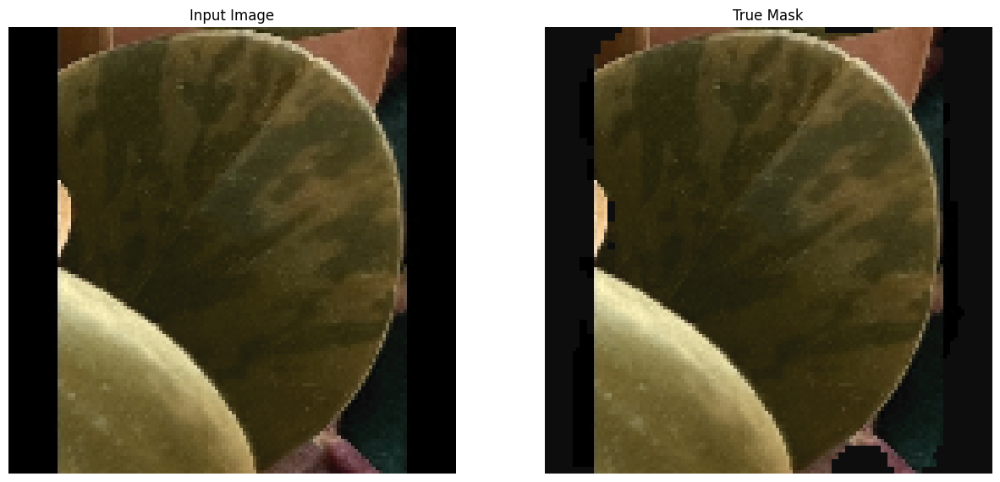

(128, 128, 3)
tf.Tensor(
[[[0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  ...
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]]

 [[0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  ...
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]]

 [[0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  ...
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]]

 ...

 [[0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  ...
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]
  [0.1803895  0.17849961 0.17818168]]

 [[0.1803895  0.17849961 0.17818168]
  [0.1803895

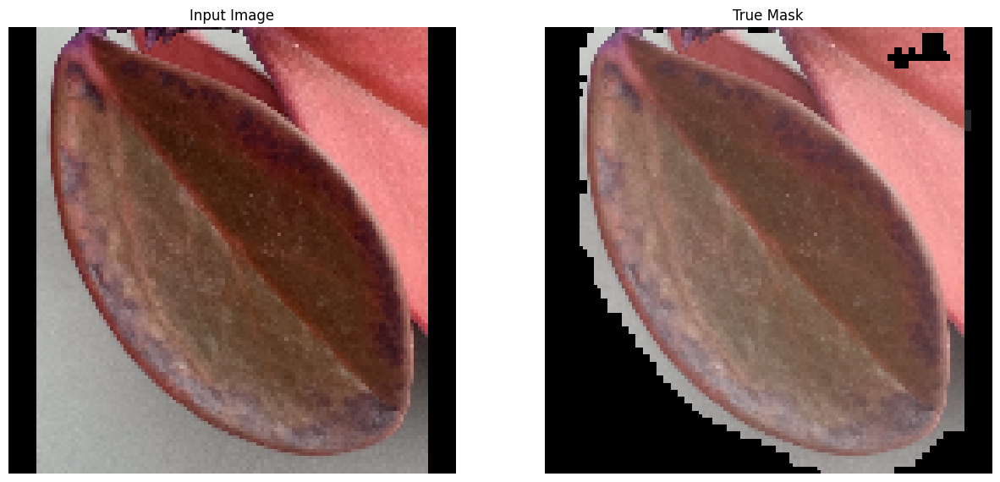

(128, 128, 3)
tf.Tensor(
[[[-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  ...
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]]

 [[-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  ...
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]]

 [[-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  ...
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]]

 ...

 [[-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  ...
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.05751696 -0.05751696]
  [-0.05751696 -0.0

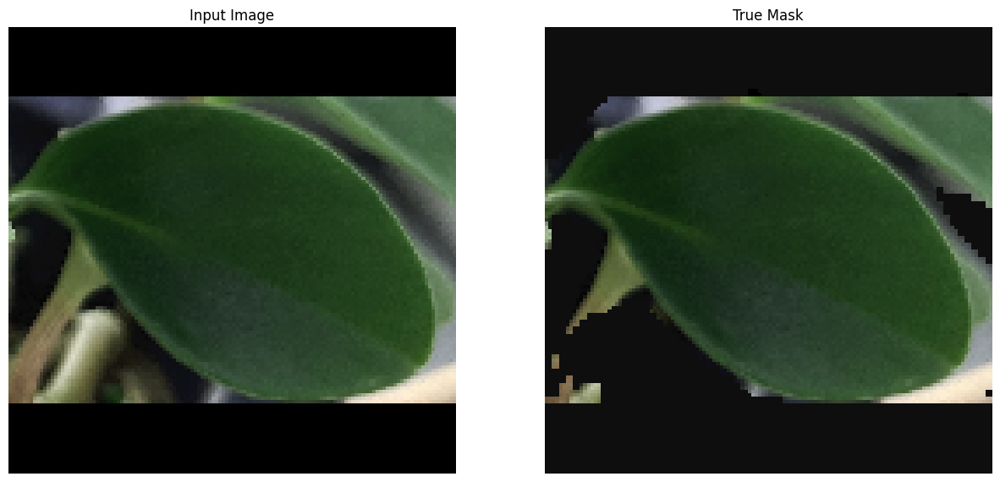

(128, 128, 3)
tf.Tensor(
[[[0.10040908 0.11247784 0.09358986]
  [0.10354114 0.11247784 0.10105995]
  [0.10354114 0.11247784 0.10105995]
  ...
  [0.10040908 0.11247784 0.09358986]
  [0.10040908 0.11247784 0.09358986]
  [0.10040908 0.11247784 0.09358986]]

 [[0.10040908 0.11247784 0.09358986]
  [0.10040908 0.11247784 0.09358986]
  [0.10040908 0.11247784 0.09358986]
  ...
  [0.10040908 0.11247784 0.09358986]
  [0.10040908 0.11247784 0.09358986]
  [0.10040908 0.11247784 0.09358986]]

 [[0.09872293 0.11609274 0.09346974]
  [0.10282072 0.12332261 0.09322949]
  [0.09703676 0.11970767 0.09334961]
  ...
  [0.0986028  0.11970767 0.09708466]
  [0.09872293 0.11609274 0.09346974]
  [0.09872293 0.11609274 0.09346974]]

 ...

 [[0.09703676 0.11970767 0.09334961]
  [0.09703676 0.11970767 0.09334961]
  [0.09703676 0.11970767 0.09334961]
  ...
  [0.09872293 0.11609274 0.09346974]
  [0.09872293 0.11609274 0.09346974]
  [0.09872293 0.11609274 0.09346974]]

 [[0.10040908 0.11247784 0.09358986]
  [0.1004090

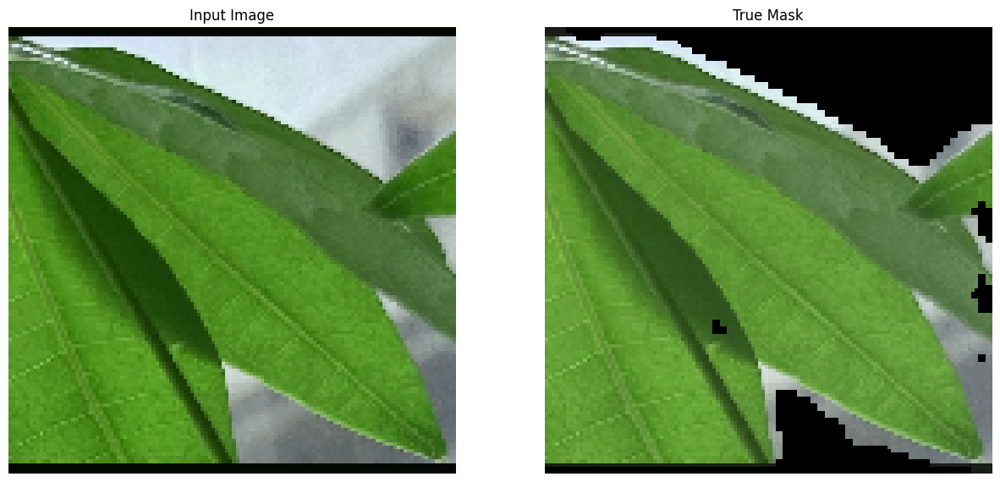

(128, 128, 3)
tf.Tensor(
[[[0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  ...
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]]

 [[0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  ...
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]]

 [[0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  ...
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]]

 ...

 [[0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  ...
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]
  [0.150886   0.15821171 0.17332354]]

 [[0.150886   0.15821171 0.17332354]
  [0.150886 

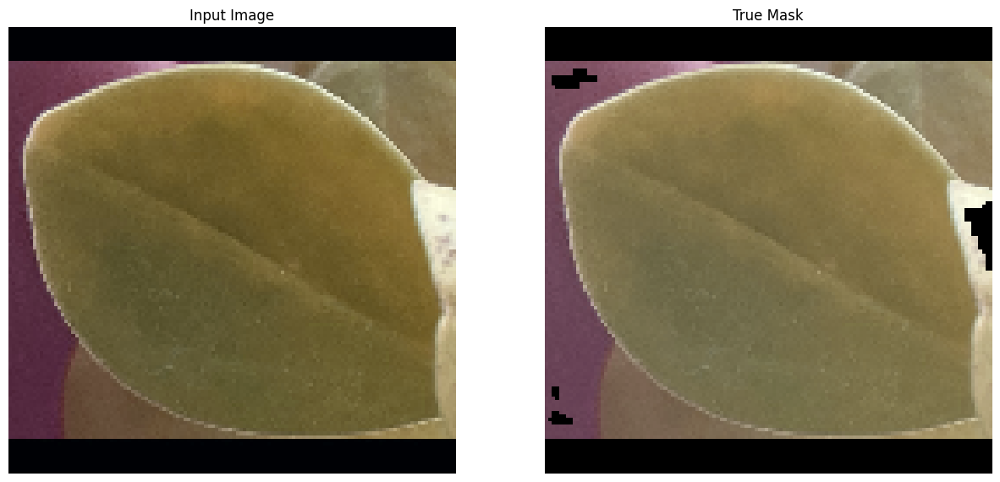

(128, 128, 3)
tf.Tensor(
[[[-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  ...
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]]

 [[-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  ...
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]]

 [[-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  ...
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]]

 ...

 [[-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  ...
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.01882714 -0.01882714]
  [-0.01882714 -0.0

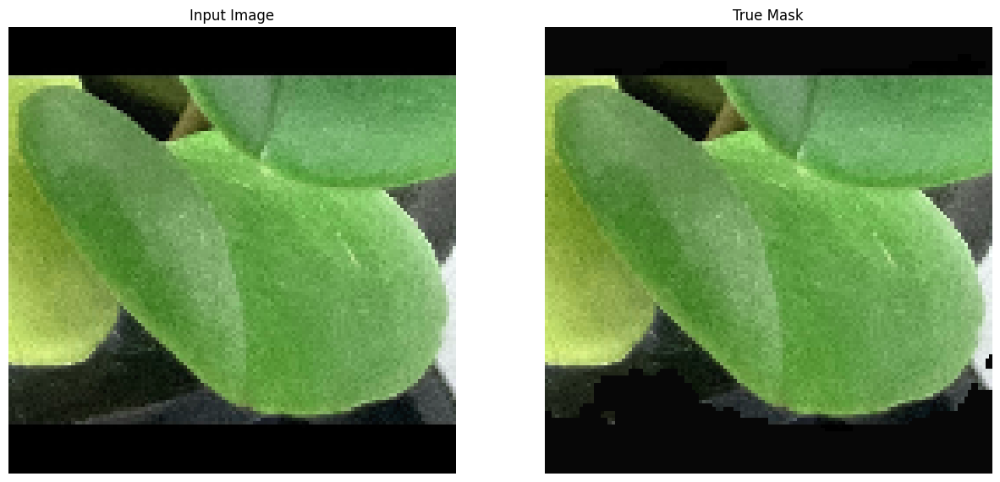

(128, 128, 3)
tf.Tensor(
[[[0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  ...
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]]

 [[0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  ...
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]]

 [[0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  ...
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]]

 ...

 [[0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  ...
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]
  [0.02432356 0.02365933 0.02507648]]

 [[0.02432356 0.02365933 0.02507648]
  [0.0243235

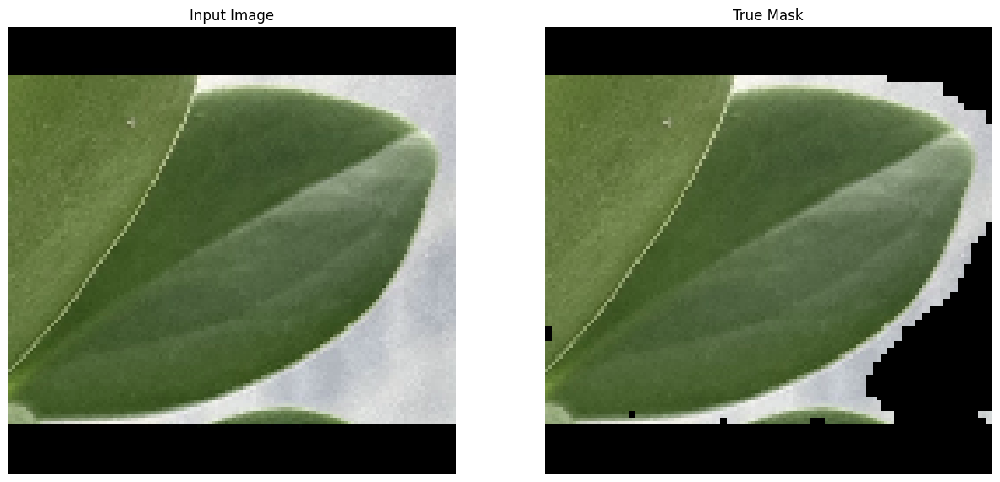

(128, 128, 3)
tf.Tensor(
[[[-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  ...
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]]

 [[-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  ...
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]]

 [[-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  ...
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]]

 ...

 [[-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  ...
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.15107358 -0.15107358]
  [-0.15107358 -0.1

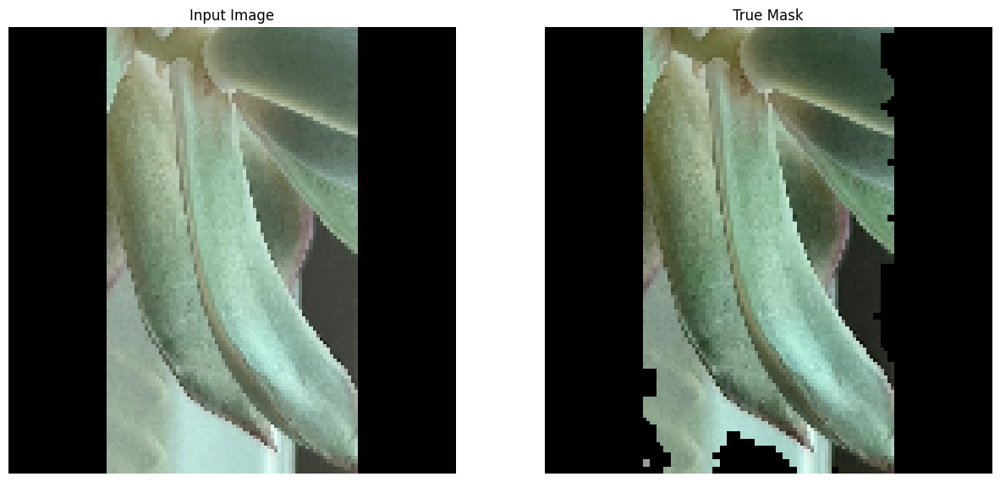

(128, 128, 3)
tf.Tensor(
[[[0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  ...
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]]

 [[0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  ...
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]]

 [[0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  ...
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]]

 ...

 [[0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  ...
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]
  [0.15824191 0.16732131 0.17160614]]

 [[0.15824191 0.16732131 0.17160614]
  [0.1582419

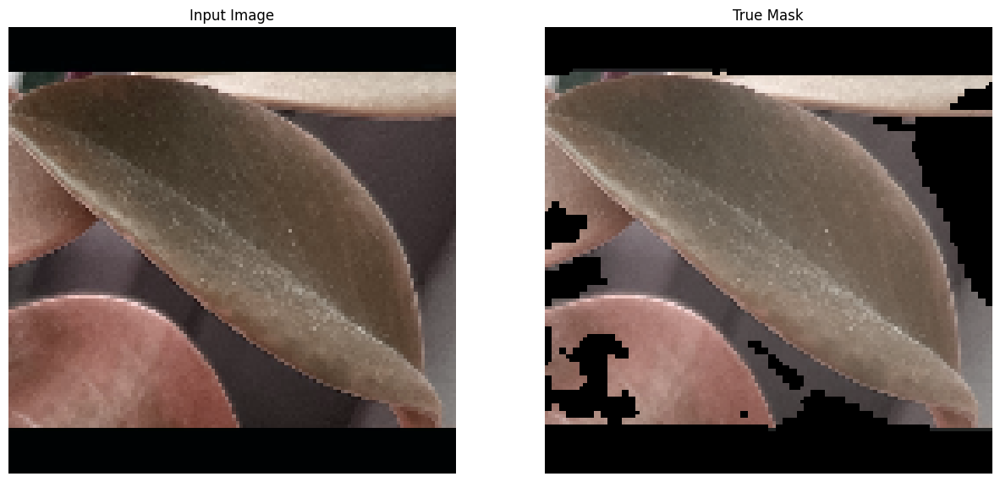

(128, 128, 3)
tf.Tensor(
[[[0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  ...
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]]

 [[0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  ...
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]]

 [[0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  ...
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]]

 ...

 [[0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  ...
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]
  [0.0304975  0.03051007 0.03063634]]

 [[0.0304975  0.03051007 0.03063634]
  [0.0304975

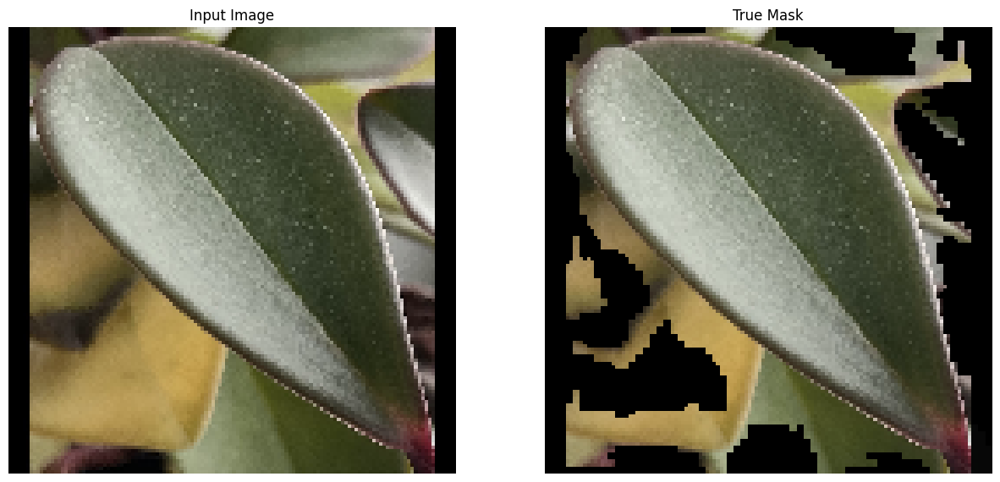

(128, 128, 3)
tf.Tensor(
[[[-0.10467589 -0.10467589 -0.10467589]
  [-0.10467589 -0.10467589 -0.10467589]
  [-0.10126799 -0.10126799 -0.10126799]
  ...
  [-0.10467589 -0.10467589 -0.10467589]
  [-0.10467589 -0.10467589 -0.10467589]
  [-0.10467589 -0.10467589 -0.10467589]]

 [[ 0.41673353  0.39208594  0.11053109]
  [ 0.46785212  0.4594713   0.20296472]
  [ 0.46079782  0.46785212  0.23050816]
  ...
  [ 0.32812804  0.31588846  0.05635479]
  [ 0.3247201   0.3124805   0.0529469 ]
  [ 0.32812804  0.31588846  0.05635479]]

 [[ 0.43377307  0.3934244   0.12412769]
  [ 0.4576284   0.43698943  0.18929812]
  [ 0.4823429   0.48829955  0.26128435]
  ...
  [ 0.3179043   0.2929907   0.0358023 ]
  [ 0.3247201   0.30366528  0.04950395]
  [ 0.3179043   0.291893    0.04613107]]

 ...

 [[ 0.39628613  0.38763934  0.15549923]
  [ 0.47807583  0.46942908  0.23728895]
  [ 0.47807583  0.46942908  0.23728895]
  ...
  [ 0.29404896  0.260736    0.01538989]
  [ 0.29064107  0.2573281   0.01198199]
  [ 0.28041732  0.2

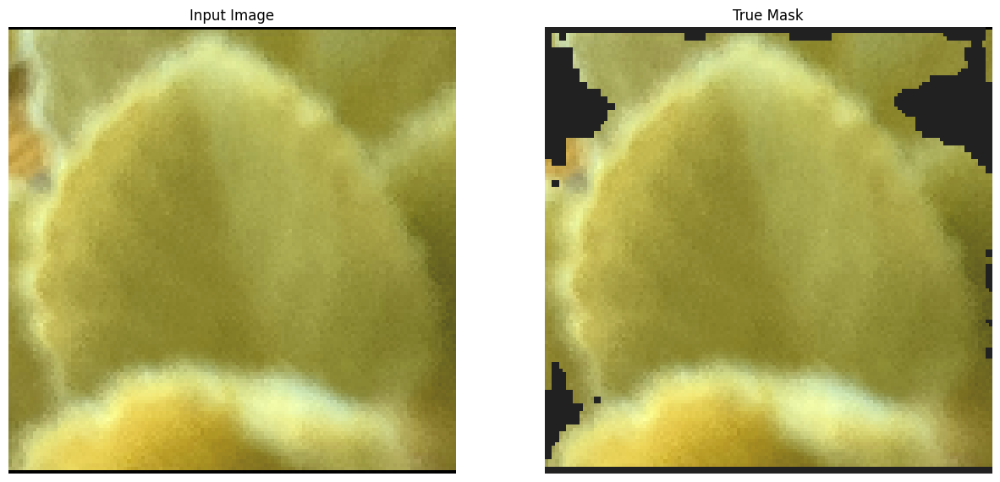

(128, 128, 3)
tf.Tensor(
[[[-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]
  ...
  [-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]]

 [[-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]
  ...
  [-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]
  [-0.14736882 -0.14736882 -0.14736882]]

 [[ 0.39501205  0.3494571   0.34399515]
  [ 0.43505567  0.37674662  0.37978673]
  [ 0.46417832  0.40951538  0.4210658 ]
  ...
  [ 0.49315676  0.5843377   0.54981506]
  [ 0.48222998  0.57705706  0.54375255]
  [ 0.52955425  0.62438136  0.5910768 ]]

 ...

 [[-0.01631689 -0.01631689 -0.01631689]
  [ 0.          0.04192838  0.03560271]
  [-0.01631689 -0.01631689 -0.01631689]
  ...
  [ 0.4162109   0.38931537  0.36583817]
  [ 0.35432526  0.3335038   0.30759865]
  [ 0.3142816   0.2

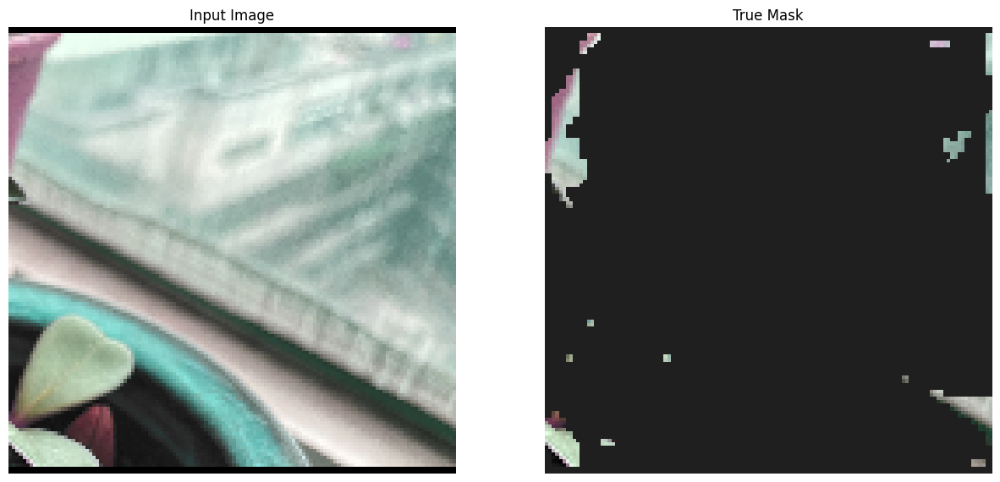

(128, 128, 3)
tf.Tensor(
[[[-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  ...
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]]

 [[-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  ...
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]]

 [[-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  ...
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]]

 ...

 [[-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  ...
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.10974744 -0.10974744]
  [-0.10974744 -0.1

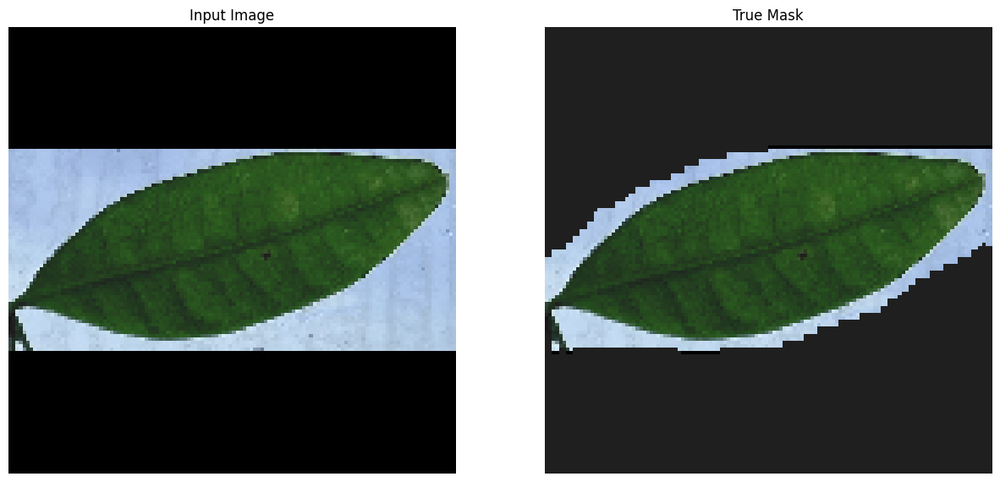

(128, 128, 3)
tf.Tensor(
[[[-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  ...
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]]

 [[-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  ...
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]]

 [[-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  ...
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]]

 ...

 [[-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  ...
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.09244162 -0.09244162]
  [-0.09244162 -0.0

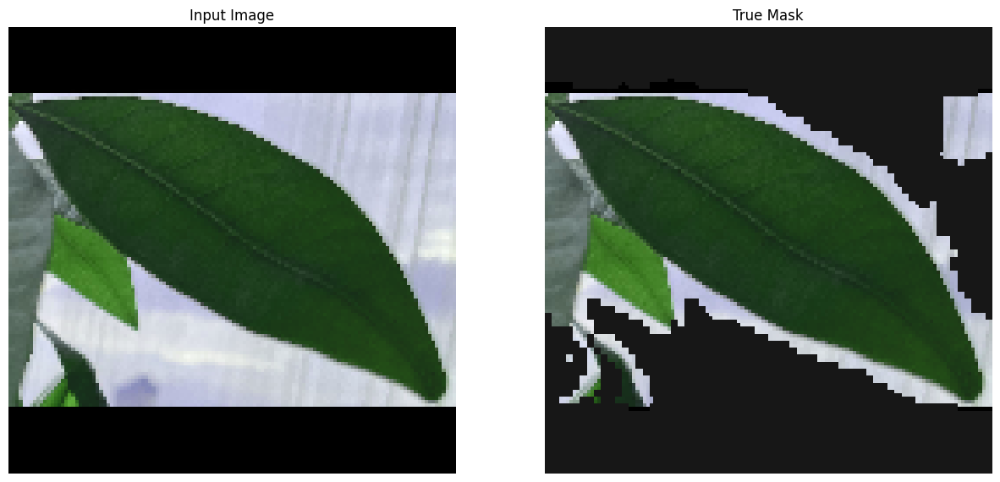

(128, 128, 3)
tf.Tensor(
[[[0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  ...
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]]

 [[0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  ...
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]]

 [[0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  ...
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]]

 ...

 [[0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  ...
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]
  [0.07743151 0.09328152 0.09888151]]

 [[0.07743151 0.09328152 0.09888151]
  [0.0774315

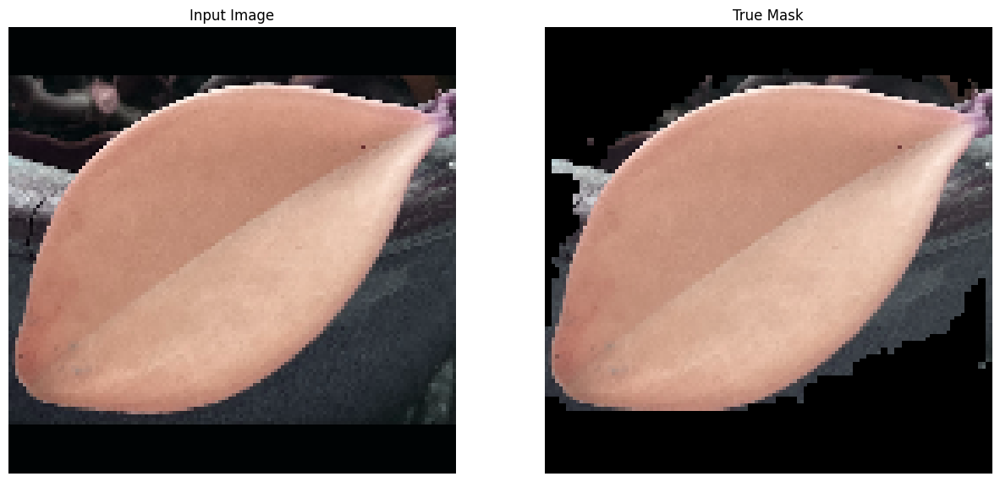

(128, 128, 3)
tf.Tensor(
[[[0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  ...
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]]

 [[0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  ...
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]]

 [[0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  ...
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]]

 ...

 [[0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  ...
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]
  [0.07408777 0.06043627 0.04467088]]

 [[0.07408777 0.06043627 0.04467088]
  [0.0740877

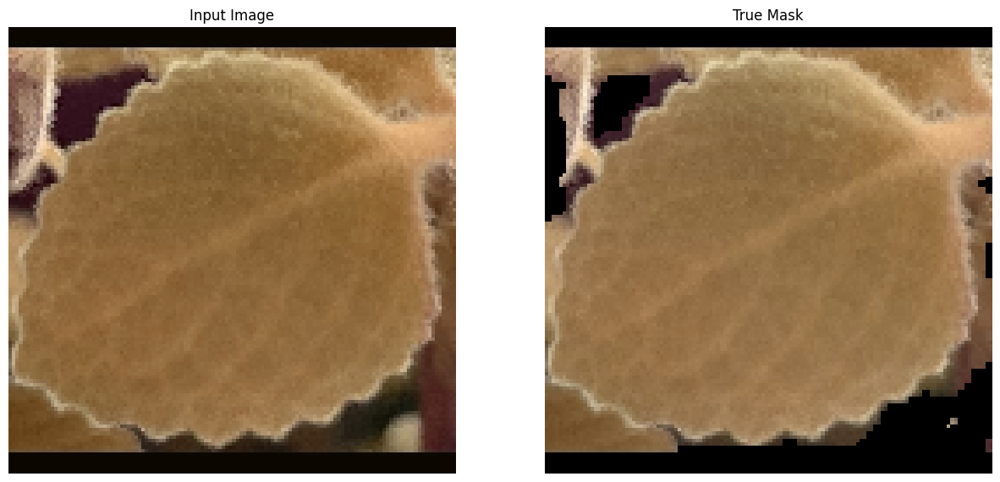

(128, 128, 3)
tf.Tensor(
[[[-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  ...
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]]

 [[-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  ...
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]]

 [[-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  ...
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]]

 ...

 [[-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  ...
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.17716295 -0.17716295]
  [-0.17716295 -0.1

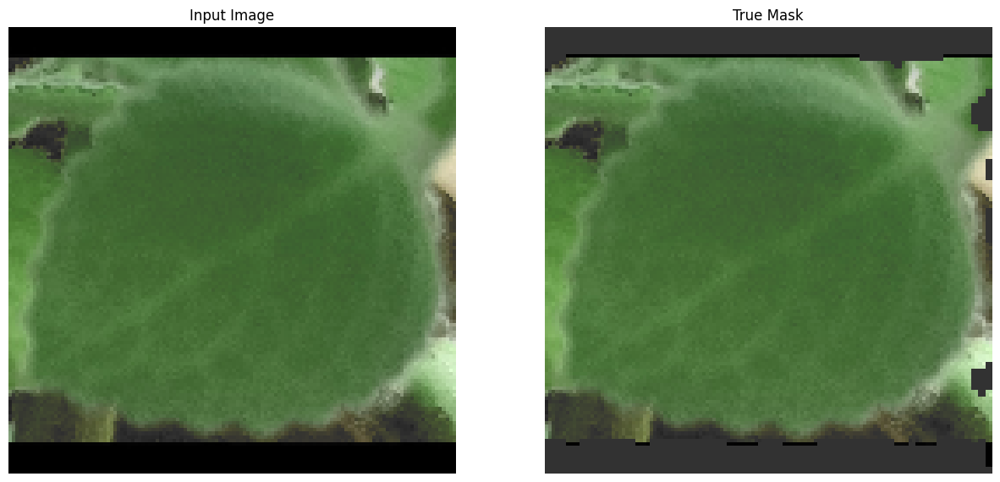

(128, 128, 3)
tf.Tensor(
[[[0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  ...
  [0.13093786 0.13923484 0.1336489 ]
  [0.13099898 0.13967541 0.13966894]
  [0.13093786 0.13923484 0.1336489 ]]

 [[0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  ...
  [0.13093786 0.13923484 0.1336489 ]
  [0.13099898 0.13967541 0.13966894]
  [0.13093786 0.13923484 0.1336489 ]]

 [[0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  ...
  [0.13093786 0.13923484 0.1336489 ]
  [0.13099898 0.13967541 0.13966894]
  [0.13093786 0.13923484 0.1336489 ]]

 ...

 [[0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  [0.13093786 0.13923484 0.1336489 ]
  ...
  [0.13093786 0.13923484 0.1336489 ]
  [0.13099898 0.13967541 0.13966894]
  [0.13093786 0.13923484 0.1336489 ]]

 [[0.13093786 0.13923484 0.1336489 ]
  [0.1309378

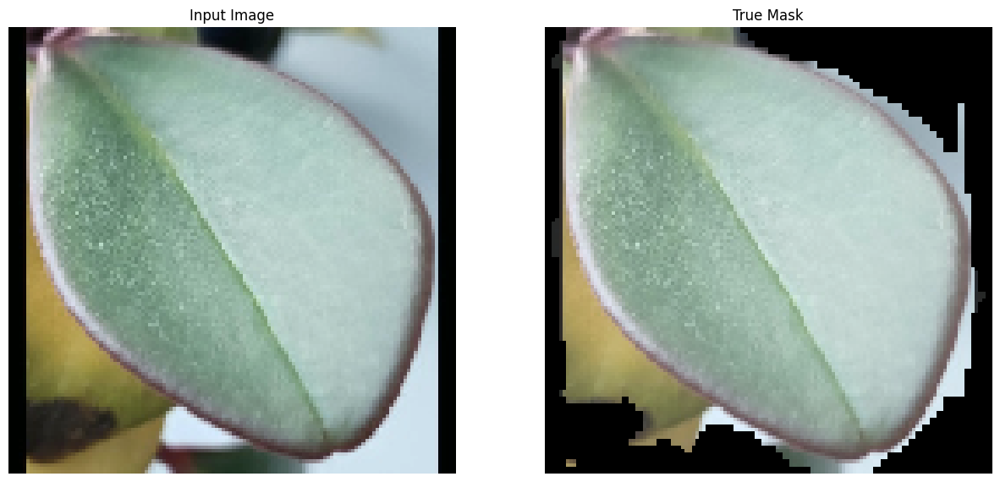

(128, 128, 3)
tf.Tensor(
[[[0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  ...
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]]

 [[0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  ...
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]]

 [[0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  ...
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]]

 ...

 [[0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  ...
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]
  [0.19145754 0.19085766 0.18808345]]

 [[0.19145754 0.19085766 0.18808345]
  [0.1914575

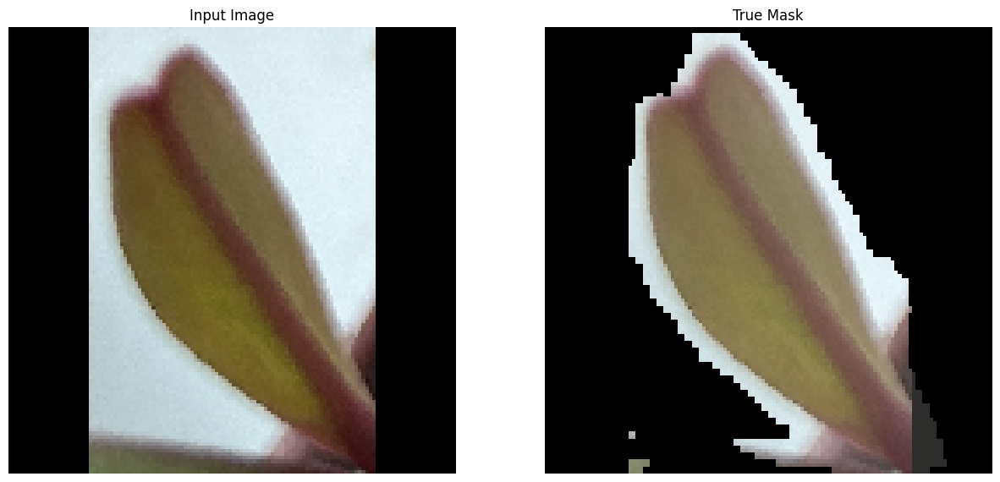

(128, 128, 3)
tf.Tensor(
[[[0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  ...
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]]

 [[0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  ...
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]]

 [[0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  ...
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]]

 ...

 [[0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  ...
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]
  [0.13638031 0.13086936 0.12793161]]

 [[0.13638031 0.13086936 0.12793161]
  [0.1363803

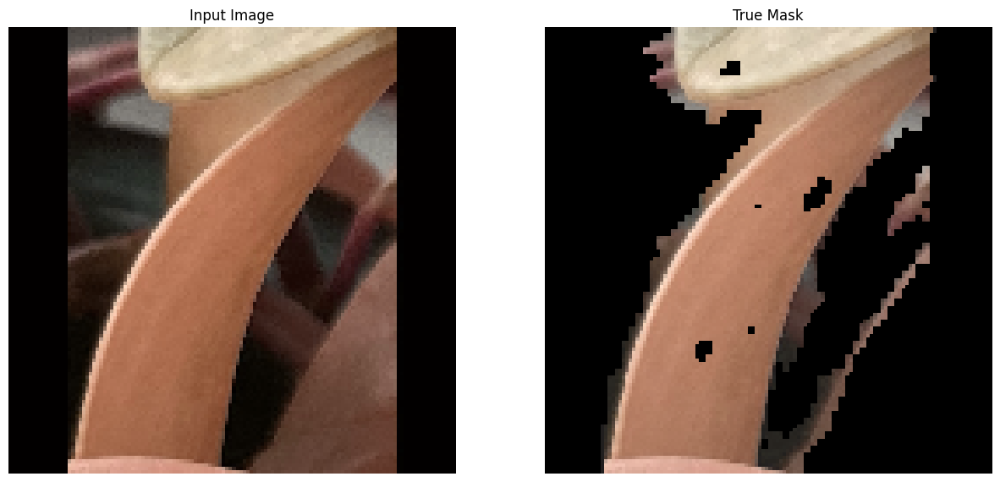

(128, 128, 3)
tf.Tensor(
[[[0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  ...
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]]

 [[0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  ...
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]]

 [[0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  ...
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]]

 ...

 [[0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  ...
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]
  [0.08803973 0.0838019  0.08626764]]

 [[0.08803973 0.0838019  0.08626764]
  [0.0880397

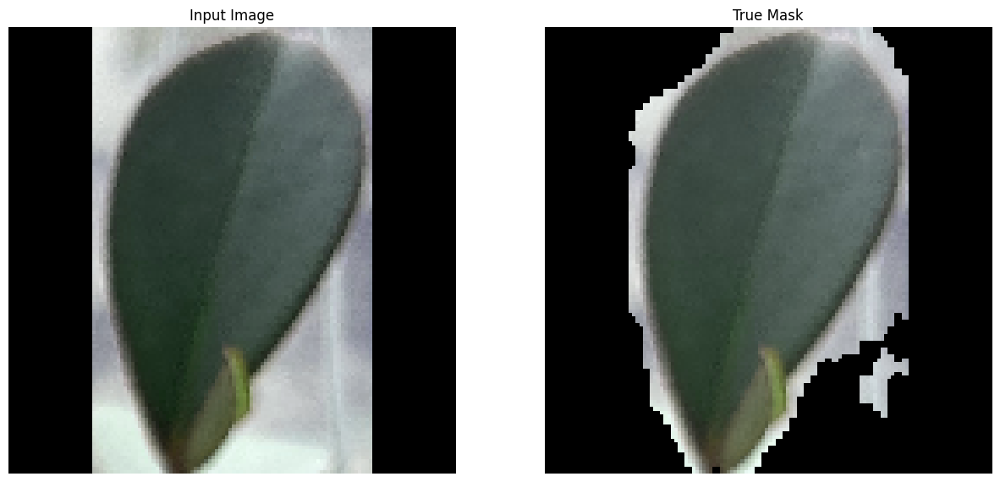

(128, 128, 3)
tf.Tensor(
[[[0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  ...
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]]

 [[0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  ...
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]]

 [[0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  ...
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]]

 ...

 [[0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]
  ...
  [0.14127007 0.14383018 0.13686892]
  [0.13723025 0.14264148 0.1367791 ]
  [0.13723025 0.14264148 0.1367791 ]]

 [[0.13723025 0.14264148 0.1367791 ]
  [0.1372302

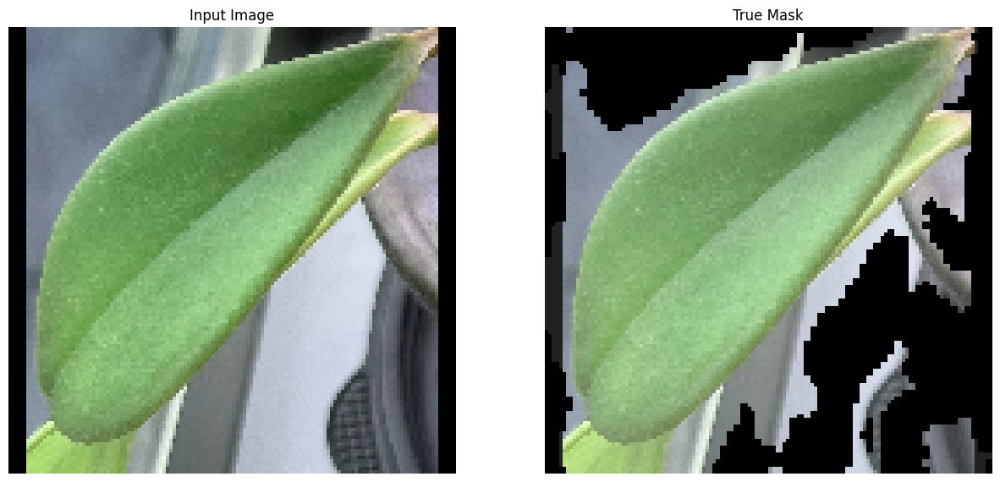

(128, 128, 3)
tf.Tensor(
[[[0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  ...
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]]

 [[0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  ...
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]]

 [[0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  ...
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]]

 ...

 [[0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  ...
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]
  [0.08698323 0.07577589 0.08727047]]

 [[0.08698323 0.07577589 0.08727047]
  [0.0869832

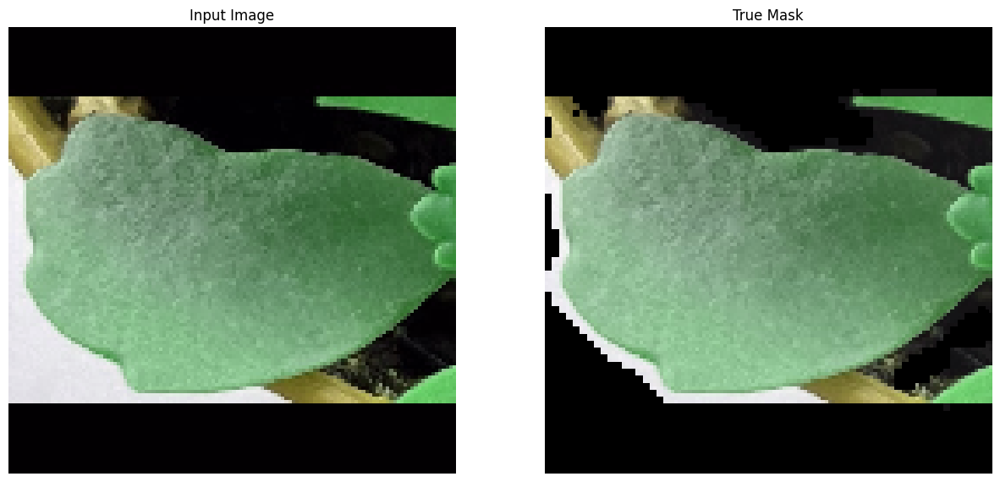

(128, 128, 3)
tf.Tensor(
[[[-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  ...
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]]

 [[-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  ...
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]]

 [[-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  ...
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]]

 ...

 [[-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  ...
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.04366836 -0.04366836]
  [-0.04366836 -0.0

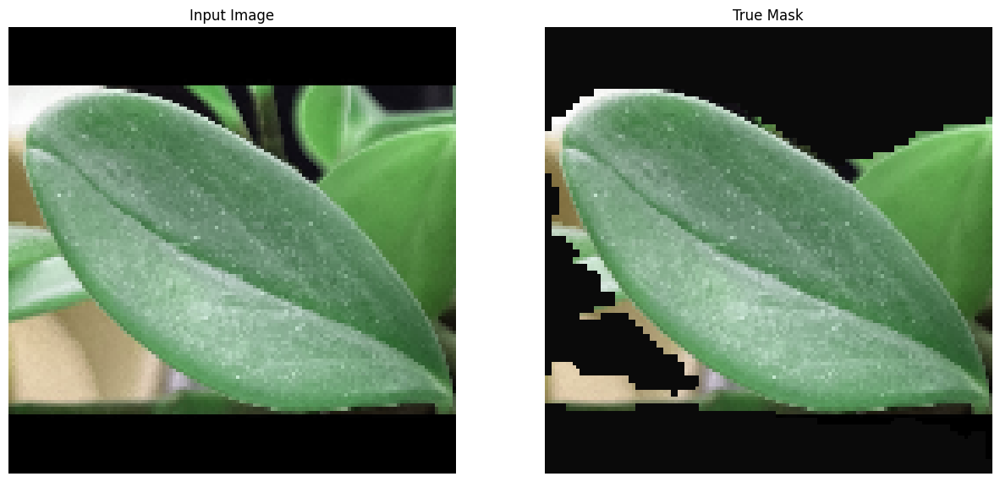

(128, 128, 3)
tf.Tensor(
[[[0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  ...
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]]

 [[0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  ...
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]]

 [[0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  ...
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]]

 ...

 [[0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  ...
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]
  [0.00222131 0.         0.00368789]]

 [[0.00222131 0.         0.00368789]
  [0.0022213

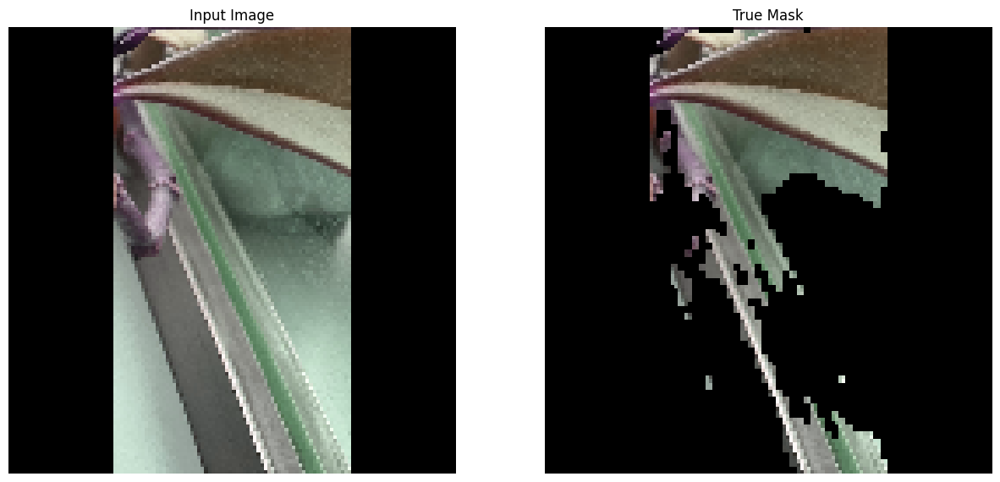

(128, 128, 3)
tf.Tensor(
[[[-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  ...
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]]

 [[-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  ...
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]]

 [[-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  ...
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]]

 ...

 [[-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  ...
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.13033196 -0.13033196]
  [-0.13033196 -0.1

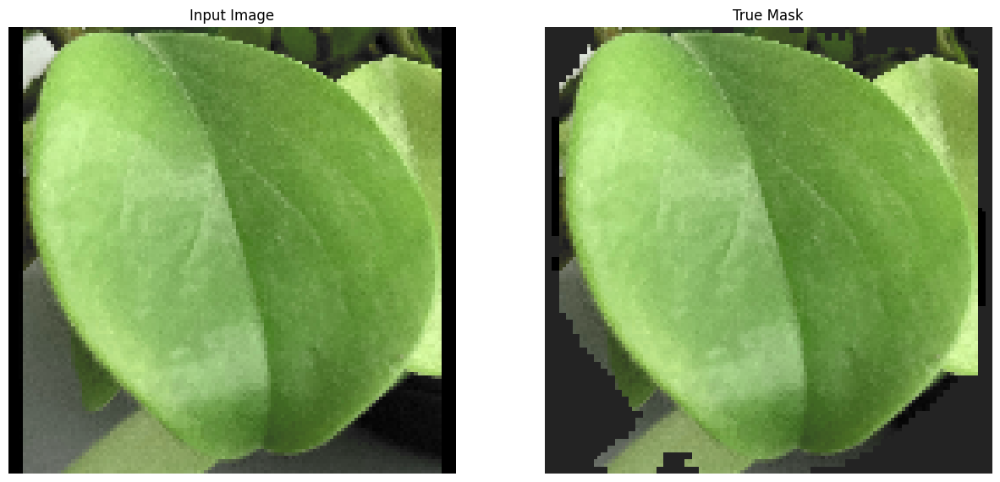

(128, 128, 3)
tf.Tensor(
[[[-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  ...
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]]

 [[-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  ...
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]]

 [[-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  ...
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]]

 ...

 [[-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  ...
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]
  [-0.1124467 -0.1124467 -0.1124467]]

 [[-0.1124467 -0.1124467 -0.1124467]
  [-0.112446

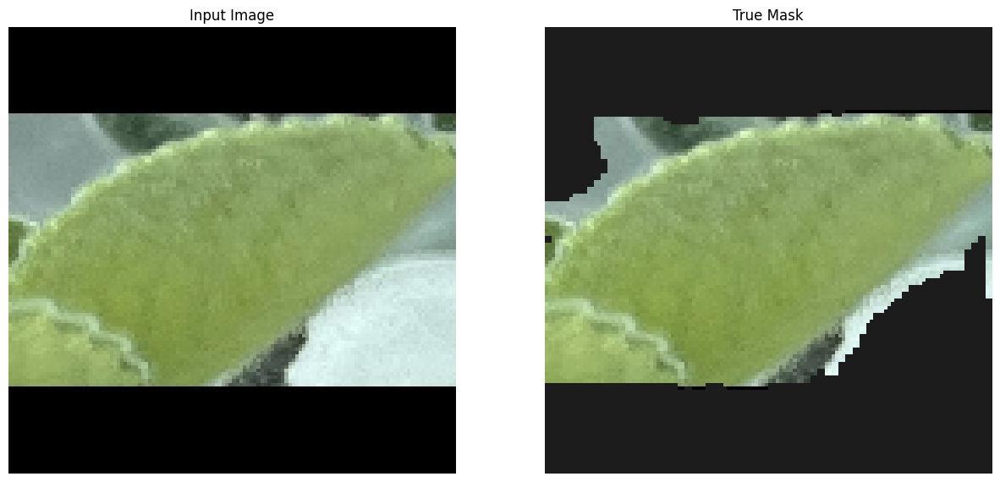

(128, 128, 3)
tf.Tensor(
[[[-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  ...
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]]

 [[-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  ...
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]]

 [[-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  ...
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]]

 ...

 [[-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  ...
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.10018051 -0.10018051]
  [-0.10018051 -0.1

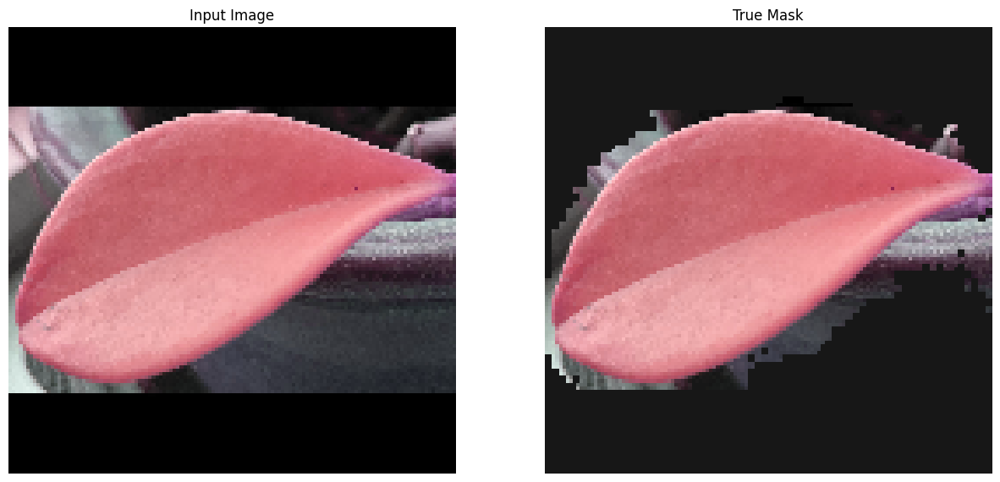

(128, 128, 3)
tf.Tensor(
[[[0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  ...
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]]

 [[0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  ...
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]]

 [[0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  ...
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]]

 ...

 [[0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  ...
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]
  [0.08210954 0.07131241 0.06335061]]

 [[0.08210954 0.07131241 0.06335061]
  [0.0821095

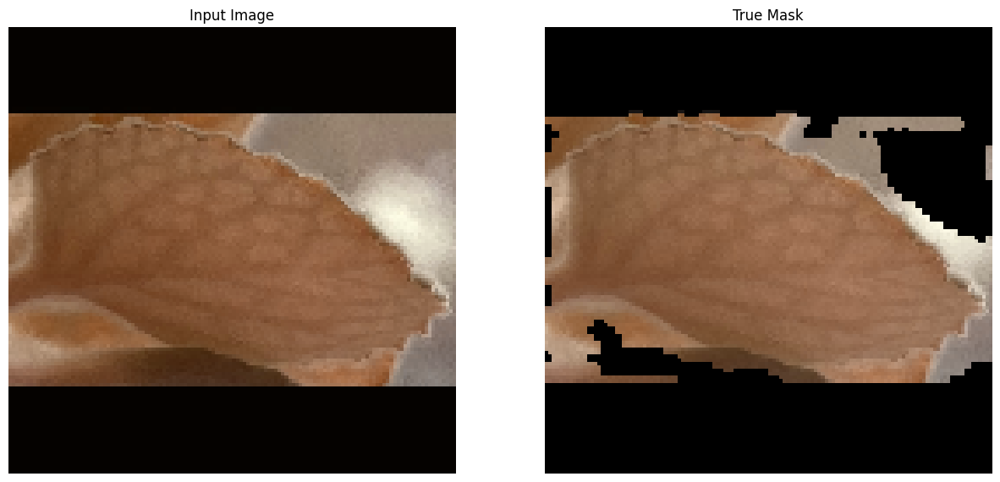

(128, 128, 3)
tf.Tensor(
[[[0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  ...
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]]

 [[0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  ...
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]]

 [[0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  ...
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]]

 ...

 [[0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  ...
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]
  [0.1860865  0.18666463 0.18415222]]

 [[0.1860865  0.18666463 0.18415222]
  [0.1860865

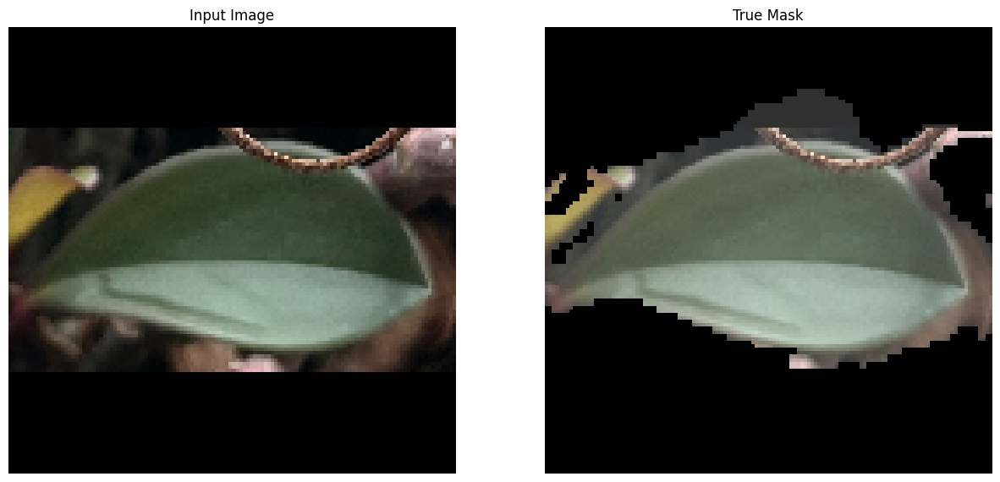

(128, 128, 3)
tf.Tensor(
[[[0.05998113 0.05822547 0.08041522]
  [0.5050965  0.5399973  0.33144087]
  [0.52600586 0.55840904 0.3570634 ]
  ...
  [0.42936352 0.4617474  0.35414243]
  [0.44821885 0.48476207 0.38076246]
  [0.06183086 0.06312665 0.08041522]]

 [[0.05998113 0.05822547 0.08041522]
  [0.47747892 0.5123797  0.30382323]
  [0.4937853  0.5261885  0.32484287]
  ...
  [0.4247606  0.45714447 0.34953946]
  [0.40679246 0.44333565 0.33933607]
  [0.06183086 0.06312665 0.08041522]]

 [[0.06414045 0.06183086 0.08041522]
  [0.49589062 0.5307914  0.322235  ]
  [0.47537348 0.50777674 0.3064311 ]
  ...
  [0.4339665  0.46635032 0.35874534]
  [0.40679246 0.44333565 0.33933607]
  [0.06339036 0.06805198 0.08041522]]

 ...

 [[0.05998113 0.05822547 0.08041522]
  [0.51718235 0.54460025 0.31080592]
  [0.56781465 0.5952325  0.3614382 ]
  ...
  [0.5183782  0.5307914  0.43400267]
  [0.49730712 0.50777674 0.42180422]
  [0.06414045 0.06183086 0.08041522]]

 [[0.05998113 0.05822547 0.08041522]
  [0.5580548

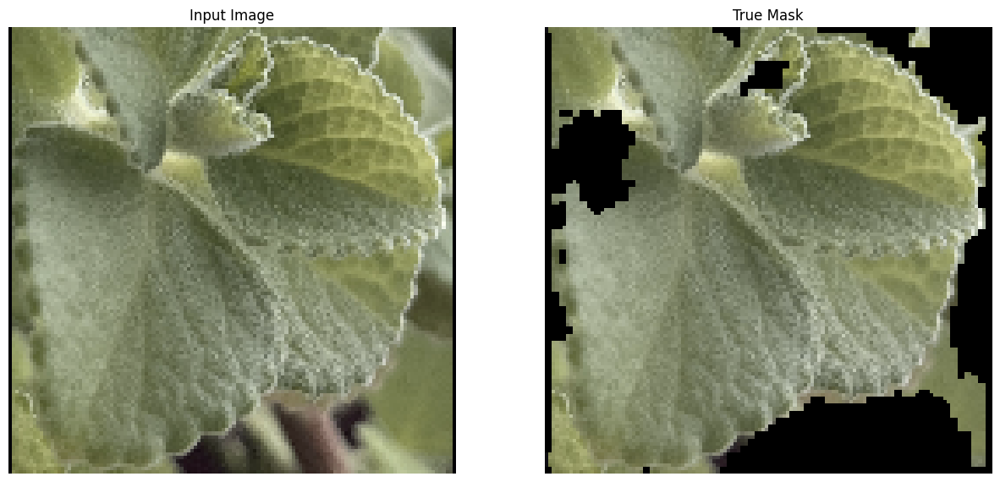

(128, 128, 3)
tf.Tensor(
[[[-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  ...
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]]

 [[-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  ...
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]]

 [[-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  ...
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]]

 ...

 [[-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  ...
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.00183228 -0.00183228]
  [-0.00183228 -0.0

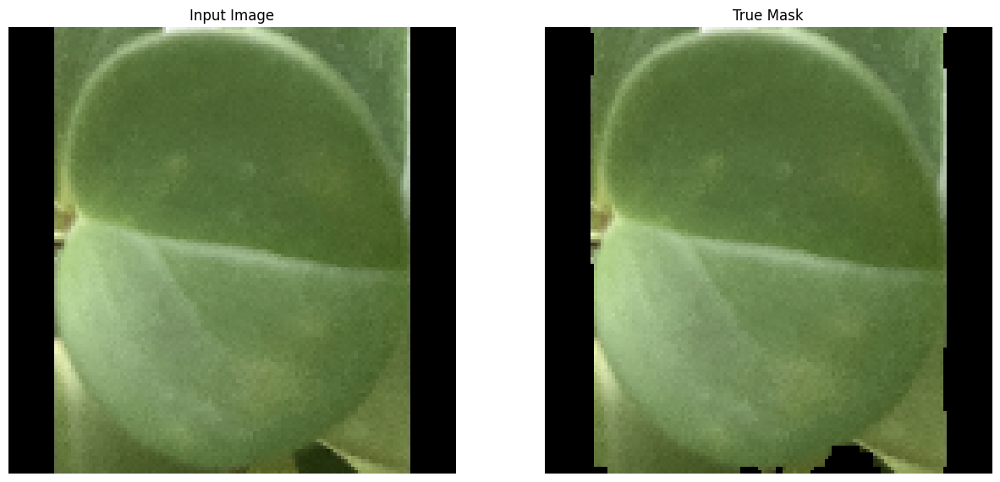

(128, 128, 3)
tf.Tensor(
[[[-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  ...
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]]

 [[-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  ...
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]]

 [[-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  ...
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]]

 ...

 [[-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  ...
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.09406117 -0.09406117]
  [-0.09406117 -0.0

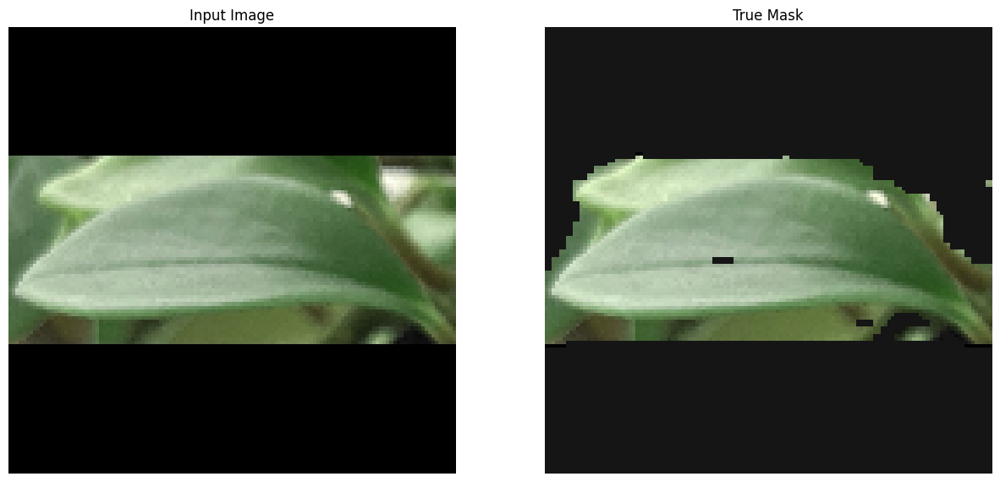

(128, 128, 3)
tf.Tensor(
[[[-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  ...
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]]

 [[-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  ...
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]]

 [[-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  ...
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]]

 ...

 [[-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  ...
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.05657987 -0.05657987]
  [-0.05657987 -0.0

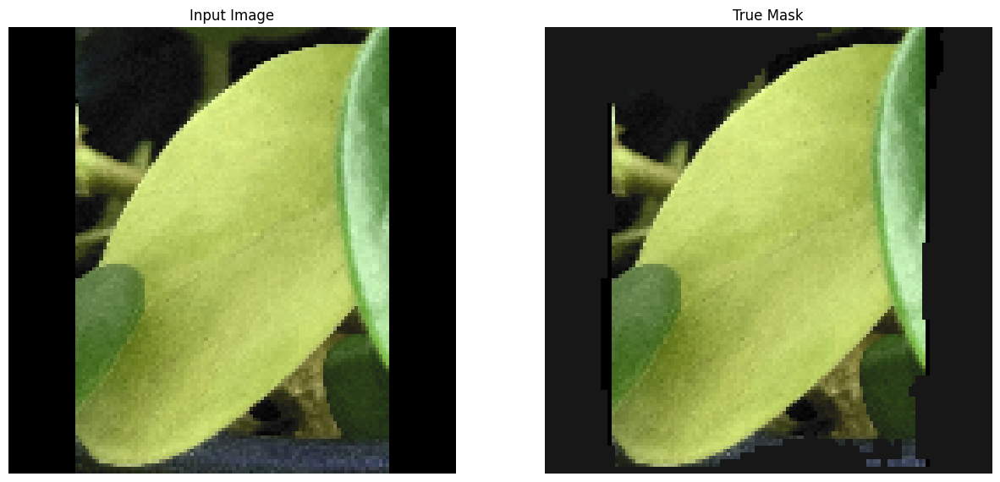

(128, 128, 3)
tf.Tensor(
[[[0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  ...
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]]

 [[0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  ...
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]]

 [[0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  ...
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]]

 ...

 [[0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  ...
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]
  [0.19890746 0.20653921 0.20022513]]

 [[0.19890746 0.20653921 0.20022513]
  [0.1989074

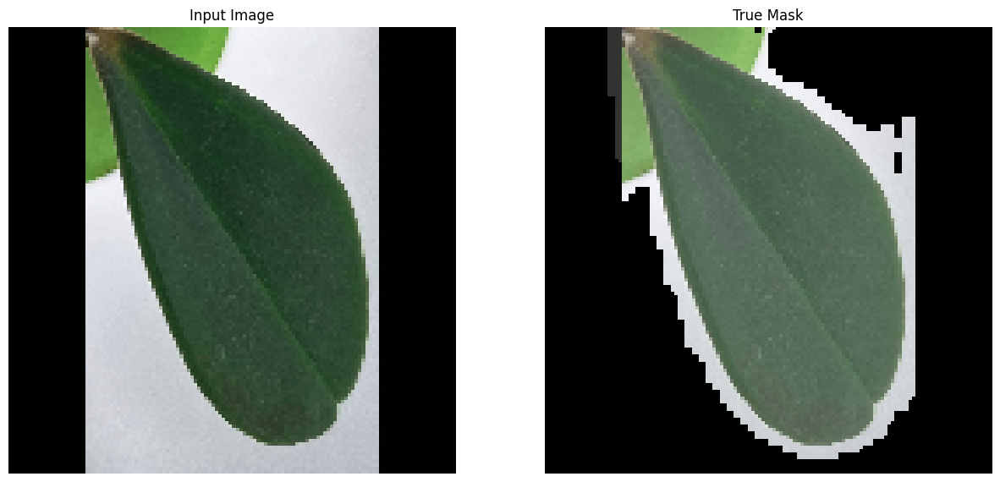

(128, 128, 3)
tf.Tensor(
[[[-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  ...
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]]

 [[-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  ...
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]]

 [[-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  ...
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]]

 ...

 [[-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  ...
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]
  [-0.0450744 -0.0450744 -0.0450744]]

 [[-0.0450744 -0.0450744 -0.0450744]
  [-0.045074

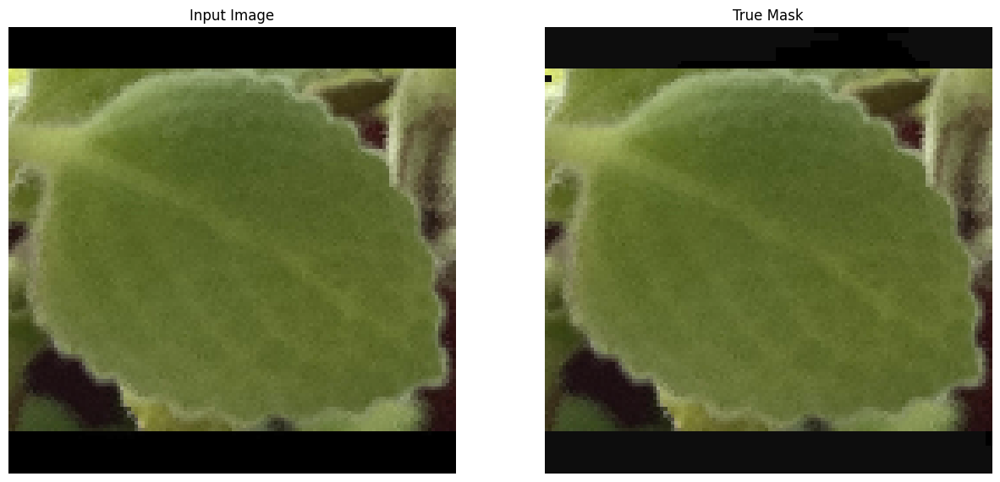

(128, 128, 3)
tf.Tensor(
[[[0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  ...
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]]

 [[0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  ...
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]]

 [[0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  ...
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]]

 ...

 [[0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  ...
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]
  [0.09086229 0.09144738 0.08845869]]

 [[0.09086229 0.09144738 0.08845869]
  [0.0908622

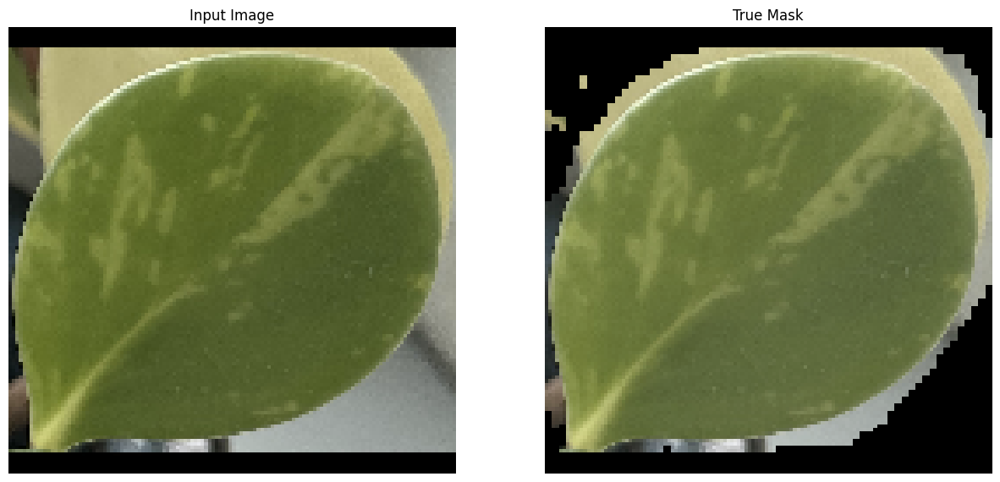

(128, 128, 3)
tf.Tensor(
[[[0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  ...
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]]

 [[0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  ...
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]]

 [[0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  ...
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]]

 ...

 [[0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  ...
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]
  [0.11595499 0.12538755 0.10913096]]

 [[0.11595499 0.12538755 0.10913096]
  [0.1159549

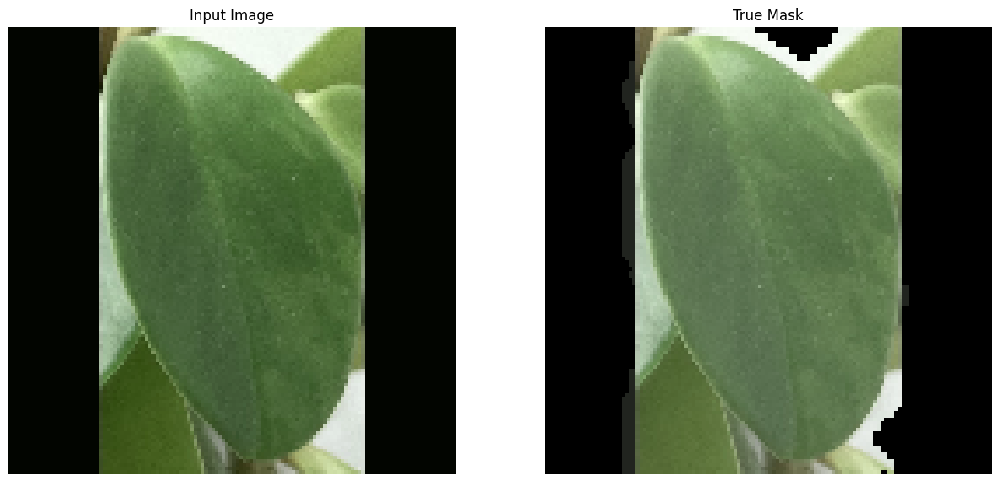

(128, 128, 3)
tf.Tensor(
[[[0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  ...
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]]

 [[0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  ...
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]]

 [[0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  ...
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]]

 ...

 [[0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  ...
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]
  [0.19360244 0.19209287 0.1834996 ]]

 [[0.19360244 0.19209287 0.1834996 ]
  [0.1936024

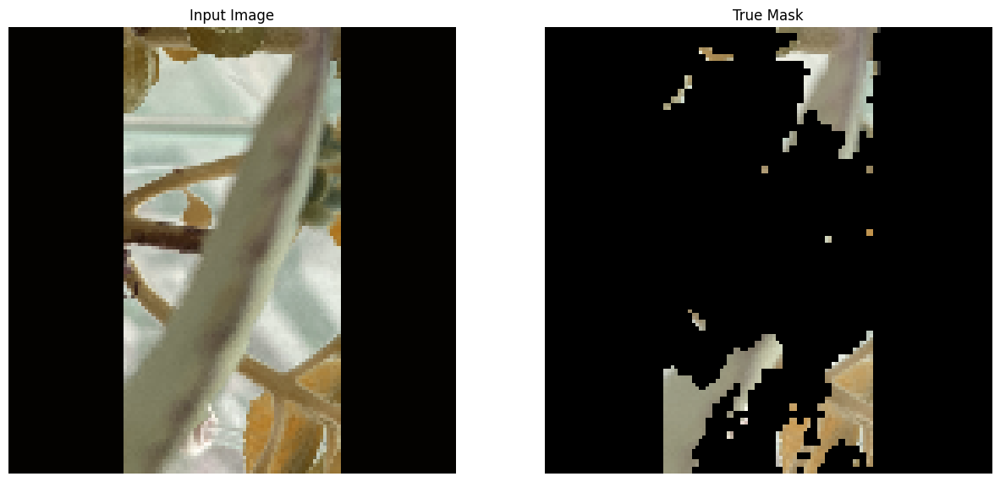

(128, 128, 3)
tf.Tensor(
[[[0.20645191 0.43368903 0.17157474]
  [0.21956347 0.4468006  0.1846863 ]
  [0.23811921 0.46646792 0.19884521]
  ...
  [0.46519592 0.65986353 0.43630815]
  [0.4869319  0.6631414  0.44234022]
  [0.42857486 0.5975836  0.39881605]]

 [[0.22084418 0.45663425 0.18625733]
  [0.19245484 0.42713323 0.16226473]
  [0.20556642 0.4402448  0.17537633]
  ...
  [0.41000986 0.6008615  0.35527247]
  [0.39690763 0.5648047  0.37154555]
  [0.54645044 0.6500299  0.5366428 ]]

 [[0.19661829 0.42385533 0.16174105]
  [0.19310701 0.41729957 0.16344786]
  [0.17343971 0.3976322  0.14378056]
  ...
  [0.3391863  0.5156363  0.31411457]
  [0.6326326  0.69919825 0.6643289 ]
  [0.6858043  0.7483666  0.7312162 ]]

 ...

 [[0.39095655 0.6074173  0.36458245]
  [0.365933   0.54513735 0.3436156 ]
  [0.2845738  0.45991215 0.26389882]
  ...
  [0.8227026  0.88931596 0.8089793 ]
  [0.8155588  0.88603806 0.800193  ]
  [0.8237572  0.89259386 0.80124044]]

 [[0.3280647  0.49924684 0.31700456]
  [0.2559510

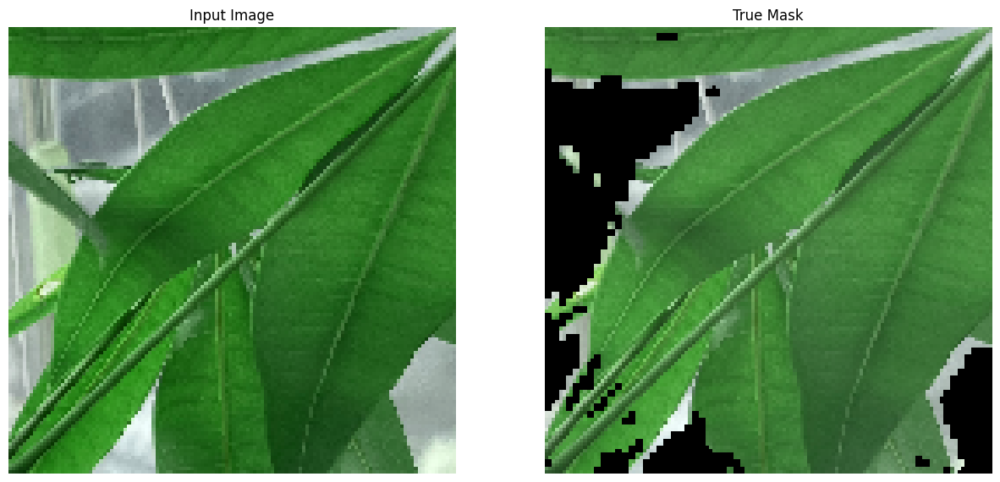

(128, 128, 3)
tf.Tensor(
[[[0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  ...
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]]

 [[0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  ...
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]]

 [[0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  ...
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]]

 ...

 [[0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  ...
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]
  [0.07260664 0.06704865 0.07891765]]

 [[0.07260664 0.06704865 0.07891765]
  [0.0726066

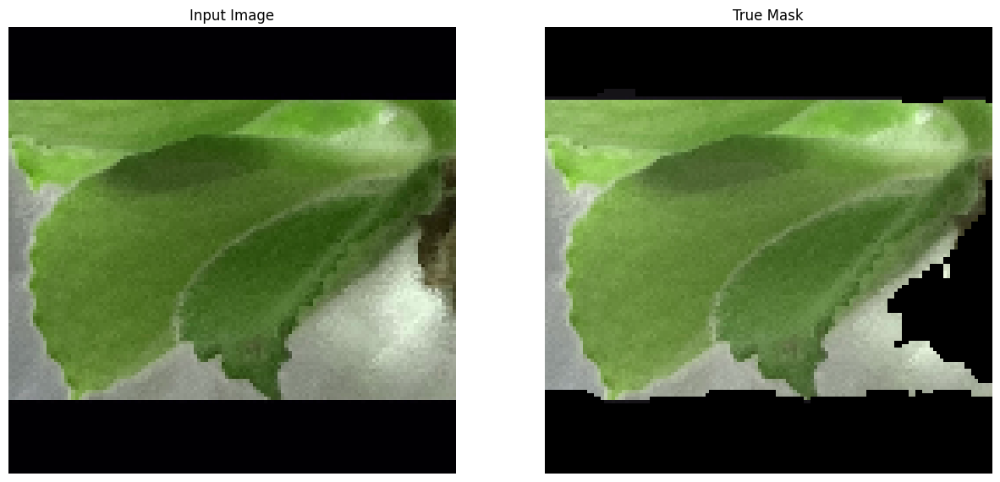

(128, 128, 3)
tf.Tensor(
[[[-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  ...
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]]

 [[-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  ...
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]]

 [[-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  ...
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]]

 ...

 [[-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  ...
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]
  [-0.1487226 -0.1487226 -0.1487226]]

 [[-0.1487226 -0.1487226 -0.1487226]
  [-0.148722

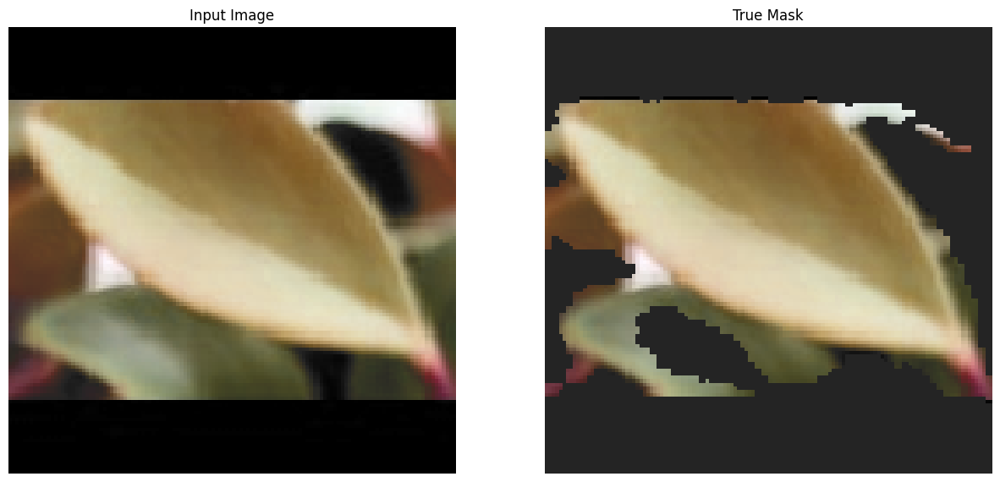

(128, 128, 3)
tf.Tensor(
[[[-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  ...
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]]

 [[-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  ...
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]]

 [[-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  ...
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]]

 ...

 [[-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  ...
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.20795728 -0.20795728]
  [-0.20795728 -0.2

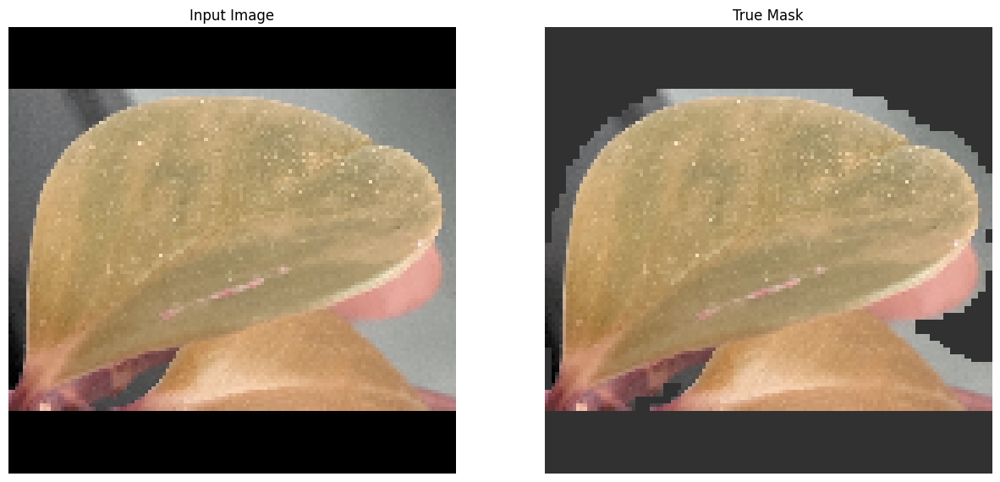

(128, 128, 3)
tf.Tensor(
[[[0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  ...
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]]

 [[0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  ...
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]]

 [[0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  ...
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]]

 ...

 [[0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  ...
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]
  [0.1133391  0.10973673 0.11991388]]

 [[0.1133391  0.10973673 0.11991388]
  [0.1133391

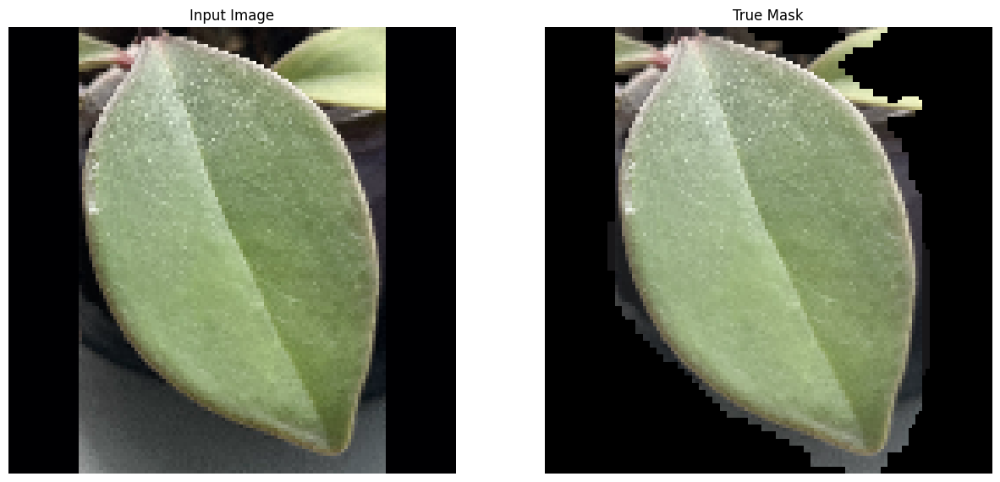

(128, 128, 3)
tf.Tensor(
[[[-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  ...
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]]

 [[-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  ...
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]]

 [[-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  ...
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]]

 ...

 [[-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  ...
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.01619563 -0.01619563]
  [-0.01619563 -0.0

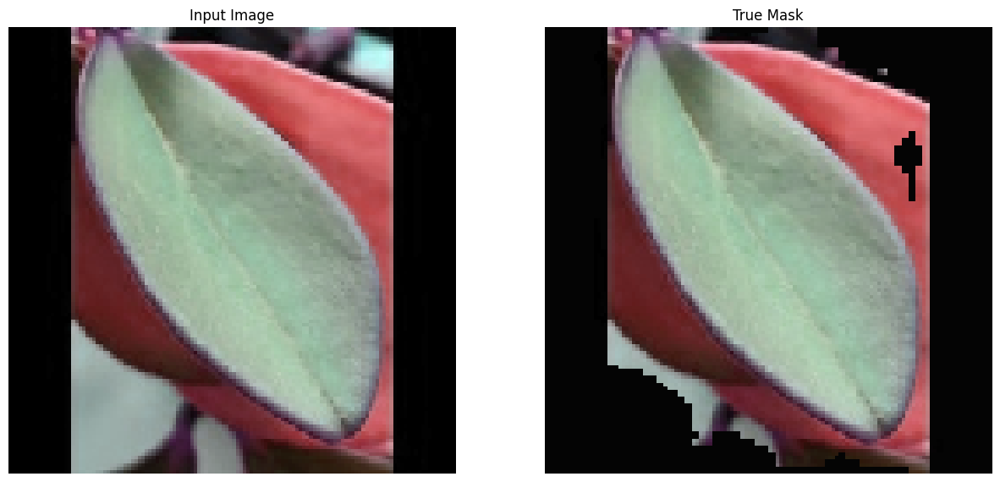

(128, 128, 3)
tf.Tensor(
[[[-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  ...
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]]

 [[-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  ...
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]]

 [[-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  ...
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]]

 ...

 [[-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  ...
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.11654654 -0.11654654]
  [-0.11654654 -0.1

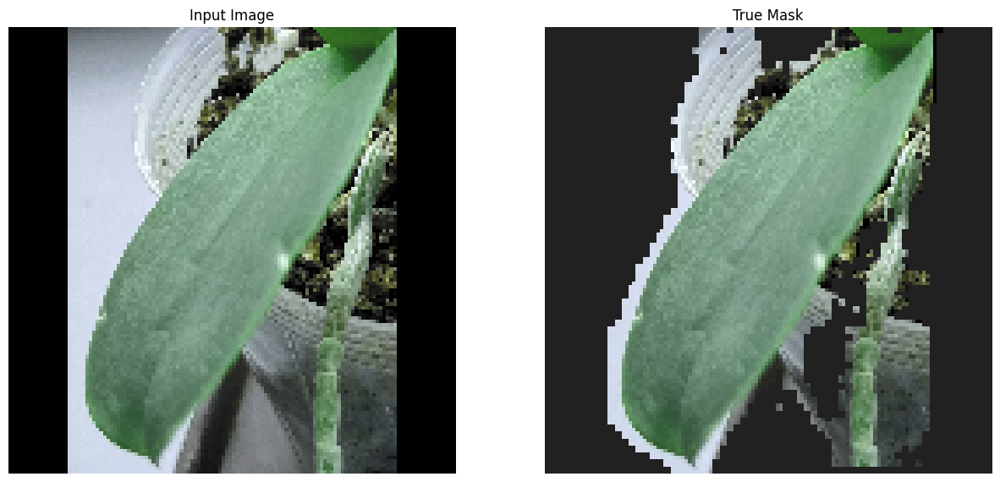

(128, 128, 3)
tf.Tensor(
[[[0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  ...
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]]

 [[0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  ...
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]]

 [[0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  ...
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]]

 ...

 [[0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  ...
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]
  [0.06740758 0.06529705 0.05790323]]

 [[0.06740758 0.06529705 0.05790323]
  [0.0674075

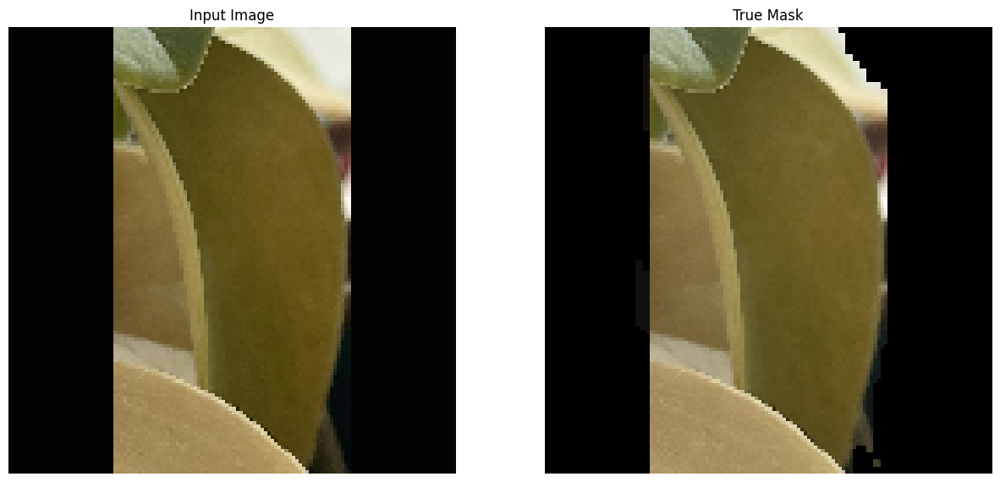

(128, 128, 3)
tf.Tensor(
[[[-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  ...
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]]

 [[-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  ...
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]]

 [[-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  ...
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]]

 ...

 [[-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  ...
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.10697088 -0.10697088]
  [-0.10697088 -0.1

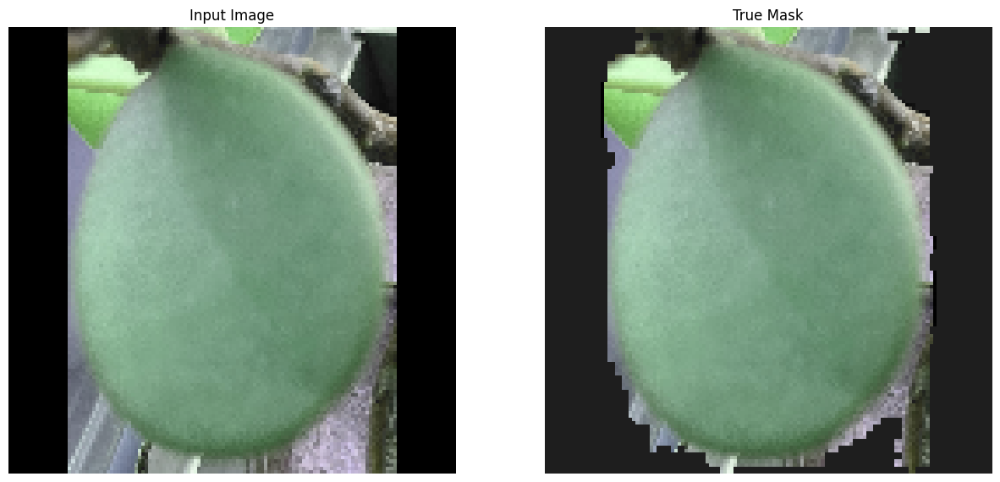

(128, 128, 3)
tf.Tensor(
[[[-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  ...
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]]

 [[-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  ...
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]]

 [[-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  ...
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]]

 ...

 [[-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  ...
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.01502568 -0.01502568]
  [-0.01502568 -0.0

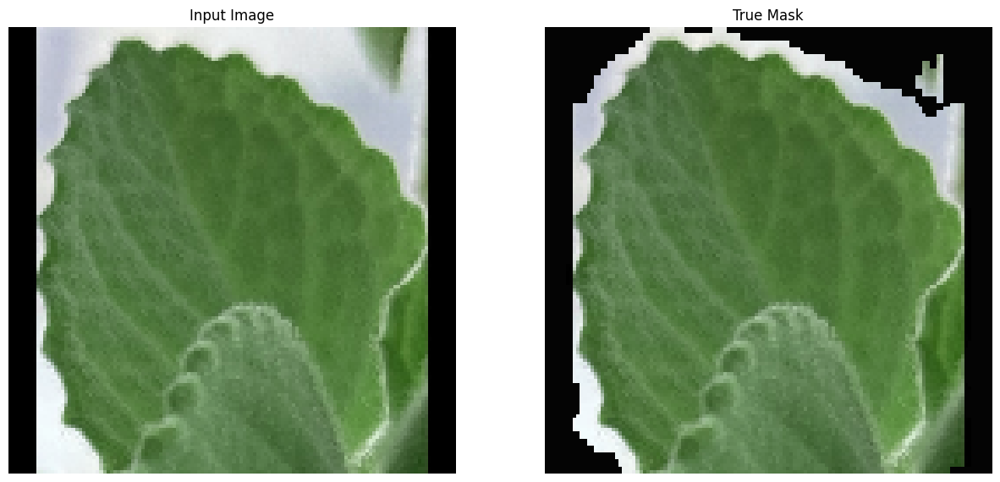

(128, 128, 3)
tf.Tensor(
[[[-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  ...
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]]

 [[-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  ...
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]]

 [[-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  ...
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]]

 ...

 [[-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  ...
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.22348267 -0.22348267]
  [-0.22348267 -0.2

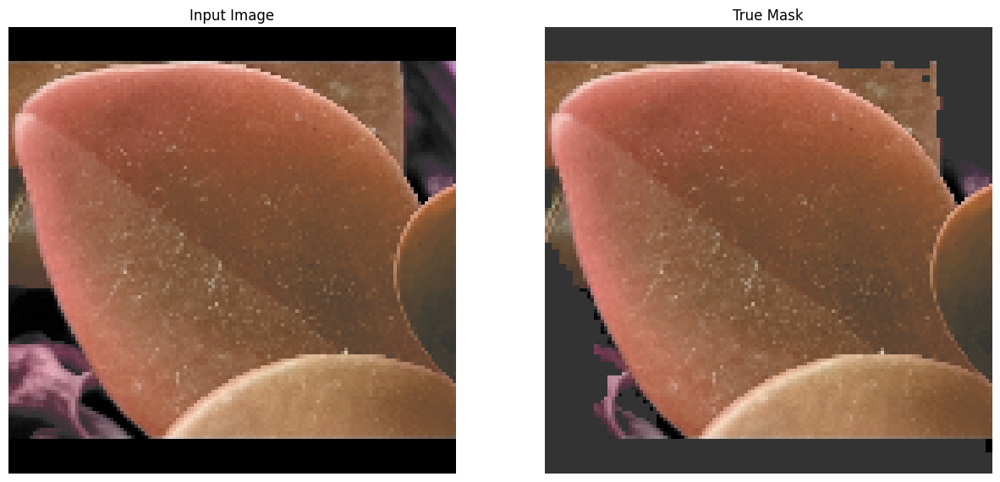

(128, 128, 3)
tf.Tensor(
[[[0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  ...
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]]

 [[0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  ...
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]]

 [[0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  ...
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]]

 ...

 [[0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  ...
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]
  [0.03126659 0.02560362 0.03157896]]

 [[0.03126659 0.02560362 0.03157896]
  [0.0312665

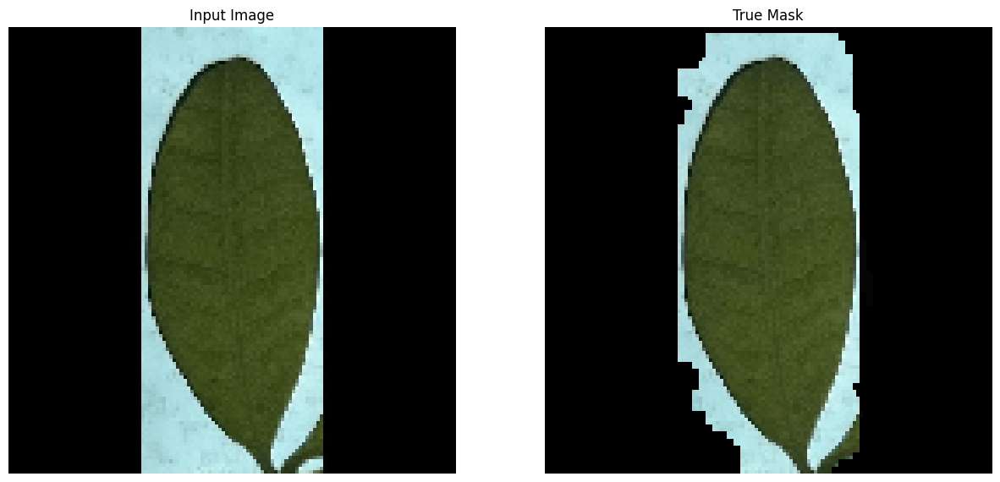

(128, 128, 3)
tf.Tensor(
[[[0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  ...
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]]

 [[0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  ...
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]]

 [[0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  ...
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]]

 ...

 [[0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  ...
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]
  [0.15667626 0.15655719 0.15388624]]

 [[0.15667626 0.15655719 0.15388624]
  [0.1566762

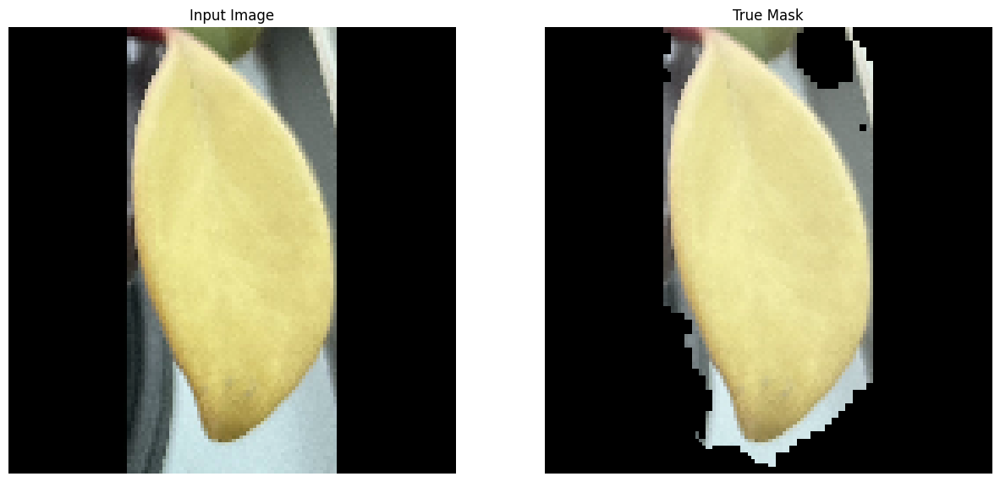

(128, 128, 3)
tf.Tensor(
[[[0.0487802  0.04538842 0.05620348]
  [0.92872846 0.9944807  0.9812225 ]
  [0.967343   1.0259062  1.0180883 ]
  ...
  [0.67891175 0.633811   0.5972904 ]
  [0.7295687  0.7174794  0.6505219 ]
  [0.0487802  0.04538842 0.05620348]]

 [[0.0487802  0.04538842 0.05620348]
  [0.9152603  0.9810126  0.96775436]
  [0.92693865 0.98550195 0.97768414]
  ...
  [0.66993296 0.62308383 0.5955006 ]
  [0.6744224  0.6455456  0.59999   ]
  [0.0487802  0.04538842 0.05620348]]

 [[0.0487802  0.04538842 0.05620348]
  [0.9152603  0.9810126  0.96775436]
  [0.9359174  0.99448067 0.98666286]
  ...
  [0.67891175 0.6510555  0.6224517 ]
  [0.63401806 0.6060643  0.5631802 ]
  [0.0487802  0.04538842 0.05620348]]

 ...

 [[0.04970322 0.04898294 0.05620348]
  [0.82099867 0.86877847 0.8673242 ]
  [0.8003416  0.8553104  0.85201013]
  ...
  [1.0095221  1.0895532  1.0932467 ]
  [0.9691178  1.0491489  1.0528425 ]
  [0.0487802  0.04538842 0.05620348]]

 [[0.04970322 0.04898294 0.05620348]
  [0.8209986

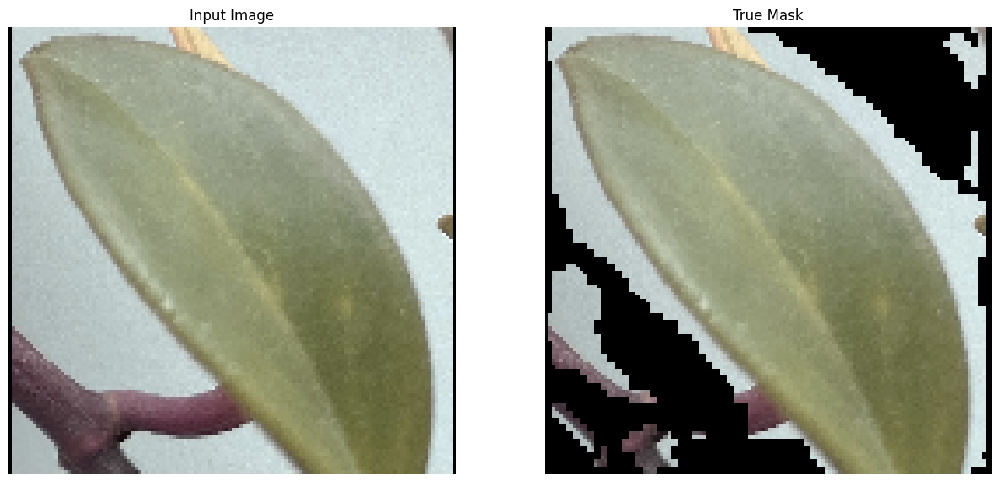

(128, 128, 3)
tf.Tensor(
[[[-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  ...
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]]

 [[-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  ...
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]]

 [[-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  ...
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]]

 ...

 [[-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  ...
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]
  [-0.0467951 -0.0467951 -0.0467951]]

 [[-0.0467951 -0.0467951 -0.0467951]
  [-0.046795

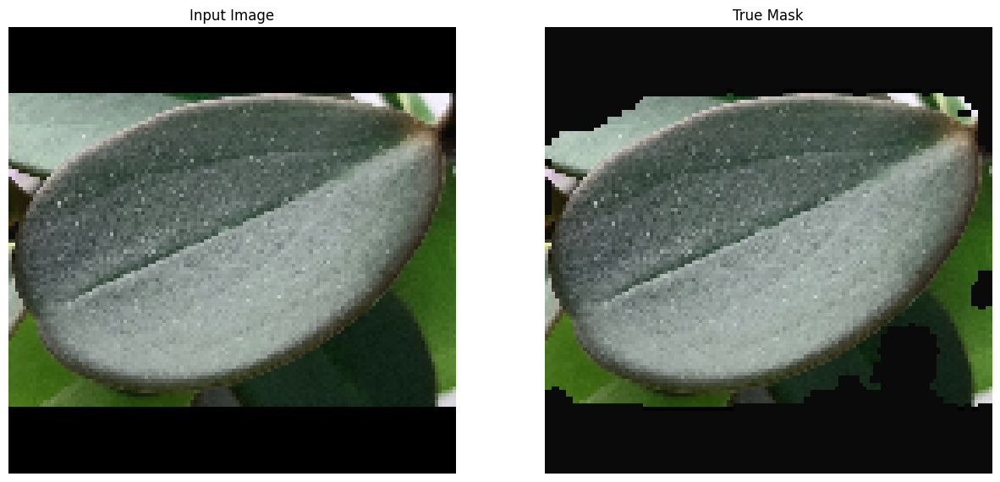

(128, 128, 3)
tf.Tensor(
[[[-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  ...
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]]

 [[-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  ...
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]]

 [[-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  ...
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]]

 ...

 [[-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  ...
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.08035959 -0.08035959]
  [-0.08035959 -0.0

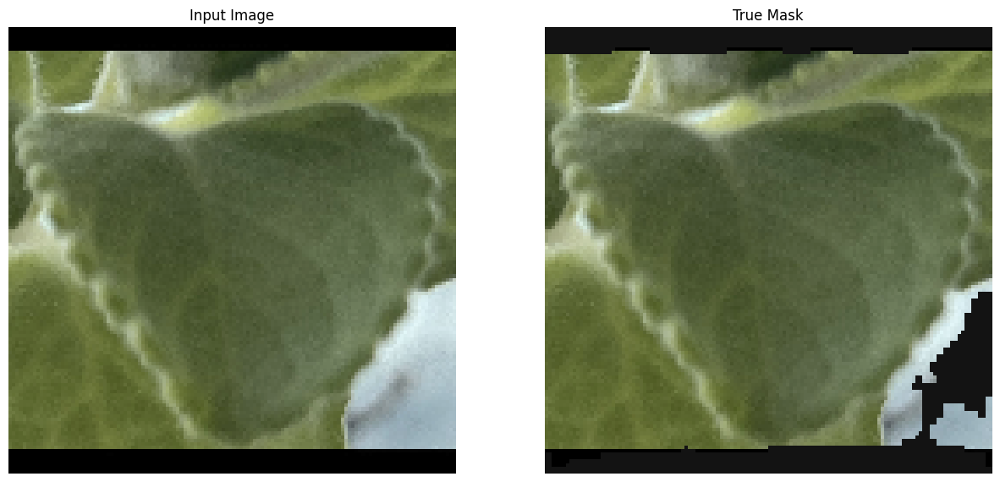

(128, 128, 3)
tf.Tensor(
[[[0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  ...
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]]

 [[0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  ...
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]]

 [[0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  ...
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]]

 ...

 [[0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  ...
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]
  [0.13477933 0.13332778 0.13765177]]

 [[0.13477933 0.13332778 0.13765177]
  [0.1347793

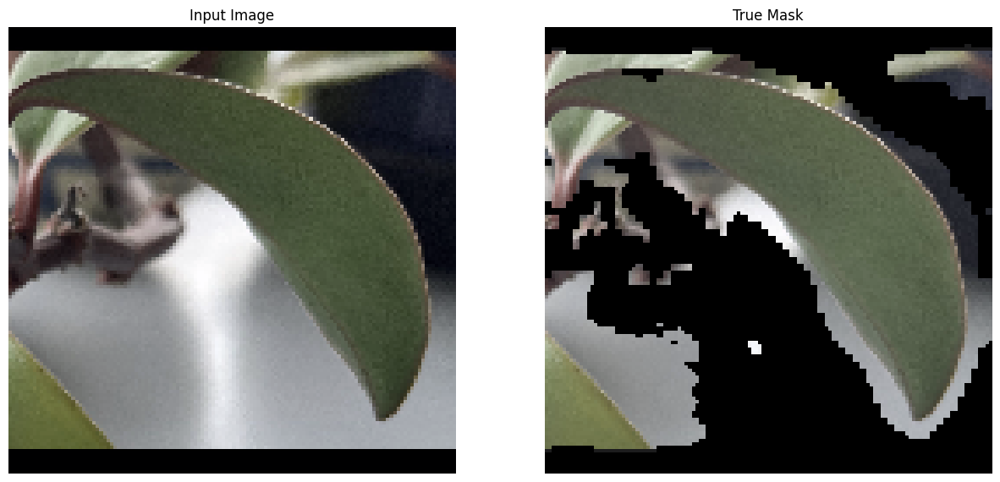

(128, 128, 3)
tf.Tensor(
[[[-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  ...
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]]

 [[-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  ...
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]]

 [[-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  ...
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]]

 ...

 [[-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  ...
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.10482889 -0.10482889]
  [-0.10482889 -0.1

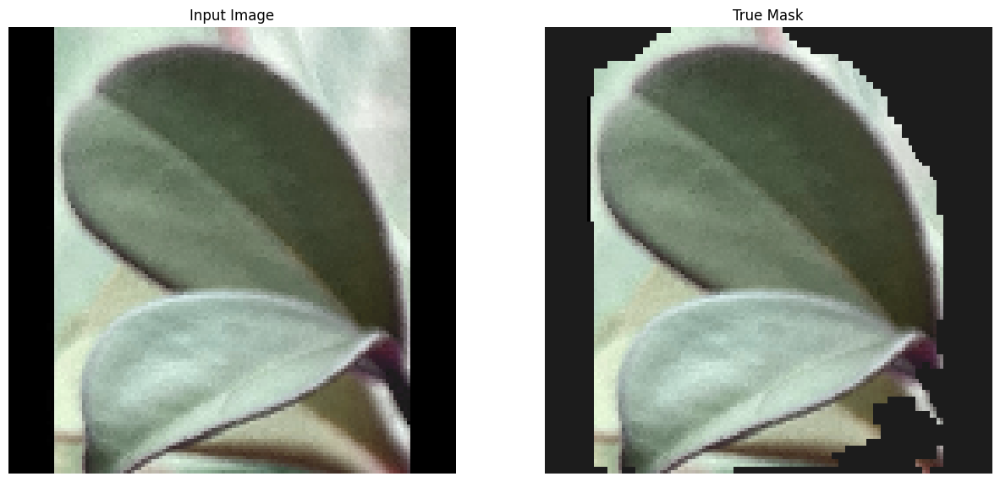

(128, 128, 3)
tf.Tensor(
[[[-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  ...
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]]

 [[-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  ...
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]]

 [[-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  ...
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]]

 ...

 [[-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  ...
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.06597281 -0.06597281]
  [-0.06597281 -0.0

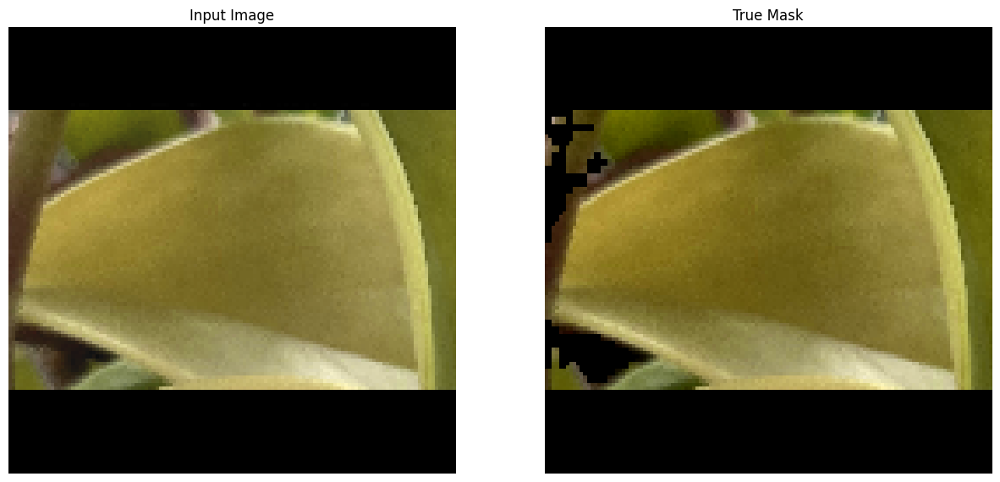

(128, 128, 3)
tf.Tensor(
[[[0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  ...
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]]

 [[0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  ...
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]]

 [[0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  ...
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]]

 ...

 [[0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  ...
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]
  [0.0792594  0.08694944 0.07923964]]

 [[0.0792594  0.08694944 0.07923964]
  [0.0792594

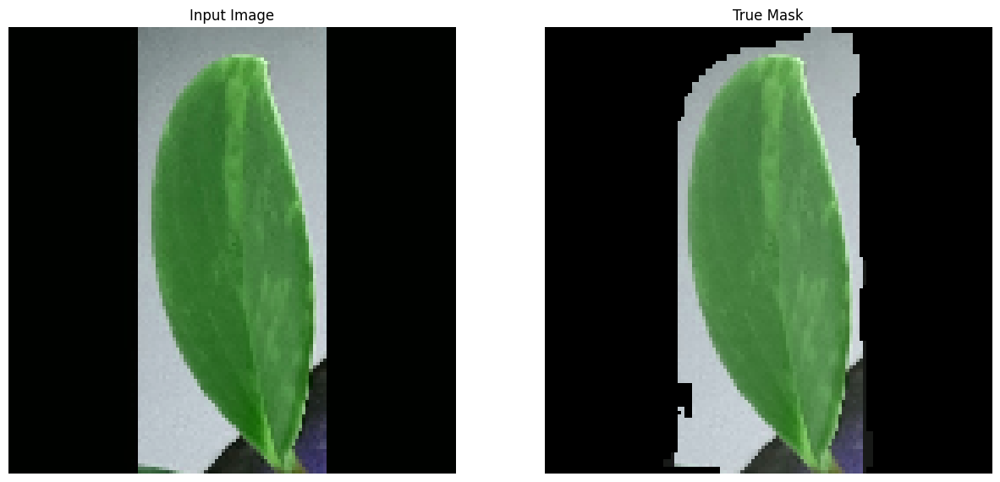

(128, 128, 3)
tf.Tensor(
[[[0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  ...
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]]

 [[0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  ...
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]]

 [[0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  ...
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]]

 ...

 [[0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  ...
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]
  [0.22709912 0.22941864 0.21196331]]

 [[0.22709912 0.22941864 0.21196331]
  [0.2270991

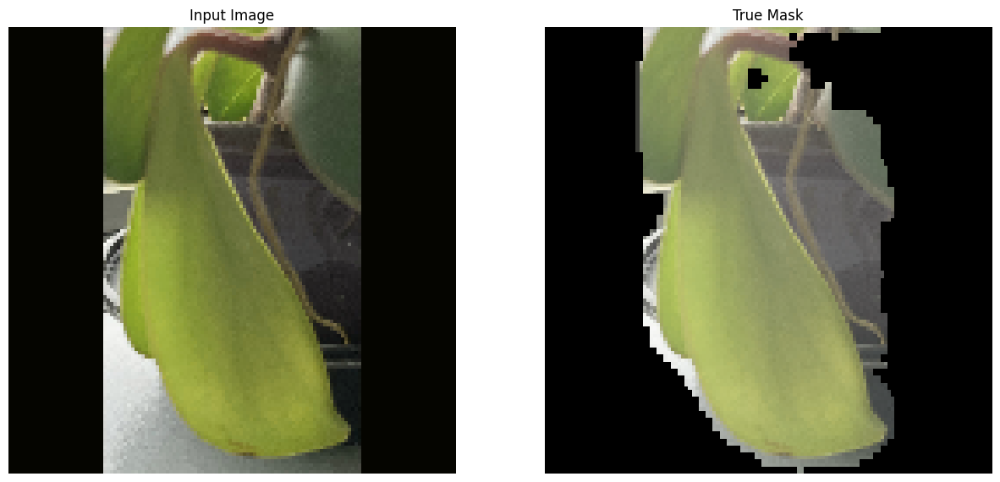

In [39]:
# finetune_model.save("finetune_with_background.keras")
model = finetune_model
extra_finetune = tf.keras.models.load_model('extra_finetune.keras')
finetune_with_background = tf.keras.models.load_model('finetune_with_background.keras')

# print(model.evaluate(office_batches.take(100)))
# finetune_model.save("Segments_too_much.keras")
# print(model.evaluate(finetune_train_batches.take(100)))
# model = not_finetuned_model
# print(model.evaluate(aug_train_batches.take(100)))
# show_background_removed_predictions(model, finetune_train_batches, 30)
# show_background_removed_predictions(model, test_batches, 30)
# model.evaluate(random_batches.take(20))
# show_background_removed_predictions(model, random_batches.take(50), 20)
# show_background_removed_predictions(model, tomato_background_batches, 30)
# compare_model_background_removed([model, extra_finetune, finetune_with_background], office_batches, 60)


compare_model_background_removed([model], office_bbox_val_batches, 60)

# show_background_removed_predictions_batches(model, office_batches, 50)
# show_background_removed_predictions(model, just_background_batches.take(20), 20)


# notes_ for solid colors does poorly with green yellow
# add pure color images to dataset with black masks 
# do howards transfer learning 
# 

In [32]:
# print("Testing")
# best_model = tf.keras.models.load_model('new_segment_95.keras')
# # model = not_finetuned_model
# print("loaded Model")
# model = finetune_model

# print("Evaluating the model")
# model.evaluate(train_batches.take(100))
# model.evaluate(test_batches.take(100))
# model.evaluate(aug_train_batches.take(100))
# print(model.evaluate(finetune_train_batches.take(100)))

# model.evaluate(real_background_batches)

In [26]:
#single leaf detection 

In [27]:
#test out what the mask looks like 